In [1]:
#Import Packages to be used in script
import pandas as pd
import geopandas as gpd
import requests
import hvplot.pandas
import folium
import holoviews as hv
import matplotlib.pyplot as plt
hv.extension('bokeh', logo = False)
from bokeh.models.formatters import NumeralTickFormatter

In [2]:
#API Key from census.gov
#Rishabh Singh's user key: 
#(Put your own key if anyone else is using this script)
usr_key = '&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [3]:
pd.set_option("display.max_rows", 10)

In [4]:
Year = '2022' #Set which year you need the data for

### Heat Sensitivity Variables: (Check mastersheet for explanations)
#### (Multiply by 100 for percents)
1. % pop Below 150% Pov Line: B06012_002E + B06012_003E/B01003_001E
2. % Severely Burdened Renter units: (B25106_028E + B25106_032E + B25106_036E + B25106_040E + B25106_044E)/B25106_001E
3. % HU with Housing Cost Burden: (B25106_006E + B25106_010E + B25106_014E + B25106_018E + B25106_022E)/B25106_001E
4. % Housing Units with No Vehicle: DP04_0058E/DP04_0057E
5. % pop with no health insurance: DP03_0099E/DP05_0001E
6. % pop with a disability: (B18101_004E + B18101_007E + B18101_010E + B18101_013E + B18101_016E + B18101_019E + B18101_023E + B18101_026E + B18101_029E + B18101_032E + B18101_035E + B18101_038E) /B01003_001E
7. % pop aged 65 years and over: DP05_0024E/DP05_0001E
8. % pop aged under 5 years: DP05_0005E/DP05_0001E
9. % pop that speaks english less than "very well": B06007_005E + B06007_008E/B01003_001E
10. % Housing units with more than 1 person per room out of total occupied housing units: (DP04_0078E + DP04_0079E)/DP04_0076E
11. Communities of color: All underserved population: (B01001H_001E + B01001B_001E + B01001C_001E + B01001D_001E + B01001E_001E + B01001I_001E)/B01003_001E
12. Pregnant Women: Using Proxy variable - % Women who had a birth in the past 12 months: B13002_002E/B01003_001E
13. Other Health Variables - adults with hypertension, adults with COPD, adults with asthma, adults with diabetes, adults reported as obese, Mental health Issues; In PLACES Data. - Crude Prevalance rate.
14. Homeless Population - PIT Data - Obtained by rating the point data 1 to 5 with 5 having most homeless people.
15. Energy Burden


-> Variable for Total Population: 

        - For Detailed Tables: B01003_001E
        - For Data Profiles: DP05_0001E
-> Variable for Total Housing Units: 

        - For Detailed Tables: B25106_001E
        - For Data Profiles: DP04_0057E or DP04_0076E


In [5]:
## All variables data checked 
## Need to check all variable definitions before using once from data.census.gov

In [6]:
## Detailed Tables

In [7]:
## Var-1: % pop Below 100% Pov Line: B06012_003E/B06012_001E*100

In [8]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5'
get = '?get='
variables = 'B06012_002E,B06012_003E,B01003_001E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [9]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5?get=B06012_002E,B06012_003E,B01003_001E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [10]:
response_HC_YM_acs2021

<Response [200]>

In [11]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021

,B06012_002E,B06012_003E,B01003_001E,state,county,tract
1,393,168,2722,51,036,600100
2,240,137,2374,51,036,600200
3,203,181,1664,51,036,600300
4,86,102,3851,51,041,100106
5,860,159,2511,51,041,100107
...,...,...,...,...,...,...
292,408,758,3092,51,760,070902
293,572,101,4257,51,760,071002
294,514,131,2556,51,760,071003
295,456,419,1821,51,760,071004


In [12]:
#Getting Ashland Data-

In [13]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [14]:
df_acs2021_a # Ashland Census Tracts

,B06012_002E,B06012_003E,B01003_001E,state,county,tract
90,840,165,5249,51,03368,320601
91,200,61,2952,51,03368,320602


In [15]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb

,B06012_002E,B06012_003E,B01003_001E,state,county,tract
1,393,168,2722,51,036,600100
2,240,137,2374,51,036,600200
3,203,181,1664,51,036,600300
4,86,102,3851,51,041,100106
5,860,159,2511,51,041,100107
...,...,...,...,...,...,...
294,514,131,2556,51,760,071003
295,456,419,1821,51,760,071004
296,1121,256,5380,51,760,071100
90,840,165,5249,51,03368,320601


In [16]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [17]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [18]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [19]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [20]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [21]:
df_acs2021_comb

,B06012_002E,B06012_003E,B01003_001E,state,county,tract
0,200,61,2952,51,03368,320602
1,840,165,5249,51,03368,320601
2,393,168,2722,51,036,600100
3,240,137,2374,51,036,600200
4,203,181,1664,51,036,600300
...,...,...,...,...,...,...
293,668,338,10555,51,095,080402
294,108,120,3919,51,095,080403
295,289,34,4168,51,095,080404
296,200,206,3725,51,095,080208


In [22]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [23]:
df_acs2021_comb.drop(index_names, inplace = True)
df_acs2021_comb

,B06012_002E,B06012_003E,B01003_001E,state,county,tract
0,200,61,2952,51,03368,320602
1,840,165,5249,51,03368,320601
2,393,168,2722,51,036,600100
3,240,137,2374,51,036,600200
4,203,181,1664,51,036,600300
...,...,...,...,...,...,...
293,668,338,10555,51,095,080402
294,108,120,3919,51,095,080403
295,289,34,4168,51,095,080404
296,200,206,3725,51,095,080208


In [24]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [25]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']
df_acs2021

,B06012_002E,B06012_003E,B01003_001E,state,county,tract,GEOID
0,200,61,2952,51,03368,320602,5103368320602
1,840,165,5249,51,03368,320601,5103368320601
2,393,168,2722,51,036,600100,51036600100
3,240,137,2374,51,036,600200,51036600200
4,203,181,1664,51,036,600300,51036600300
...,...,...,...,...,...,...,...
293,668,338,10555,51,095,080402,51095080402
294,108,120,3919,51,095,080403,51095080403
295,289,34,4168,51,095,080404,51095080404
296,200,206,3725,51,095,080208,51095080208


In [26]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})
df_acs2021

,B06012_002E,B06012_003E,B01003_001E,state,county,tract,GEOID
0,200,61,2952,51,03368,320602,51085320602
1,840,165,5249,51,03368,320601,51085320601
2,393,168,2722,51,036,600100,51036600100
3,240,137,2374,51,036,600200,51036600200
4,203,181,1664,51,036,600300,51036600300
...,...,...,...,...,...,...,...
293,668,338,10555,51,095,080402,51095080402
294,108,120,3919,51,095,080403,51095080403
295,289,34,4168,51,095,080404,51095080404
296,200,206,3725,51,095,080208,51095080208


In [27]:
# Rename column headers
df_acs2021['Pop_pov'] = df_acs2021['B06012_002E'].astype(int) + df_acs2021['B06012_003E'].astype(int)
df_acs2021.rename (columns = {'B01003_001E':'Tot_pop'}, inplace = True)
df_acs2021.head()

,B06012_002E,B06012_003E,Tot_pop,state,county,tract,GEOID,Pop_pov
0,200,61,2952,51,03368,320602,51085320602,261
1,840,165,5249,51,03368,320601,51085320601,1005
2,393,168,2722,51,036,600100,51036600100,561
3,240,137,2374,51,036,600200,51036600200,377
4,203,181,1664,51,036,600300,51036600300,384


In [28]:
df_acs2021['Year'] = Year
df_acs2021.head()

,B06012_002E,B06012_003E,Tot_pop,state,county,tract,GEOID,Pop_pov,Year
0,200,61,2952,51,03368,320602,51085320602,261,2022
1,840,165,5249,51,03368,320601,51085320601,1005,2022
2,393,168,2722,51,036,600100,51036600100,561,2022
3,240,137,2374,51,036,600200,51036600200,377,2022
4,203,181,1664,51,036,600300,51036600300,384,2022


In [29]:
df_acs2021['Pop_pov'] = df_acs2021['Pop_pov'].astype(int)
df_acs2021['Tot_pop'] = df_acs2021['Tot_pop'].astype(int)
df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021

,B06012_002E,B06012_003E,Tot_pop,state,county,tract,GEOID,Pop_pov,Year
0,200,61,2952,51,03368,320602,51085320602,261,2022
1,840,165,5249,51,03368,320601,51085320601,1005,2022
2,393,168,2722,51,036,600100,51036600100,561,2022
3,240,137,2374,51,036,600200,51036600200,377,2022
4,203,181,1664,51,036,600300,51036600300,384,2022
...,...,...,...,...,...,...,...,...,...
293,668,338,10555,51,095,080402,51095080402,1006,2022
294,108,120,3919,51,095,080403,51095080403,228,2022
295,289,34,4168,51,095,080404,51095080404,323,2022
296,200,206,3725,51,095,080208,51095080208,406,2022


In [30]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [31]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [32]:
df_acs2021.columns

Index(['B06012_002E', 'B06012_003E', 'Tot_pop', 'state', 'county', 'tract',
       'GEOID', 'Pop_pov', 'Year', 'locality'],
      dtype='object')

In [33]:
df_acs2021

,B06012_002E,B06012_003E,Tot_pop,state,county,tract,GEOID,Pop_pov,Year,locality
0,200,61,2952,51,03368,320602,51085320602,261,2022,Ashland
1,840,165,5249,51,03368,320601,51085320601,1005,2022,Ashland
2,393,168,2722,51,036,600100,51036600100,561,2022,Charles City
3,240,137,2374,51,036,600200,51036600200,377,2022,Charles City
4,203,181,1664,51,036,600300,51036600300,384,2022,Charles City
...,...,...,...,...,...,...,...,...,...,...
293,668,338,10555,51,095,080402,51095080402,1006,2022,James City
294,108,120,3919,51,095,080403,51095080403,228,2022,James City
295,289,34,4168,51,095,080404,51095080404,323,2022,James City
296,200,206,3725,51,095,080208,51095080208,406,2022,James City


In [34]:
df_acs2021['Perc_pov'] = (df_acs2021['Pop_pov']/df_acs2021['Tot_pop'])*100

In [35]:
df_acs2021

,B06012_002E,B06012_003E,Tot_pop,state,county,tract,GEOID,Pop_pov,Year,locality,Perc_pov
0,200,61,2952,51,03368,320602,51085320602,261,2022,Ashland,8.841463
1,840,165,5249,51,03368,320601,51085320601,1005,2022,Ashland,19.146504
2,393,168,2722,51,036,600100,51036600100,561,2022,Charles City,20.609846
3,240,137,2374,51,036,600200,51036600200,377,2022,Charles City,15.880371
4,203,181,1664,51,036,600300,51036600300,384,2022,Charles City,23.076923
...,...,...,...,...,...,...,...,...,...,...,...
293,668,338,10555,51,095,080402,51095080402,1006,2022,James City,9.531028
294,108,120,3919,51,095,080403,51095080403,228,2022,James City,5.817811
295,289,34,4168,51,095,080404,51095080404,323,2022,James City,7.749520
296,200,206,3725,51,095,080208,51095080208,406,2022,James City,10.899329


In [36]:
## Store vaariable data in new variable 

df_acs2021_var1 = df_acs2021

In [37]:
## Visualize on a map



In [38]:
gdf_US_county = gpd.read_file(r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\DataHub-Rishabh\Default Shapefiles\us_county\tl_rd22_us_county.shp")

In [39]:
gdf_US_county.head()

,STATEFP,COUNTYFP,COUNTYNS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,MTFCC,CSAFP,CBSAFP,METDIVFP,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,31,039,00835841,31039,Cuming,Cuming County,06,H1,G4020,NaN,NaN,NaN,A,1477645345,10690204,+41.9158651,-096.7885168,"POLYGON ((-97.01952 42.00410, -97.01952 42.004..."
1,53,069,01513275,53069,Wahkiakum,Wahkiakum County,06,H1,G4020,NaN,NaN,NaN,A,680976231,61568965,+46.2946377,-123.4244583,"POLYGON ((-123.43639 46.23820, -123.44759 46.2..."
2,35,011,00933054,35011,De Baca,De Baca County,06,H1,G4020,NaN,NaN,NaN,A,6016818946,29090018,+34.3592729,-104.3686961,"POLYGON ((-104.56739 33.99757, -104.56772 33.9..."
3,31,109,00835876,31109,Lancaster,Lancaster County,06,H1,G4020,339,30700,NaN,A,2169272970,22847034,+40.7835474,-096.6886584,"POLYGON ((-96.91075 40.78494, -96.91075 40.790..."
4,31,129,00835886,31129,Nuckolls,Nuckolls County,06,H1,G4020,NaN,NaN,NaN,A,1489645188,1718484,+40.1764918,-098.0468422,"POLYGON ((-98.27367 40.08940, -98.27367 40.089..."


In [40]:
gdf_County_RVA=gdf_US_county[(gdf_US_county['GEOID'] == '51036')|(gdf_US_county['GEOID'] == '51041')|(gdf_US_county['GEOID'] == '51075')|(gdf_US_county['GEOID'] == '51085')|(gdf_US_county['GEOID'] == '51087')|(gdf_US_county['GEOID'] == '51127')|(gdf_US_county['GEOID'] == '51145')|(gdf_US_county['GEOID'] == '51760')|(gdf_US_county['GEOID'] == '51095')]

In [41]:
gdf_US_CT = gpd.read_file(r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\DataHub-Rishabh\Default Shapefiles\us_censustracts\tl_rd22_51_tract.shp")

In [42]:
gdf_US_CT.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,+37.8856871,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874..."
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607..."
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595..."
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,+37.7231726,-077.5209363,"POLYGON ((-77.61233 37.75986, -77.61216 37.760..."
4,51,810,045000,51810045000,450,Census Tract 450,G5020,S,21420965,29350,+36.8180371,-076.0308570,"POLYGON ((-76.06314 36.80147, -76.06114 36.802..."


In [43]:
gdf_perc_pov = pd.merge(gdf_US_CT,df_acs2021_var1, on = 'GEOID', how = 'inner')

In [44]:
gdf_perc_pov.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,B06012_002E,B06012_003E,Tot_pop,state,county,tract,Pop_pov,Year,locality,Perc_pov
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,115,210,5516,51,085,320100,325,2022,Hanover,5.891951
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,183,295,4585,51,085,321201,478,2022,Hanover,10.425300
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,692,724,4364,51,085,321202,1416,2022,Hanover,32.447296
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,...,361,502,5455,51,085,320400,863,2022,Hanover,15.820348
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,...,826,405,3238,51,087,201002,1231,2022,Henrico,38.017295


In [45]:
import os

# Define the directory where you want to save the maps
save_dir = r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\Plots"


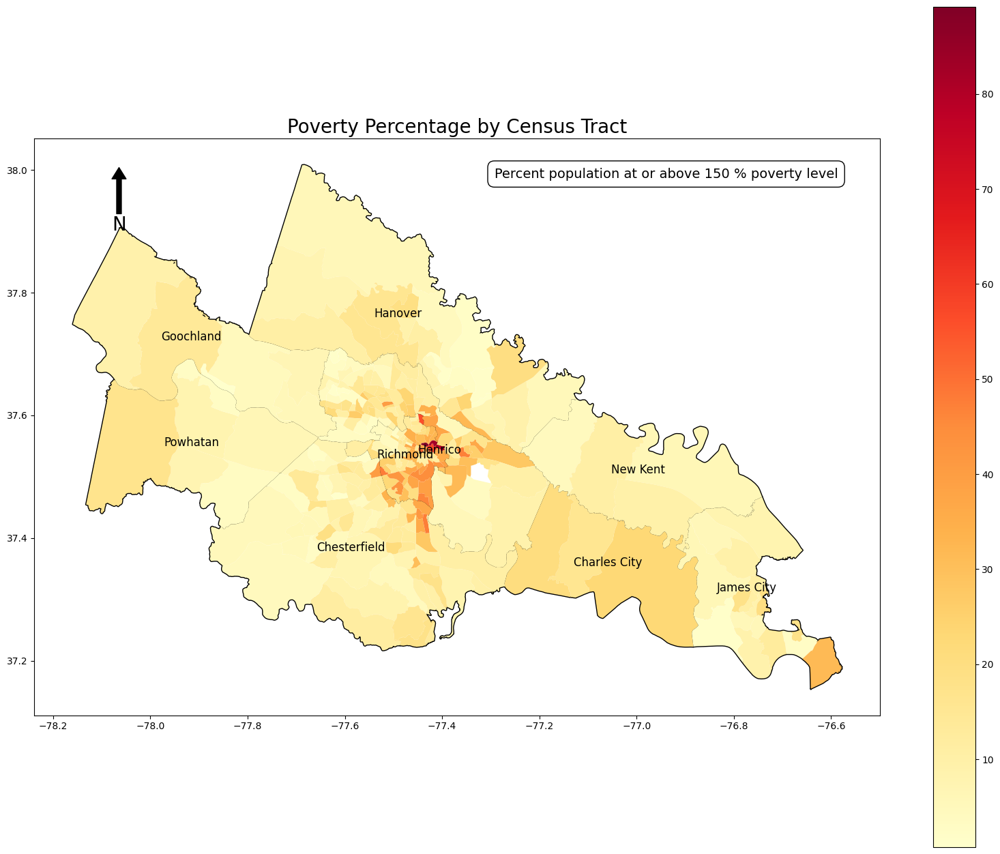

In [46]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_County_RVA.plot(color='White',edgecolor='k',linewidth = 2,ax=ax) ## Locality boundaries
gdf_perc_pov.plot(column='Perc_pov',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Add Title and Labels
ax.set_title('Poverty Percentage by Census Tract', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)
# Add text box
textstr = "Percent population at or above 150 % poverty level"
props = dict(boxstyle='round,pad=0.5', facecolor='white', edgecolor='black')
ax.text(0.95, 0.95, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', horizontalalignment='right', bbox=props)

# Save the map
map_name = 'Perc_pov.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()


In [47]:
df_acs2021_var1

,B06012_002E,B06012_003E,Tot_pop,state,county,tract,GEOID,Pop_pov,Year,locality,Perc_pov
0,200,61,2952,51,03368,320602,51085320602,261,2022,Ashland,8.841463
1,840,165,5249,51,03368,320601,51085320601,1005,2022,Ashland,19.146504
2,393,168,2722,51,036,600100,51036600100,561,2022,Charles City,20.609846
3,240,137,2374,51,036,600200,51036600200,377,2022,Charles City,15.880371
4,203,181,1664,51,036,600300,51036600300,384,2022,Charles City,23.076923
...,...,...,...,...,...,...,...,...,...,...,...
293,668,338,10555,51,095,080402,51095080402,1006,2022,James City,9.531028
294,108,120,3919,51,095,080403,51095080403,228,2022,James City,5.817811
295,289,34,4168,51,095,080404,51095080404,323,2022,James City,7.749520
296,200,206,3725,51,095,080208,51095080208,406,2022,James City,10.899329


In [48]:
## Var-2: % Severely Burdened Renter units: (B25106_028E + B25106_032E + B25106_036E + B25106_040E + B25106_044E)/B25106_001E

In [49]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5'
get = '?get='
variables = 'B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [50]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5?get=B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [51]:
response_HC_YM_acs2021

<Response [200]>

In [52]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021

,B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract
1,50,4,7,8,0,1147,51,036,600100
2,6,24,0,2,0,990,51,036,600200
3,44,6,0,8,0,768,51,036,600300
4,0,0,0,0,0,1421,51,041,100106
5,146,196,116,62,0,1087,51,041,100107
...,...,...,...,...,...,...,...,...,...
292,103,216,143,0,0,1116,51,760,070902
293,178,159,58,16,0,1519,51,760,071002
294,122,167,332,0,0,1491,51,760,071003
295,112,122,36,70,0,829,51,760,071004


In [53]:
#Getting Ashland Data-

In [54]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [55]:
df_acs2021_a # Ashland Census Tracts

,B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract
90,145,186,29,39,0,1433,51,03368,320601
91,24,13,16,12,45,1445,51,03368,320602


In [56]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb

,B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract
1,50,4,7,8,0,1147,51,036,600100
2,6,24,0,2,0,990,51,036,600200
3,44,6,0,8,0,768,51,036,600300
4,0,0,0,0,0,1421,51,041,100106
5,146,196,116,62,0,1087,51,041,100107
...,...,...,...,...,...,...,...,...,...
294,122,167,332,0,0,1491,51,760,071003
295,112,122,36,70,0,829,51,760,071004
296,331,409,164,92,0,2959,51,760,071100
90,145,186,29,39,0,1433,51,03368,320601


In [57]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [58]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [59]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [60]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [61]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [62]:
df_acs2021_comb

,B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract
0,24,13,16,12,45,1445,51,03368,320602
1,145,186,29,39,0,1433,51,03368,320601
2,50,4,7,8,0,1147,51,036,600100
3,6,24,0,2,0,990,51,036,600200
4,44,6,0,8,0,768,51,036,600300
...,...,...,...,...,...,...,...,...,...
293,73,63,63,0,0,3818,51,095,080402
294,19,0,0,0,0,1552,51,095,080403
295,7,0,0,0,26,1458,51,095,080404
296,23,0,24,0,0,1448,51,095,080208


In [63]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [64]:
df_acs2021_comb.drop(index_names, inplace = True)
df_acs2021_comb

,B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract
0,24,13,16,12,45,1445,51,03368,320602
1,145,186,29,39,0,1433,51,03368,320601
2,50,4,7,8,0,1147,51,036,600100
3,6,24,0,2,0,990,51,036,600200
4,44,6,0,8,0,768,51,036,600300
...,...,...,...,...,...,...,...,...,...
293,73,63,63,0,0,3818,51,095,080402
294,19,0,0,0,0,1552,51,095,080403
295,7,0,0,0,26,1458,51,095,080404
296,23,0,24,0,0,1448,51,095,080208


In [65]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [66]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']
df_acs2021

,B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract,GEOID
0,24,13,16,12,45,1445,51,03368,320602,5103368320602
1,145,186,29,39,0,1433,51,03368,320601,5103368320601
2,50,4,7,8,0,1147,51,036,600100,51036600100
3,6,24,0,2,0,990,51,036,600200,51036600200
4,44,6,0,8,0,768,51,036,600300,51036600300
...,...,...,...,...,...,...,...,...,...,...
293,73,63,63,0,0,3818,51,095,080402,51095080402
294,19,0,0,0,0,1552,51,095,080403,51095080403
295,7,0,0,0,26,1458,51,095,080404,51095080404
296,23,0,24,0,0,1448,51,095,080208,51095080208


In [67]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})
df_acs2021

,B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract,GEOID
0,24,13,16,12,45,1445,51,03368,320602,51085320602
1,145,186,29,39,0,1433,51,03368,320601,51085320601
2,50,4,7,8,0,1147,51,036,600100,51036600100
3,6,24,0,2,0,990,51,036,600200,51036600200
4,44,6,0,8,0,768,51,036,600300,51036600300
...,...,...,...,...,...,...,...,...,...,...
293,73,63,63,0,0,3818,51,095,080402,51095080402
294,19,0,0,0,0,1552,51,095,080403,51095080403
295,7,0,0,0,26,1458,51,095,080404,51095080404
296,23,0,24,0,0,1448,51,095,080208,51095080208


In [68]:
df_acs2021['Year'] = Year
df_acs2021.head()

,B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract,GEOID,Year
0,24,13,16,12,45,1445,51,03368,320602,51085320602,2022
1,145,186,29,39,0,1433,51,03368,320601,51085320601,2022
2,50,4,7,8,0,1147,51,036,600100,51036600100,2022
3,6,24,0,2,0,990,51,036,600200,51036600200,2022
4,44,6,0,8,0,768,51,036,600300,51036600300,2022


In [69]:
df_acs2021['B25106_028E'] = df_acs2021['B25106_028E'].astype(int)
df_acs2021['B25106_032E'] = df_acs2021['B25106_032E'].astype(int)
df_acs2021['B25106_036E'] = df_acs2021['B25106_036E'].astype(int)
df_acs2021['B25106_040E'] = df_acs2021['B25106_040E'].astype(int)
df_acs2021['B25106_044E'] = df_acs2021['B25106_044E'].astype(int)
df_acs2021['B25106_001E'] = df_acs2021['B25106_001E'].astype(int)
df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021

,B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract,GEOID,Year
0,24,13,16,12,45,1445,51,03368,320602,51085320602,2022
1,145,186,29,39,0,1433,51,03368,320601,51085320601,2022
2,50,4,7,8,0,1147,51,036,600100,51036600100,2022
3,6,24,0,2,0,990,51,036,600200,51036600200,2022
4,44,6,0,8,0,768,51,036,600300,51036600300,2022
...,...,...,...,...,...,...,...,...,...,...,...
293,73,63,63,0,0,3818,51,095,080402,51095080402,2022
294,19,0,0,0,0,1552,51,095,080403,51095080403,2022
295,7,0,0,0,26,1458,51,095,080404,51095080404,2022
296,23,0,24,0,0,1448,51,095,080208,51095080208,2022


In [70]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [71]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [72]:
df_acs2021.columns

Index(['B25106_028E', 'B25106_032E', 'B25106_036E', 'B25106_040E',
       'B25106_044E', 'B25106_001E', 'state', 'county', 'tract', 'GEOID',
       'Year', 'locality'],
      dtype='object')

In [73]:
df_acs2021

,B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract,GEOID,Year,locality
0,24,13,16,12,45,1445,51,03368,320602,51085320602,2022,Ashland
1,145,186,29,39,0,1433,51,03368,320601,51085320601,2022,Ashland
2,50,4,7,8,0,1147,51,036,600100,51036600100,2022,Charles City
3,6,24,0,2,0,990,51,036,600200,51036600200,2022,Charles City
4,44,6,0,8,0,768,51,036,600300,51036600300,2022,Charles City
...,...,...,...,...,...,...,...,...,...,...,...,...
293,73,63,63,0,0,3818,51,095,080402,51095080402,2022,James City
294,19,0,0,0,0,1552,51,095,080403,51095080403,2022,James City
295,7,0,0,0,26,1458,51,095,080404,51095080404,2022,James City
296,23,0,24,0,0,1448,51,095,080208,51095080208,2022,James City


In [74]:
df_acs2021['Perc_BurdRU'] = ((df_acs2021['B25106_028E']+df_acs2021['B25106_032E']+df_acs2021['B25106_036E']+df_acs2021['B25106_040E']+df_acs2021['B25106_044E'])/df_acs2021['B25106_001E'])*100

In [75]:
df_acs2021

,B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract,GEOID,Year,locality,Perc_BurdRU
0,24,13,16,12,45,1445,51,03368,320602,51085320602,2022,Ashland,7.612457
1,145,186,29,39,0,1433,51,03368,320601,51085320601,2022,Ashland,27.843685
2,50,4,7,8,0,1147,51,036,600100,51036600100,2022,Charles City,6.015693
3,6,24,0,2,0,990,51,036,600200,51036600200,2022,Charles City,3.232323
4,44,6,0,8,0,768,51,036,600300,51036600300,2022,Charles City,7.552083
...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,73,63,63,0,0,3818,51,095,080402,51095080402,2022,James City,5.212153
294,19,0,0,0,0,1552,51,095,080403,51095080403,2022,James City,1.224227
295,7,0,0,0,26,1458,51,095,080404,51095080404,2022,James City,2.263374
296,23,0,24,0,0,1448,51,095,080208,51095080208,2022,James City,3.245856


In [76]:
## Store vaariable data in new variable 

df_acs2021_var2 = df_acs2021

In [77]:
## Visualize on a map



In [78]:
gdf_BurdRU = pd.merge(gdf_US_CT,df_acs2021_var2, on = 'GEOID', how = 'inner')

In [79]:
gdf_BurdRU.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract,Year,locality,Perc_BurdRU
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,61,0,0,2215,51,085,320100,2022,Hanover,2.753950
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,73,0,0,1887,51,085,321201,2022,Hanover,8.373079
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,89,112,0,1778,51,085,321202,2022,Hanover,37.851519
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,...,15,21,0,2163,51,085,320400,2022,Hanover,7.628294
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,...,44,75,0,1248,51,087,201002,2022,Henrico,27.724359


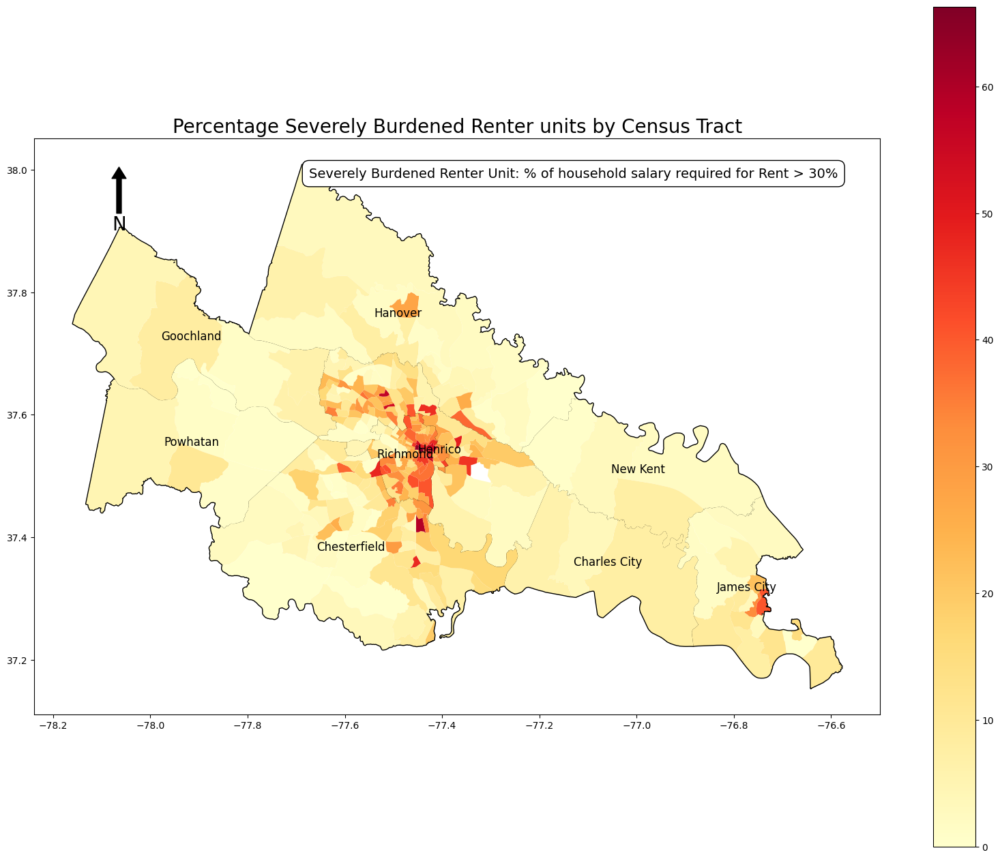

In [80]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_County_RVA.plot(color='White',edgecolor='k',linewidth = 2,ax=ax) ## Locality boundaries
gdf_BurdRU.plot(column='Perc_BurdRU',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Add Title and Labels
ax.set_title('Percentage Severely Burdened Renter units by Census Tract', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)
# Add text box
textstr = "Severely Burdened Renter Unit: % of household salary required for Rent > 30%"
props = dict(boxstyle='round,pad=0.5', facecolor='white', edgecolor='black')
ax.text(0.95, 0.95, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', horizontalalignment='right', bbox=props)

# Save the map
map_name = 'Perc_BurdRU.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [81]:
df_acs2021_var2

,B25106_028E,B25106_032E,B25106_036E,B25106_040E,B25106_044E,B25106_001E,state,county,tract,GEOID,Year,locality,Perc_BurdRU
0,24,13,16,12,45,1445,51,03368,320602,51085320602,2022,Ashland,7.612457
1,145,186,29,39,0,1433,51,03368,320601,51085320601,2022,Ashland,27.843685
2,50,4,7,8,0,1147,51,036,600100,51036600100,2022,Charles City,6.015693
3,6,24,0,2,0,990,51,036,600200,51036600200,2022,Charles City,3.232323
4,44,6,0,8,0,768,51,036,600300,51036600300,2022,Charles City,7.552083
...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,73,63,63,0,0,3818,51,095,080402,51095080402,2022,James City,5.212153
294,19,0,0,0,0,1552,51,095,080403,51095080403,2022,James City,1.224227
295,7,0,0,0,26,1458,51,095,080404,51095080404,2022,James City,2.263374
296,23,0,24,0,0,1448,51,095,080208,51095080208,2022,James City,3.245856


In [82]:
## % HU with Housing Cost Burden: (B25106_006E + B25106_010E + B25106_014E + B25106_018E + B25106_022E)/B25106_001E

In [83]:
## Var-3: % HU with Housing Cost Burden: (B25106_006E + B25106_010E + B25106_014E + B25106_018E + B25106_022E)/B25106_001E

In [84]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5'
get = '?get='
variables = 'B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [85]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5?get=B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [86]:
response_HC_YM_acs2021

<Response [200]>

In [87]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021

,B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract
1,107,43,18,28,11,1147,51,036,600100
2,65,20,36,23,1,990,51,036,600200
3,47,13,45,3,0,768,51,036,600300
4,14,51,30,76,16,1421,51,041,100106
5,32,55,9,6,0,1087,51,041,100107
...,...,...,...,...,...,...,...,...,...
292,10,0,0,0,56,1116,51,760,070902
293,62,14,36,38,12,1519,51,760,071002
294,45,23,45,7,0,1491,51,760,071003
295,0,0,0,0,0,829,51,760,071004


In [88]:
#Getting Ashland Data-

In [89]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [90]:
df_acs2021_a # Ashland Census Tracts

,B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract
90,45,5,0,27,6,1433,51,03368,320601
91,37,114,17,26,0,1445,51,03368,320602


In [91]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb

,B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract
1,107,43,18,28,11,1147,51,036,600100
2,65,20,36,23,1,990,51,036,600200
3,47,13,45,3,0,768,51,036,600300
4,14,51,30,76,16,1421,51,041,100106
5,32,55,9,6,0,1087,51,041,100107
...,...,...,...,...,...,...,...,...,...
294,45,23,45,7,0,1491,51,760,071003
295,0,0,0,0,0,829,51,760,071004
296,24,51,38,31,57,2959,51,760,071100
90,45,5,0,27,6,1433,51,03368,320601


In [92]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [93]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [94]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [95]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [96]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [97]:
df_acs2021_comb

,B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract
0,37,114,17,26,0,1445,51,03368,320602
1,45,5,0,27,6,1433,51,03368,320601
2,107,43,18,28,11,1147,51,036,600100
3,65,20,36,23,1,990,51,036,600200
4,47,13,45,3,0,768,51,036,600300
...,...,...,...,...,...,...,...,...,...
293,90,94,107,202,150,3818,51,095,080402
294,21,50,13,89,43,1552,51,095,080403
295,63,0,85,0,183,1458,51,095,080404
296,30,103,46,48,118,1448,51,095,080208


In [98]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [99]:
df_acs2021_comb.drop(index_names, inplace = True)
df_acs2021_comb

,B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract
0,37,114,17,26,0,1445,51,03368,320602
1,45,5,0,27,6,1433,51,03368,320601
2,107,43,18,28,11,1147,51,036,600100
3,65,20,36,23,1,990,51,036,600200
4,47,13,45,3,0,768,51,036,600300
...,...,...,...,...,...,...,...,...,...
293,90,94,107,202,150,3818,51,095,080402
294,21,50,13,89,43,1552,51,095,080403
295,63,0,85,0,183,1458,51,095,080404
296,30,103,46,48,118,1448,51,095,080208


In [100]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [101]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']
df_acs2021

,B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract,GEOID
0,37,114,17,26,0,1445,51,03368,320602,5103368320602
1,45,5,0,27,6,1433,51,03368,320601,5103368320601
2,107,43,18,28,11,1147,51,036,600100,51036600100
3,65,20,36,23,1,990,51,036,600200,51036600200
4,47,13,45,3,0,768,51,036,600300,51036600300
...,...,...,...,...,...,...,...,...,...,...
293,90,94,107,202,150,3818,51,095,080402,51095080402
294,21,50,13,89,43,1552,51,095,080403,51095080403
295,63,0,85,0,183,1458,51,095,080404,51095080404
296,30,103,46,48,118,1448,51,095,080208,51095080208


In [102]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})
df_acs2021

,B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract,GEOID
0,37,114,17,26,0,1445,51,03368,320602,51085320602
1,45,5,0,27,6,1433,51,03368,320601,51085320601
2,107,43,18,28,11,1147,51,036,600100,51036600100
3,65,20,36,23,1,990,51,036,600200,51036600200
4,47,13,45,3,0,768,51,036,600300,51036600300
...,...,...,...,...,...,...,...,...,...,...
293,90,94,107,202,150,3818,51,095,080402,51095080402
294,21,50,13,89,43,1552,51,095,080403,51095080403
295,63,0,85,0,183,1458,51,095,080404,51095080404
296,30,103,46,48,118,1448,51,095,080208,51095080208


In [103]:
df_acs2021['Year'] = Year
df_acs2021.head()

,B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract,GEOID,Year
0,37,114,17,26,0,1445,51,03368,320602,51085320602,2022
1,45,5,0,27,6,1433,51,03368,320601,51085320601,2022
2,107,43,18,28,11,1147,51,036,600100,51036600100,2022
3,65,20,36,23,1,990,51,036,600200,51036600200,2022
4,47,13,45,3,0,768,51,036,600300,51036600300,2022


In [104]:
df_acs2021['B25106_006E'] = df_acs2021['B25106_006E'].astype(int)
df_acs2021['B25106_010E'] = df_acs2021['B25106_010E'].astype(int)
df_acs2021['B25106_014E'] = df_acs2021['B25106_014E'].astype(int)
df_acs2021['B25106_018E'] = df_acs2021['B25106_018E'].astype(int)
df_acs2021['B25106_022E'] = df_acs2021['B25106_022E'].astype(int)
df_acs2021['B25106_001E'] = df_acs2021['B25106_001E'].astype(int)
df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021

,B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract,GEOID,Year
0,37,114,17,26,0,1445,51,03368,320602,51085320602,2022
1,45,5,0,27,6,1433,51,03368,320601,51085320601,2022
2,107,43,18,28,11,1147,51,036,600100,51036600100,2022
3,65,20,36,23,1,990,51,036,600200,51036600200,2022
4,47,13,45,3,0,768,51,036,600300,51036600300,2022
...,...,...,...,...,...,...,...,...,...,...,...
293,90,94,107,202,150,3818,51,095,080402,51095080402,2022
294,21,50,13,89,43,1552,51,095,080403,51095080403,2022
295,63,0,85,0,183,1458,51,095,080404,51095080404,2022
296,30,103,46,48,118,1448,51,095,080208,51095080208,2022


In [105]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [106]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [107]:
df_acs2021.columns

Index(['B25106_006E', 'B25106_010E', 'B25106_014E', 'B25106_018E',
       'B25106_022E', 'B25106_001E', 'state', 'county', 'tract', 'GEOID',
       'Year', 'locality'],
      dtype='object')

In [108]:
df_acs2021

,B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract,GEOID,Year,locality
0,37,114,17,26,0,1445,51,03368,320602,51085320602,2022,Ashland
1,45,5,0,27,6,1433,51,03368,320601,51085320601,2022,Ashland
2,107,43,18,28,11,1147,51,036,600100,51036600100,2022,Charles City
3,65,20,36,23,1,990,51,036,600200,51036600200,2022,Charles City
4,47,13,45,3,0,768,51,036,600300,51036600300,2022,Charles City
...,...,...,...,...,...,...,...,...,...,...,...,...
293,90,94,107,202,150,3818,51,095,080402,51095080402,2022,James City
294,21,50,13,89,43,1552,51,095,080403,51095080403,2022,James City
295,63,0,85,0,183,1458,51,095,080404,51095080404,2022,James City
296,30,103,46,48,118,1448,51,095,080208,51095080208,2022,James City


In [109]:
df_acs2021['Perc_BurdHousU'] = ((df_acs2021['B25106_006E']+df_acs2021['B25106_010E']+df_acs2021['B25106_014E']+df_acs2021['B25106_018E']+df_acs2021['B25106_022E'])/df_acs2021['B25106_001E'])*100

In [110]:
df_acs2021.head()

,B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract,GEOID,Year,locality,Perc_BurdHousU
0,37,114,17,26,0,1445,51,03368,320602,51085320602,2022,Ashland,13.425606
1,45,5,0,27,6,1433,51,03368,320601,51085320601,2022,Ashland,5.792045
2,107,43,18,28,11,1147,51,036,600100,51036600100,2022,Charles City,18.047079
3,65,20,36,23,1,990,51,036,600200,51036600200,2022,Charles City,14.646465
4,47,13,45,3,0,768,51,036,600300,51036600300,2022,Charles City,14.062500


In [111]:
## Store vaariable data in new variable 

df_acs2021_var3 = df_acs2021

In [112]:
## Visualize on a map



In [113]:
gdf_BurdHousU = pd.merge(gdf_US_CT,df_acs2021_var3, on = 'GEOID', how = 'inner')

In [114]:
gdf_BurdHousU.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract,Year,locality,Perc_BurdHousU
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,59,109,135,2215,51,085,320100,2022,Hanover,18.148984
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,58,70,45,1887,51,085,321201,2022,Hanover,16.163222
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,0,33,9,1778,51,085,321202,2022,Hanover,6.524184
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,...,48,115,104,2163,51,085,320400,2022,Hanover,15.580213
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,...,50,70,0,1248,51,087,201002,2022,Henrico,19.310897


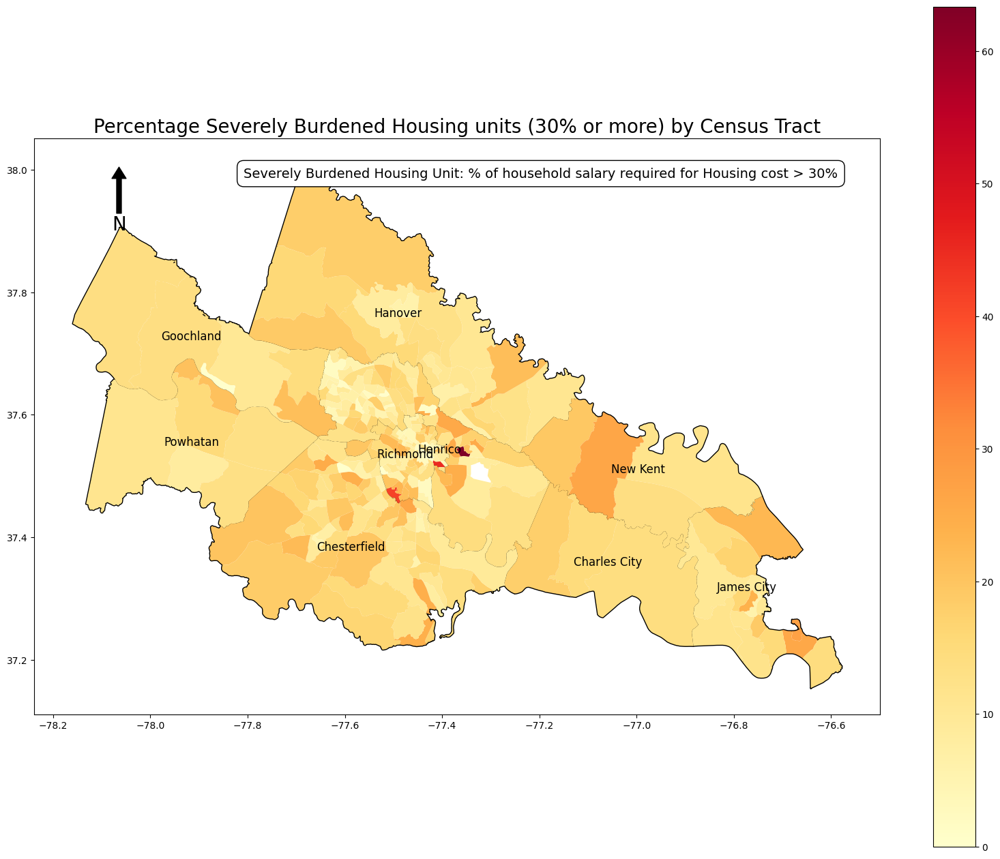

In [115]:
import matplotlib.pyplot as plt
import os

# Assuming gdf_County_RVA and gdf_BurdHousU are already defined

fig, ax = plt.subplots(figsize=(20, 16)) 

# Plot locality boundaries
gdf_County_RVA.plot(color='White', edgecolor='k', linewidth=2, ax=ax)

# Plot values
gdf_BurdHousU.plot(column='Perc_BurdHousU', cmap='YlOrRd', ax=ax, legend=True)

# Add Title and Labels
ax.set_title('Percentage Severely Burdened Housing units (30% or more) by Census Tract', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Add text box
textstr = "Severely Burdened Housing Unit: % of household salary required for Housing cost > 30%"
props = dict(boxstyle='round,pad=0.5', facecolor='white', edgecolor='black')
ax.text(0.95, 0.95, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', horizontalalignment='right', bbox=props)

# Save the map
save_dir = '.'  # Change this to your desired directory
map_name = 'Perc_BurdHousU.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()


In [116]:
df_acs2021_var3

,B25106_006E,B25106_010E,B25106_014E,B25106_018E,B25106_022E,B25106_001E,state,county,tract,GEOID,Year,locality,Perc_BurdHousU
0,37,114,17,26,0,1445,51,03368,320602,51085320602,2022,Ashland,13.425606
1,45,5,0,27,6,1433,51,03368,320601,51085320601,2022,Ashland,5.792045
2,107,43,18,28,11,1147,51,036,600100,51036600100,2022,Charles City,18.047079
3,65,20,36,23,1,990,51,036,600200,51036600200,2022,Charles City,14.646465
4,47,13,45,3,0,768,51,036,600300,51036600300,2022,Charles City,14.062500
...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,90,94,107,202,150,3818,51,095,080402,51095080402,2022,James City,16.841278
294,21,50,13,89,43,1552,51,095,080403,51095080403,2022,James City,13.917526
295,63,0,85,0,183,1458,51,095,080404,51095080404,2022,James City,22.702332
296,30,103,46,48,118,1448,51,095,080208,51095080208,2022,James City,23.825967


In [117]:
## Var 4: % Housing Units with No Vehicle: DP04_0058E/DP04_0057E

In [118]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5/profile'
get = '?get='
variables = 'DP04_0058E,DP04_0057E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [119]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5/profile?get=DP04_0058E,DP04_0057E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [120]:
response_HC_YM_acs2021

<Response [200]>

In [121]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021

,DP04_0058E,DP04_0057E,state,county,tract
1,86,1147,51,036,600100
2,63,990,51,036,600200
3,37,768,51,036,600300
4,8,1421,51,041,100106
5,25,1087,51,041,100107
...,...,...,...,...,...
292,178,1116,51,760,070902
293,136,1519,51,760,071002
294,258,1491,51,760,071003
295,144,829,51,760,071004


In [122]:
#Getting Ashland Data-

In [123]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [124]:
df_acs2021_a # Ashland Census Tracts

,DP04_0058E,DP04_0057E,state,county,tract
90,102,1433,51,03368,320601
91,18,1445,51,03368,320602


In [125]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb

,DP04_0058E,DP04_0057E,state,county,tract
1,86,1147,51,036,600100
2,63,990,51,036,600200
3,37,768,51,036,600300
4,8,1421,51,041,100106
5,25,1087,51,041,100107
...,...,...,...,...,...
294,258,1491,51,760,071003
295,144,829,51,760,071004
296,162,2959,51,760,071100
90,102,1433,51,03368,320601


In [126]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [127]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [128]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [129]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [130]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [131]:
df_acs2021_comb

,DP04_0058E,DP04_0057E,state,county,tract
0,18,1445,51,03368,320602
1,102,1433,51,03368,320601
2,86,1147,51,036,600100
3,63,990,51,036,600200
4,37,768,51,036,600300
...,...,...,...,...,...
293,151,3818,51,095,080402
294,0,1552,51,095,080403
295,18,1458,51,095,080404
296,23,1448,51,095,080208


In [132]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [133]:
df_acs2021_comb.drop(index_names, inplace = True)
df_acs2021_comb

,DP04_0058E,DP04_0057E,state,county,tract
0,18,1445,51,03368,320602
1,102,1433,51,03368,320601
2,86,1147,51,036,600100
3,63,990,51,036,600200
4,37,768,51,036,600300
...,...,...,...,...,...
293,151,3818,51,095,080402
294,0,1552,51,095,080403
295,18,1458,51,095,080404
296,23,1448,51,095,080208


In [134]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [135]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']
df_acs2021

,DP04_0058E,DP04_0057E,state,county,tract,GEOID
0,18,1445,51,03368,320602,5103368320602
1,102,1433,51,03368,320601,5103368320601
2,86,1147,51,036,600100,51036600100
3,63,990,51,036,600200,51036600200
4,37,768,51,036,600300,51036600300
...,...,...,...,...,...,...
293,151,3818,51,095,080402,51095080402
294,0,1552,51,095,080403,51095080403
295,18,1458,51,095,080404,51095080404
296,23,1448,51,095,080208,51095080208


In [136]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})
df_acs2021

,DP04_0058E,DP04_0057E,state,county,tract,GEOID
0,18,1445,51,03368,320602,51085320602
1,102,1433,51,03368,320601,51085320601
2,86,1147,51,036,600100,51036600100
3,63,990,51,036,600200,51036600200
4,37,768,51,036,600300,51036600300
...,...,...,...,...,...,...
293,151,3818,51,095,080402,51095080402
294,0,1552,51,095,080403,51095080403
295,18,1458,51,095,080404,51095080404
296,23,1448,51,095,080208,51095080208


In [137]:
df_acs2021['Year'] = Year
df_acs2021.head()

,DP04_0058E,DP04_0057E,state,county,tract,GEOID,Year
0,18,1445,51,03368,320602,51085320602,2022
1,102,1433,51,03368,320601,51085320601,2022
2,86,1147,51,036,600100,51036600100,2022
3,63,990,51,036,600200,51036600200,2022
4,37,768,51,036,600300,51036600300,2022


In [138]:
df_acs2021['DP04_0058E'] = df_acs2021['DP04_0058E'].astype(int)
df_acs2021['DP04_0057E'] = df_acs2021['DP04_0057E'].astype(int)

df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021

,DP04_0058E,DP04_0057E,state,county,tract,GEOID,Year
0,18,1445,51,03368,320602,51085320602,2022
1,102,1433,51,03368,320601,51085320601,2022
2,86,1147,51,036,600100,51036600100,2022
3,63,990,51,036,600200,51036600200,2022
4,37,768,51,036,600300,51036600300,2022
...,...,...,...,...,...,...,...
293,151,3818,51,095,080402,51095080402,2022
294,0,1552,51,095,080403,51095080403,2022
295,18,1458,51,095,080404,51095080404,2022
296,23,1448,51,095,080208,51095080208,2022


In [139]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [140]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [141]:
df_acs2021.columns

Index(['DP04_0058E', 'DP04_0057E', 'state', 'county', 'tract', 'GEOID', 'Year',
       'locality'],
      dtype='object')

In [142]:
df_acs2021

,DP04_0058E,DP04_0057E,state,county,tract,GEOID,Year,locality
0,18,1445,51,03368,320602,51085320602,2022,Ashland
1,102,1433,51,03368,320601,51085320601,2022,Ashland
2,86,1147,51,036,600100,51036600100,2022,Charles City
3,63,990,51,036,600200,51036600200,2022,Charles City
4,37,768,51,036,600300,51036600300,2022,Charles City
...,...,...,...,...,...,...,...,...
293,151,3818,51,095,080402,51095080402,2022,James City
294,0,1552,51,095,080403,51095080403,2022,James City
295,18,1458,51,095,080404,51095080404,2022,James City
296,23,1448,51,095,080208,51095080208,2022,James City


In [143]:
df_acs2021['Perc_NoVeh'] = (df_acs2021['DP04_0058E']/df_acs2021['DP04_0057E'])*100

In [144]:
df_acs2021.head()

,DP04_0058E,DP04_0057E,state,county,tract,GEOID,Year,locality,Perc_NoVeh
0,18,1445,51,03368,320602,51085320602,2022,Ashland,1.245675
1,102,1433,51,03368,320601,51085320601,2022,Ashland,7.117934
2,86,1147,51,036,600100,51036600100,2022,Charles City,7.497820
3,63,990,51,036,600200,51036600200,2022,Charles City,6.363636
4,37,768,51,036,600300,51036600300,2022,Charles City,4.817708


In [145]:
## Store vaariable data in new variable 

df_acs2021_var4 = df_acs2021

In [146]:
## Visualize on a map



In [147]:
gdf_NoVeh = pd.merge(gdf_US_CT,df_acs2021_var4, on = 'GEOID', how = 'inner')

In [148]:
gdf_NoVeh.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,INTPTLON,geometry,DP04_0058E,DP04_0057E,state,county,tract,Year,locality,Perc_NoVeh
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",17,2215,51,085,320100,2022,Hanover,0.767494
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",40,1887,51,085,321201,2022,Hanover,2.119767
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",138,1778,51,085,321202,2022,Hanover,7.761530
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,...,-077.5209363,"POLYGON ((-77.61233 37.75986, -77.61216 37.760...",91,2163,51,085,320400,2022,Hanover,4.207120
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,...,-077.4043263,"POLYGON ((-77.41507 37.56327, -77.41492 37.563...",81,1248,51,087,201002,2022,Henrico,6.490385


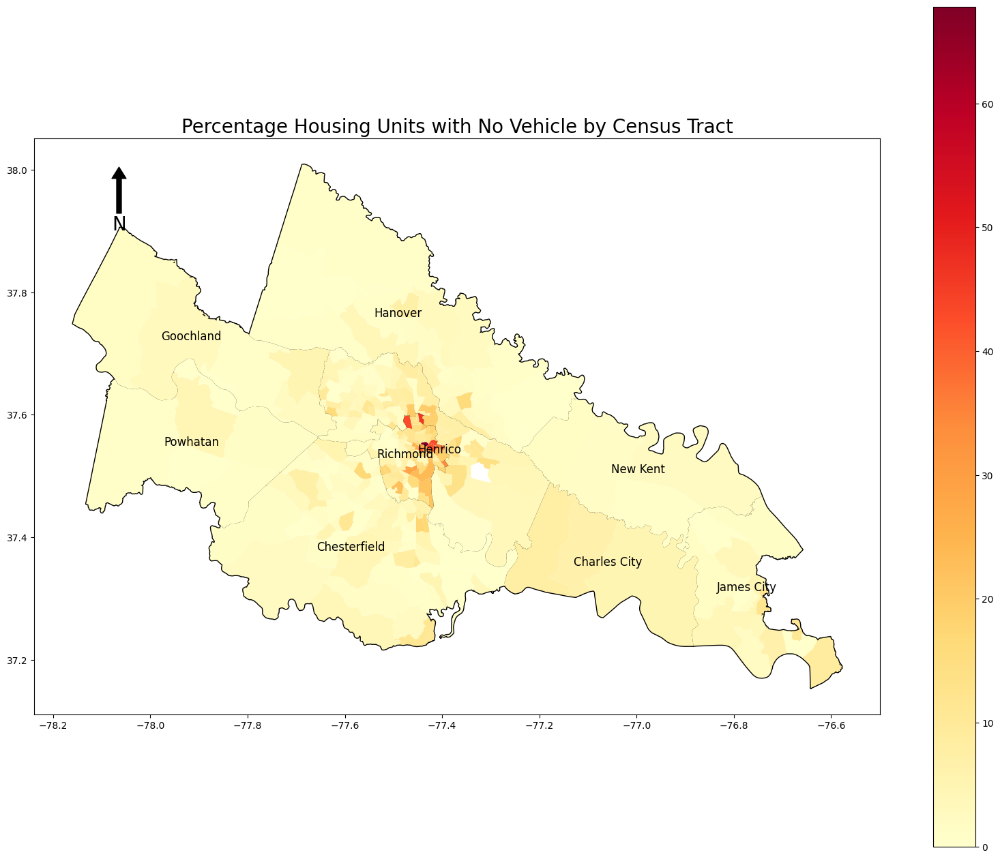

In [149]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_County_RVA.plot(color='White',edgecolor='k',linewidth = 2,ax=ax) ## Locality boundaries
gdf_NoVeh.plot(column='Perc_NoVeh',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Add Title and Labels
ax.set_title('Percentage Housing Units with No Vehicle by Census Tract', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
map_name = 'Perc_NoVeh.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [150]:
df_acs2021_var4

,DP04_0058E,DP04_0057E,state,county,tract,GEOID,Year,locality,Perc_NoVeh
0,18,1445,51,03368,320602,51085320602,2022,Ashland,1.245675
1,102,1433,51,03368,320601,51085320601,2022,Ashland,7.117934
2,86,1147,51,036,600100,51036600100,2022,Charles City,7.497820
3,63,990,51,036,600200,51036600200,2022,Charles City,6.363636
4,37,768,51,036,600300,51036600300,2022,Charles City,4.817708
...,...,...,...,...,...,...,...,...,...
293,151,3818,51,095,080402,51095080402,2022,James City,3.954950
294,0,1552,51,095,080403,51095080403,2022,James City,0.000000
295,18,1458,51,095,080404,51095080404,2022,James City,1.234568
296,23,1448,51,095,080208,51095080208,2022,James City,1.588398


In [151]:
## Var 5: % pop with no health insurance: 'DP03_0099E,DP05_0001E'

In [152]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5/profile'
get = '?get='
variables = 'DP03_0099E,DP05_0001E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [153]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5/profile?get=DP03_0099E,DP05_0001E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [154]:
response_HC_YM_acs2021

<Response [200]>

In [155]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021

,DP03_0099E,DP05_0001E,state,county,tract
1,193,2722,51,036,600100
2,153,2374,51,036,600200
3,81,1664,51,036,600300
4,335,3851,51,041,100106
5,304,2511,51,041,100107
...,...,...,...,...,...
292,149,3092,51,760,070902
293,722,4257,51,760,071002
294,26,2556,51,760,071003
295,74,1821,51,760,071004


In [156]:
#Getting Ashland Data-

In [157]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [158]:
df_acs2021_a # Ashland Census Tracts

,DP03_0099E,DP05_0001E,state,county,tract
90,278,5249,51,03368,320601
91,419,2952,51,03368,320602


In [159]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb

,DP03_0099E,DP05_0001E,state,county,tract
1,193,2722,51,036,600100
2,153,2374,51,036,600200
3,81,1664,51,036,600300
4,335,3851,51,041,100106
5,304,2511,51,041,100107
...,...,...,...,...,...
294,26,2556,51,760,071003
295,74,1821,51,760,071004
296,412,5380,51,760,071100
90,278,5249,51,03368,320601


In [160]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [161]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [162]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [163]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [164]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [165]:
df_acs2021_comb

,DP03_0099E,DP05_0001E,state,county,tract
0,419,2952,51,03368,320602
1,278,5249,51,03368,320601
2,193,2722,51,036,600100
3,153,2374,51,036,600200
4,81,1664,51,036,600300
...,...,...,...,...,...
293,216,10555,51,095,080402
294,144,3919,51,095,080403
295,155,4168,51,095,080404
296,26,3725,51,095,080208


In [166]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [167]:
df_acs2021_comb.drop(index_names, inplace = True)
df_acs2021_comb

,DP03_0099E,DP05_0001E,state,county,tract
0,419,2952,51,03368,320602
1,278,5249,51,03368,320601
2,193,2722,51,036,600100
3,153,2374,51,036,600200
4,81,1664,51,036,600300
...,...,...,...,...,...
293,216,10555,51,095,080402
294,144,3919,51,095,080403
295,155,4168,51,095,080404
296,26,3725,51,095,080208


In [168]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [169]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']
df_acs2021

,DP03_0099E,DP05_0001E,state,county,tract,GEOID
0,419,2952,51,03368,320602,5103368320602
1,278,5249,51,03368,320601,5103368320601
2,193,2722,51,036,600100,51036600100
3,153,2374,51,036,600200,51036600200
4,81,1664,51,036,600300,51036600300
...,...,...,...,...,...,...
293,216,10555,51,095,080402,51095080402
294,144,3919,51,095,080403,51095080403
295,155,4168,51,095,080404,51095080404
296,26,3725,51,095,080208,51095080208


In [170]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})
df_acs2021

,DP03_0099E,DP05_0001E,state,county,tract,GEOID
0,419,2952,51,03368,320602,51085320602
1,278,5249,51,03368,320601,51085320601
2,193,2722,51,036,600100,51036600100
3,153,2374,51,036,600200,51036600200
4,81,1664,51,036,600300,51036600300
...,...,...,...,...,...,...
293,216,10555,51,095,080402,51095080402
294,144,3919,51,095,080403,51095080403
295,155,4168,51,095,080404,51095080404
296,26,3725,51,095,080208,51095080208


In [171]:
df_acs2021['Year'] = Year
df_acs2021.head()

,DP03_0099E,DP05_0001E,state,county,tract,GEOID,Year
0,419,2952,51,03368,320602,51085320602,2022
1,278,5249,51,03368,320601,51085320601,2022
2,193,2722,51,036,600100,51036600100,2022
3,153,2374,51,036,600200,51036600200,2022
4,81,1664,51,036,600300,51036600300,2022


In [172]:
df_acs2021['DP03_0099E'] = df_acs2021['DP03_0099E'].astype(int)
df_acs2021['DP05_0001E'] = df_acs2021['DP05_0001E'].astype(int)

df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021

,DP03_0099E,DP05_0001E,state,county,tract,GEOID,Year
0,419,2952,51,03368,320602,51085320602,2022
1,278,5249,51,03368,320601,51085320601,2022
2,193,2722,51,036,600100,51036600100,2022
3,153,2374,51,036,600200,51036600200,2022
4,81,1664,51,036,600300,51036600300,2022
...,...,...,...,...,...,...,...
293,216,10555,51,095,080402,51095080402,2022
294,144,3919,51,095,080403,51095080403,2022
295,155,4168,51,095,080404,51095080404,2022
296,26,3725,51,095,080208,51095080208,2022


In [173]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [174]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [175]:
df_acs2021.columns

Index(['DP03_0099E', 'DP05_0001E', 'state', 'county', 'tract', 'GEOID', 'Year',
       'locality'],
      dtype='object')

In [176]:
df_acs2021

,DP03_0099E,DP05_0001E,state,county,tract,GEOID,Year,locality
0,419,2952,51,03368,320602,51085320602,2022,Ashland
1,278,5249,51,03368,320601,51085320601,2022,Ashland
2,193,2722,51,036,600100,51036600100,2022,Charles City
3,153,2374,51,036,600200,51036600200,2022,Charles City
4,81,1664,51,036,600300,51036600300,2022,Charles City
...,...,...,...,...,...,...,...,...
293,216,10555,51,095,080402,51095080402,2022,James City
294,144,3919,51,095,080403,51095080403,2022,James City
295,155,4168,51,095,080404,51095080404,2022,James City
296,26,3725,51,095,080208,51095080208,2022,James City


In [177]:
df_acs2021['Perc_NoIns'] = (df_acs2021['DP03_0099E']/df_acs2021['DP05_0001E'])*100

In [178]:
df_acs2021.head()

,DP03_0099E,DP05_0001E,state,county,tract,GEOID,Year,locality,Perc_NoIns
0,419,2952,51,03368,320602,51085320602,2022,Ashland,14.193767
1,278,5249,51,03368,320601,51085320601,2022,Ashland,5.296247
2,193,2722,51,036,600100,51036600100,2022,Charles City,7.090375
3,153,2374,51,036,600200,51036600200,2022,Charles City,6.444819
4,81,1664,51,036,600300,51036600300,2022,Charles City,4.867788


In [179]:
## Store vaariable data in new variable 

df_acs2021_var5 = df_acs2021

In [180]:
## Visualize on a map



In [181]:
gdf_NoIns = pd.merge(gdf_US_CT,df_acs2021_var5, on = 'GEOID', how = 'inner')

In [182]:
gdf_NoIns.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,INTPTLON,geometry,DP03_0099E,DP05_0001E,state,county,tract,Year,locality,Perc_NoIns
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",263,5516,51,085,320100,2022,Hanover,4.767948
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",152,4585,51,085,321201,2022,Hanover,3.315158
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",207,4364,51,085,321202,2022,Hanover,4.743355
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,...,-077.5209363,"POLYGON ((-77.61233 37.75986, -77.61216 37.760...",459,5455,51,085,320400,2022,Hanover,8.414299
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,...,-077.4043263,"POLYGON ((-77.41507 37.56327, -77.41492 37.563...",228,3238,51,087,201002,2022,Henrico,7.041384


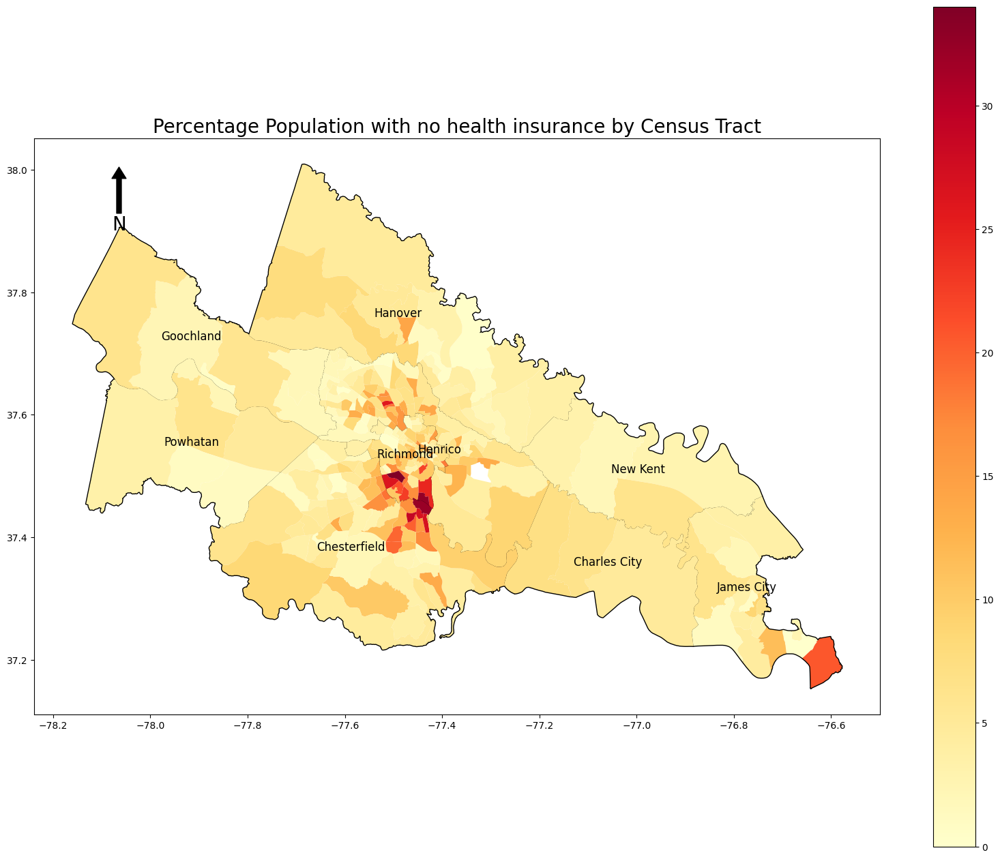

In [183]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_County_RVA.plot(color='White',edgecolor='k',linewidth = 2,ax=ax) ## Locality boundaries
gdf_NoIns.plot(column='Perc_NoIns',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Add Title and Labels
ax.set_title('Percentage Population with no health insurance by Census Tract', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
map_name = 'Perc_NoIns.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [184]:
df_acs2021_var5

,DP03_0099E,DP05_0001E,state,county,tract,GEOID,Year,locality,Perc_NoIns
0,419,2952,51,03368,320602,51085320602,2022,Ashland,14.193767
1,278,5249,51,03368,320601,51085320601,2022,Ashland,5.296247
2,193,2722,51,036,600100,51036600100,2022,Charles City,7.090375
3,153,2374,51,036,600200,51036600200,2022,Charles City,6.444819
4,81,1664,51,036,600300,51036600300,2022,Charles City,4.867788
...,...,...,...,...,...,...,...,...,...
293,216,10555,51,095,080402,51095080402,2022,James City,2.046423
294,144,3919,51,095,080403,51095080403,2022,James City,3.674407
295,155,4168,51,095,080404,51095080404,2022,James City,3.718810
296,26,3725,51,095,080208,51095080208,2022,James City,0.697987


In [185]:
## Var 6 : % pop with a disability: (B18101_004E + B18101_007E + B18101_010E + B18101_013E + B18101_016E + B18101_019E + B18101_023E + B18101_026E + B18101_029E + B18101_032E + B18101_035E + B18101_038E) /B01003_001E

In [186]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5'
get = '?get='
variables = 'B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [187]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5?get=B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [188]:
response_HC_YM_acs2021

<Response [200]>

In [189]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021

,B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract
1,0,6,7,74,34,65,0,8,21,112,48,78,2722,51,036,600100
2,0,2,5,92,51,57,0,21,19,66,54,85,2374,51,036,600200
3,0,14,24,61,44,46,0,0,21,44,74,61,1664,51,036,600300
4,0,12,0,54,11,77,0,0,10,71,33,42,3851,51,041,100106
5,0,64,80,114,0,0,0,22,12,27,13,26,2511,51,041,100107
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
292,0,19,18,554,0,0,0,35,0,326,49,45,3092,51,760,070902
293,0,38,39,53,24,70,0,27,0,75,53,73,4257,51,760,071002
294,0,34,18,20,29,11,0,0,16,53,137,111,2556,51,760,071003
295,0,0,9,16,21,54,0,0,54,159,59,13,1821,51,760,071004


In [190]:
#Getting Ashland Data-

In [191]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [192]:
df_acs2021_a # Ashland Census Tracts

,B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract
90,0,0,65,48,58,78,0,4,107,19,93,73,5249,51,03368,320601
91,0,16,15,12,13,22,0,12,16,79,116,35,2952,51,03368,320602


In [193]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb

,B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract
1,0,6,7,74,34,65,0,8,21,112,48,78,2722,51,036,600100
2,0,2,5,92,51,57,0,21,19,66,54,85,2374,51,036,600200
3,0,14,24,61,44,46,0,0,21,44,74,61,1664,51,036,600300
4,0,12,0,54,11,77,0,0,10,71,33,42,3851,51,041,100106
5,0,64,80,114,0,0,0,22,12,27,13,26,2511,51,041,100107
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
294,0,34,18,20,29,11,0,0,16,53,137,111,2556,51,760,071003
295,0,0,9,16,21,54,0,0,54,159,59,13,1821,51,760,071004
296,0,85,150,61,28,19,0,0,75,102,101,101,5380,51,760,071100
90,0,0,65,48,58,78,0,4,107,19,93,73,5249,51,03368,320601


In [194]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [195]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [196]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [197]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [198]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [199]:
df_acs2021_comb

,B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract
0,0,16,15,12,13,22,0,12,16,79,116,35,2952,51,03368,320602
1,0,0,65,48,58,78,0,4,107,19,93,73,5249,51,03368,320601
2,0,6,7,74,34,65,0,8,21,112,48,78,2722,51,036,600100
3,0,2,5,92,51,57,0,21,19,66,54,85,2374,51,036,600200
4,0,14,24,61,44,46,0,0,21,44,74,61,1664,51,036,600300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,0,0,111,204,201,136,0,32,0,244,59,242,10555,51,095,080402
294,0,0,15,52,135,12,0,14,0,55,60,31,3919,51,095,080403
295,0,23,0,128,74,56,0,0,19,67,70,99,4168,51,095,080404
296,0,0,41,24,116,69,0,23,51,0,87,0,3725,51,095,080208


In [200]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [201]:
df_acs2021_comb.drop(index_names, inplace = True)
df_acs2021_comb

,B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract
0,0,16,15,12,13,22,0,12,16,79,116,35,2952,51,03368,320602
1,0,0,65,48,58,78,0,4,107,19,93,73,5249,51,03368,320601
2,0,6,7,74,34,65,0,8,21,112,48,78,2722,51,036,600100
3,0,2,5,92,51,57,0,21,19,66,54,85,2374,51,036,600200
4,0,14,24,61,44,46,0,0,21,44,74,61,1664,51,036,600300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,0,0,111,204,201,136,0,32,0,244,59,242,10555,51,095,080402
294,0,0,15,52,135,12,0,14,0,55,60,31,3919,51,095,080403
295,0,23,0,128,74,56,0,0,19,67,70,99,4168,51,095,080404
296,0,0,41,24,116,69,0,23,51,0,87,0,3725,51,095,080208


In [202]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [203]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']
df_acs2021

,B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract,GEOID
0,0,16,15,12,13,22,0,12,16,79,116,35,2952,51,03368,320602,5103368320602
1,0,0,65,48,58,78,0,4,107,19,93,73,5249,51,03368,320601,5103368320601
2,0,6,7,74,34,65,0,8,21,112,48,78,2722,51,036,600100,51036600100
3,0,2,5,92,51,57,0,21,19,66,54,85,2374,51,036,600200,51036600200
4,0,14,24,61,44,46,0,0,21,44,74,61,1664,51,036,600300,51036600300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,0,0,111,204,201,136,0,32,0,244,59,242,10555,51,095,080402,51095080402
294,0,0,15,52,135,12,0,14,0,55,60,31,3919,51,095,080403,51095080403
295,0,23,0,128,74,56,0,0,19,67,70,99,4168,51,095,080404,51095080404
296,0,0,41,24,116,69,0,23,51,0,87,0,3725,51,095,080208,51095080208


In [204]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})
df_acs2021

,B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract,GEOID
0,0,16,15,12,13,22,0,12,16,79,116,35,2952,51,03368,320602,51085320602
1,0,0,65,48,58,78,0,4,107,19,93,73,5249,51,03368,320601,51085320601
2,0,6,7,74,34,65,0,8,21,112,48,78,2722,51,036,600100,51036600100
3,0,2,5,92,51,57,0,21,19,66,54,85,2374,51,036,600200,51036600200
4,0,14,24,61,44,46,0,0,21,44,74,61,1664,51,036,600300,51036600300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,0,0,111,204,201,136,0,32,0,244,59,242,10555,51,095,080402,51095080402
294,0,0,15,52,135,12,0,14,0,55,60,31,3919,51,095,080403,51095080403
295,0,23,0,128,74,56,0,0,19,67,70,99,4168,51,095,080404,51095080404
296,0,0,41,24,116,69,0,23,51,0,87,0,3725,51,095,080208,51095080208


In [205]:
df_acs2021['Year'] = Year
df_acs2021.head()

,B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract,GEOID,Year
0,0,16,15,12,13,22,0,12,16,79,116,35,2952,51,03368,320602,51085320602,2022
1,0,0,65,48,58,78,0,4,107,19,93,73,5249,51,03368,320601,51085320601,2022
2,0,6,7,74,34,65,0,8,21,112,48,78,2722,51,036,600100,51036600100,2022
3,0,2,5,92,51,57,0,21,19,66,54,85,2374,51,036,600200,51036600200,2022
4,0,14,24,61,44,46,0,0,21,44,74,61,1664,51,036,600300,51036600300,2022


In [206]:
df_acs2021['B18101_004E'] = df_acs2021['B18101_004E'].astype(int)
df_acs2021['B18101_007E'] = df_acs2021['B18101_007E'].astype(int)
df_acs2021['B18101_010E'] = df_acs2021['B18101_010E'].astype(int)
df_acs2021['B18101_013E'] = df_acs2021['B18101_013E'].astype(int)
df_acs2021['B18101_016E'] = df_acs2021['B18101_016E'].astype(int)
df_acs2021['B18101_019E'] = df_acs2021['B18101_019E'].astype(int)
df_acs2021['B18101_023E'] = df_acs2021['B18101_023E'].astype(int)
df_acs2021['B18101_026E'] = df_acs2021['B18101_026E'].astype(int)
df_acs2021['B18101_029E'] = df_acs2021['B18101_029E'].astype(int)
df_acs2021['B18101_032E'] = df_acs2021['B18101_032E'].astype(int)
df_acs2021['B18101_035E'] = df_acs2021['B18101_035E'].astype(int)
df_acs2021['B18101_038E'] = df_acs2021['B18101_038E'].astype(int)
df_acs2021['B01003_001E'] = df_acs2021['B01003_001E'].astype(int)

df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021

,B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract,GEOID,Year
0,0,16,15,12,13,22,0,12,16,79,116,35,2952,51,03368,320602,51085320602,2022
1,0,0,65,48,58,78,0,4,107,19,93,73,5249,51,03368,320601,51085320601,2022
2,0,6,7,74,34,65,0,8,21,112,48,78,2722,51,036,600100,51036600100,2022
3,0,2,5,92,51,57,0,21,19,66,54,85,2374,51,036,600200,51036600200,2022
4,0,14,24,61,44,46,0,0,21,44,74,61,1664,51,036,600300,51036600300,2022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,0,0,111,204,201,136,0,32,0,244,59,242,10555,51,095,080402,51095080402,2022
294,0,0,15,52,135,12,0,14,0,55,60,31,3919,51,095,080403,51095080403,2022
295,0,23,0,128,74,56,0,0,19,67,70,99,4168,51,095,080404,51095080404,2022
296,0,0,41,24,116,69,0,23,51,0,87,0,3725,51,095,080208,51095080208,2022


In [207]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [208]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [209]:
df_acs2021.columns

Index(['B18101_004E', 'B18101_007E', 'B18101_010E', 'B18101_013E',
       'B18101_016E', 'B18101_019E', 'B18101_023E', 'B18101_026E',
       'B18101_029E', 'B18101_032E', 'B18101_035E', 'B18101_038E',
       'B01003_001E', 'state', 'county', 'tract', 'GEOID', 'Year', 'locality'],
      dtype='object')

In [210]:
df_acs2021

,B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract,GEOID,Year,locality
0,0,16,15,12,13,22,0,12,16,79,116,35,2952,51,03368,320602,51085320602,2022,Ashland
1,0,0,65,48,58,78,0,4,107,19,93,73,5249,51,03368,320601,51085320601,2022,Ashland
2,0,6,7,74,34,65,0,8,21,112,48,78,2722,51,036,600100,51036600100,2022,Charles City
3,0,2,5,92,51,57,0,21,19,66,54,85,2374,51,036,600200,51036600200,2022,Charles City
4,0,14,24,61,44,46,0,0,21,44,74,61,1664,51,036,600300,51036600300,2022,Charles City
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,0,0,111,204,201,136,0,32,0,244,59,242,10555,51,095,080402,51095080402,2022,James City
294,0,0,15,52,135,12,0,14,0,55,60,31,3919,51,095,080403,51095080403,2022,James City
295,0,23,0,128,74,56,0,0,19,67,70,99,4168,51,095,080404,51095080404,2022,James City
296,0,0,41,24,116,69,0,23,51,0,87,0,3725,51,095,080208,51095080208,2022,James City


In [211]:
df_acs2021['Perc_NoDis'] = (df_acs2021['B18101_004E'] + df_acs2021['B18101_007E'] + df_acs2021['B18101_010E'] + df_acs2021['B18101_013E'] + df_acs2021['B18101_016E'] + df_acs2021['B18101_019E'] + df_acs2021['B18101_023E'] + df_acs2021['B18101_026E'] + df_acs2021['B18101_029E'] + df_acs2021['B18101_032E'] + df_acs2021['B18101_035E'] + df_acs2021['B18101_038E']) /df_acs2021['B01003_001E']*100

In [212]:
df_acs2021.head()

,B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract,GEOID,Year,locality,Perc_NoDis
0,0,16,15,12,13,22,0,12,16,79,116,35,2952,51,03368,320602,51085320602,2022,Ashland,11.382114
1,0,0,65,48,58,78,0,4,107,19,93,73,5249,51,03368,320601,51085320601,2022,Ashland,10.382930
2,0,6,7,74,34,65,0,8,21,112,48,78,2722,51,036,600100,51036600100,2022,Charles City,16.642175
3,0,2,5,92,51,57,0,21,19,66,54,85,2374,51,036,600200,51036600200,2022,Charles City,19.039596
4,0,14,24,61,44,46,0,0,21,44,74,61,1664,51,036,600300,51036600300,2022,Charles City,23.377404


In [213]:
## Store vaariable data in new variable 

df_acs2021_var6 = df_acs2021

In [214]:
## Visualize on a map



In [215]:
gdf_NoDis = pd.merge(gdf_US_CT,df_acs2021_var6, on = 'GEOID', how = 'inner')

In [216]:
gdf_NoDis.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract,Year,locality,Perc_NoDis
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,156,138,63,5516,51,085,320100,2022,Hanover,13.324873
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,71,139,127,4585,51,085,321201,2022,Hanover,13.740458
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,265,28,57,4364,51,085,321202,2022,Hanover,16.544455
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,...,86,27,110,5455,51,085,320400,2022,Hanover,10.265811
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,...,90,84,3,3238,51,087,201002,2022,Henrico,12.970970


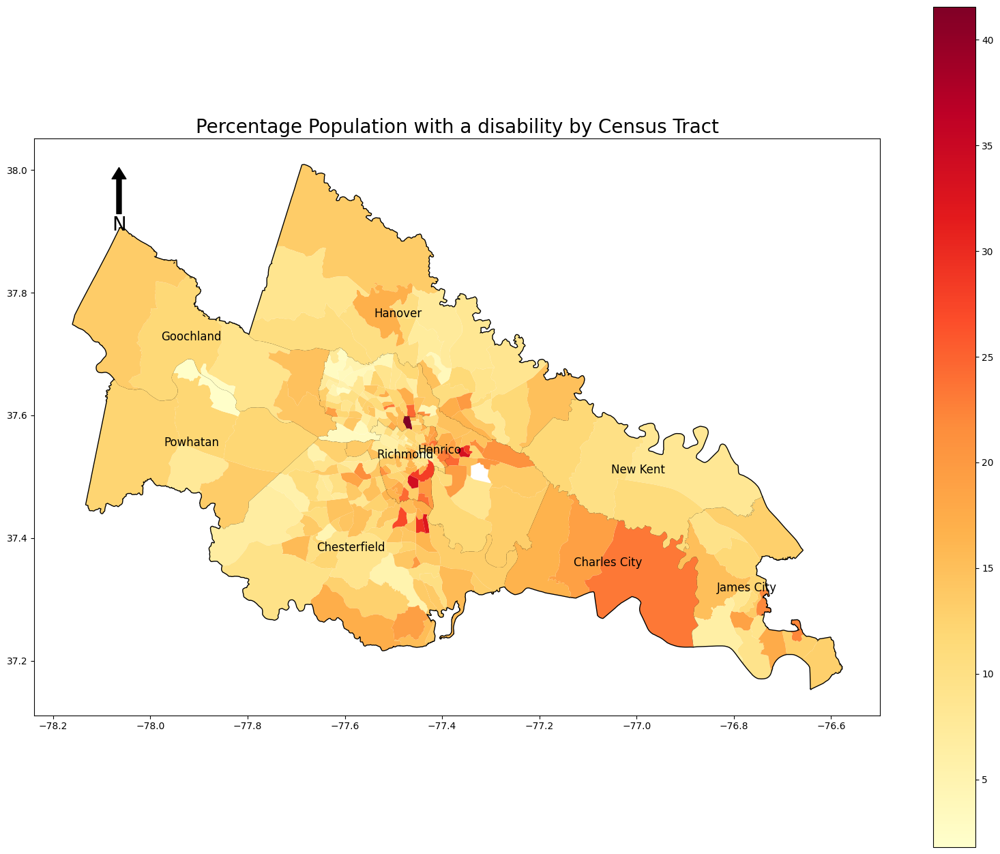

In [217]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_County_RVA.plot(color='White',edgecolor='k',linewidth = 2,ax=ax) ## Locality boundaries
gdf_NoDis.plot(column='Perc_NoDis',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Add Title and Labels
ax.set_title('Percentage Population with a disability by Census Tract', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
map_name = 'Perc_NoDis.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [218]:
df_acs2021_var6

,B18101_004E,B18101_007E,B18101_010E,B18101_013E,B18101_016E,B18101_019E,B18101_023E,B18101_026E,B18101_029E,B18101_032E,B18101_035E,B18101_038E,B01003_001E,state,county,tract,GEOID,Year,locality,Perc_NoDis
0,0,16,15,12,13,22,0,12,16,79,116,35,2952,51,03368,320602,51085320602,2022,Ashland,11.382114
1,0,0,65,48,58,78,0,4,107,19,93,73,5249,51,03368,320601,51085320601,2022,Ashland,10.382930
2,0,6,7,74,34,65,0,8,21,112,48,78,2722,51,036,600100,51036600100,2022,Charles City,16.642175
3,0,2,5,92,51,57,0,21,19,66,54,85,2374,51,036,600200,51036600200,2022,Charles City,19.039596
4,0,14,24,61,44,46,0,0,21,44,74,61,1664,51,036,600300,51036600300,2022,Charles City,23.377404
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,0,0,111,204,201,136,0,32,0,244,59,242,10555,51,095,080402,51095080402,2022,James City,11.643771
294,0,0,15,52,135,12,0,14,0,55,60,31,3919,51,095,080403,51095080403,2022,James City,9.543251
295,0,23,0,128,74,56,0,0,19,67,70,99,4168,51,095,080404,51095080404,2022,James City,12.859885
296,0,0,41,24,116,69,0,23,51,0,87,0,3725,51,095,080208,51095080208,2022,James City,11.033557


In [219]:
# var 7: % pop aged 65 years and over: DP05_0024E/DP05_0001E**

In [220]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5/profile'
get = '?get='
variables = 'DP05_0024E,DP05_0001E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [221]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5/profile?get=DP05_0024E,DP05_0001E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [222]:
response_HC_YM_acs2021

<Response [200]>

In [223]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021

,DP05_0024E,DP05_0001E,state,county,tract
1,613,2722,51,036,600100
2,645,2374,51,036,600200
3,473,1664,51,036,600300
4,604,3851,51,041,100106
5,198,2511,51,041,100107
...,...,...,...,...,...
292,470,3092,51,760,070902
293,598,4257,51,760,071002
294,537,2556,51,760,071003
295,270,1821,51,760,071004


In [224]:
#Getting Ashland Data-

In [225]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [226]:
df_acs2021_a # Ashland Census Tracts

,DP05_0024E,DP05_0001E,state,county,tract
90,621,5249,51,03368,320601
91,722,2952,51,03368,320602


In [227]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb

,DP05_0024E,DP05_0001E,state,county,tract
1,613,2722,51,036,600100
2,645,2374,51,036,600200
3,473,1664,51,036,600300
4,604,3851,51,041,100106
5,198,2511,51,041,100107
...,...,...,...,...,...
294,537,2556,51,760,071003
295,270,1821,51,760,071004
296,892,5380,51,760,071100
90,621,5249,51,03368,320601


In [228]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [229]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [230]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [231]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [232]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [233]:
df_acs2021_comb

,DP05_0024E,DP05_0001E,state,county,tract
0,722,2952,51,03368,320602
1,621,5249,51,03368,320601
2,613,2722,51,036,600100
3,645,2374,51,036,600200
4,473,1664,51,036,600300
...,...,...,...,...,...
293,2364,10555,51,095,080402
294,618,3919,51,095,080403
295,1064,4168,51,095,080404
296,1374,3725,51,095,080208


In [234]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [235]:
df_acs2021_comb.drop(index_names, inplace = True)
df_acs2021_comb

,DP05_0024E,DP05_0001E,state,county,tract
0,722,2952,51,03368,320602
1,621,5249,51,03368,320601
2,613,2722,51,036,600100
3,645,2374,51,036,600200
4,473,1664,51,036,600300
...,...,...,...,...,...
293,2364,10555,51,095,080402
294,618,3919,51,095,080403
295,1064,4168,51,095,080404
296,1374,3725,51,095,080208


In [236]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [237]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']
df_acs2021

,DP05_0024E,DP05_0001E,state,county,tract,GEOID
0,722,2952,51,03368,320602,5103368320602
1,621,5249,51,03368,320601,5103368320601
2,613,2722,51,036,600100,51036600100
3,645,2374,51,036,600200,51036600200
4,473,1664,51,036,600300,51036600300
...,...,...,...,...,...,...
293,2364,10555,51,095,080402,51095080402
294,618,3919,51,095,080403,51095080403
295,1064,4168,51,095,080404,51095080404
296,1374,3725,51,095,080208,51095080208


In [238]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})
df_acs2021

,DP05_0024E,DP05_0001E,state,county,tract,GEOID
0,722,2952,51,03368,320602,51085320602
1,621,5249,51,03368,320601,51085320601
2,613,2722,51,036,600100,51036600100
3,645,2374,51,036,600200,51036600200
4,473,1664,51,036,600300,51036600300
...,...,...,...,...,...,...
293,2364,10555,51,095,080402,51095080402
294,618,3919,51,095,080403,51095080403
295,1064,4168,51,095,080404,51095080404
296,1374,3725,51,095,080208,51095080208


In [239]:
df_acs2021['Year'] = Year
df_acs2021.head()

,DP05_0024E,DP05_0001E,state,county,tract,GEOID,Year
0,722,2952,51,03368,320602,51085320602,2022
1,621,5249,51,03368,320601,51085320601,2022
2,613,2722,51,036,600100,51036600100,2022
3,645,2374,51,036,600200,51036600200,2022
4,473,1664,51,036,600300,51036600300,2022


In [240]:
df_acs2021['DP05_0024E'] = df_acs2021['DP05_0024E'].astype(int)
df_acs2021['DP05_0001E'] = df_acs2021['DP05_0001E'].astype(int)


df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021

,DP05_0024E,DP05_0001E,state,county,tract,GEOID,Year
0,722,2952,51,03368,320602,51085320602,2022
1,621,5249,51,03368,320601,51085320601,2022
2,613,2722,51,036,600100,51036600100,2022
3,645,2374,51,036,600200,51036600200,2022
4,473,1664,51,036,600300,51036600300,2022
...,...,...,...,...,...,...,...
293,2364,10555,51,095,080402,51095080402,2022
294,618,3919,51,095,080403,51095080403,2022
295,1064,4168,51,095,080404,51095080404,2022
296,1374,3725,51,095,080208,51095080208,2022


In [241]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [242]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [243]:
df_acs2021.columns

Index(['DP05_0024E', 'DP05_0001E', 'state', 'county', 'tract', 'GEOID', 'Year',
       'locality'],
      dtype='object')

In [244]:
df_acs2021

,DP05_0024E,DP05_0001E,state,county,tract,GEOID,Year,locality
0,722,2952,51,03368,320602,51085320602,2022,Ashland
1,621,5249,51,03368,320601,51085320601,2022,Ashland
2,613,2722,51,036,600100,51036600100,2022,Charles City
3,645,2374,51,036,600200,51036600200,2022,Charles City
4,473,1664,51,036,600300,51036600300,2022,Charles City
...,...,...,...,...,...,...,...,...
293,2364,10555,51,095,080402,51095080402,2022,James City
294,618,3919,51,095,080403,51095080403,2022,James City
295,1064,4168,51,095,080404,51095080404,2022,James City
296,1374,3725,51,095,080208,51095080208,2022,James City


In [245]:
df_acs2021['Perc_Over65'] = df_acs2021['DP05_0024E'] / df_acs2021['DP05_0001E'] *100 

In [246]:
df_acs2021.head()

,DP05_0024E,DP05_0001E,state,county,tract,GEOID,Year,locality,Perc_Over65
0,722,2952,51,03368,320602,51085320602,2022,Ashland,24.457995
1,621,5249,51,03368,320601,51085320601,2022,Ashland,11.830825
2,613,2722,51,036,600100,51036600100,2022,Charles City,22.520206
3,645,2374,51,036,600200,51036600200,2022,Charles City,27.169334
4,473,1664,51,036,600300,51036600300,2022,Charles City,28.425481


In [247]:
## Store vaariable data in new variable 

df_acs2021_var7 = df_acs2021

In [248]:
## Visualize on a map



In [249]:
gdf_Over65 = pd.merge(gdf_US_CT,df_acs2021_var7, on = 'GEOID', how = 'inner')

In [250]:
gdf_Over65.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,INTPTLON,geometry,DP05_0024E,DP05_0001E,state,county,tract,Year,locality,Perc_Over65
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",1622,5516,51,085,320100,2022,Hanover,29.405366
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",1050,4585,51,085,321201,2022,Hanover,22.900763
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",393,4364,51,085,321202,2022,Hanover,9.005500
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,...,-077.5209363,"POLYGON ((-77.61233 37.75986, -77.61216 37.760...",999,5455,51,085,320400,2022,Hanover,18.313474
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,...,-077.4043263,"POLYGON ((-77.41507 37.56327, -77.41492 37.563...",487,3238,51,087,201002,2022,Henrico,15.040148


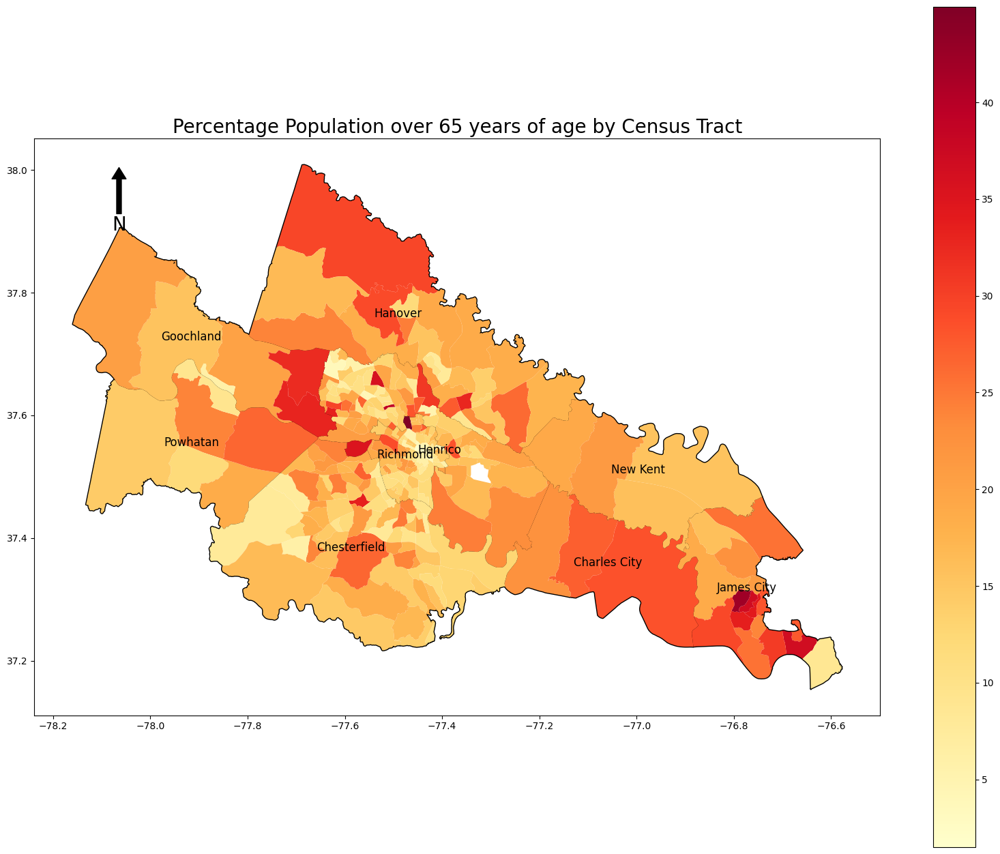

In [251]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_County_RVA.plot(color='White',edgecolor='k',linewidth = 2,ax=ax) ## Locality boundaries
gdf_Over65.plot(column='Perc_Over65',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Add Title and Labels
ax.set_title('Percentage Population over 65 years of age by Census Tract', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)


# Save the map
map_name = 'Perc_Over65.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [252]:
df_acs2021_var7

,DP05_0024E,DP05_0001E,state,county,tract,GEOID,Year,locality,Perc_Over65
0,722,2952,51,03368,320602,51085320602,2022,Ashland,24.457995
1,621,5249,51,03368,320601,51085320601,2022,Ashland,11.830825
2,613,2722,51,036,600100,51036600100,2022,Charles City,22.520206
3,645,2374,51,036,600200,51036600200,2022,Charles City,27.169334
4,473,1664,51,036,600300,51036600300,2022,Charles City,28.425481
...,...,...,...,...,...,...,...,...,...
293,2364,10555,51,095,080402,51095080402,2022,James City,22.396968
294,618,3919,51,095,080403,51095080403,2022,James City,15.769329
295,1064,4168,51,095,080404,51095080404,2022,James City,25.527831
296,1374,3725,51,095,080208,51095080208,2022,James City,36.885906


In [253]:
# var8: % pop aged under 5 years: DP05_0005E/DP05_0001E**

In [254]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5/profile'
get = '?get='
variables = 'DP05_0005E,DP05_0001E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [255]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5/profile?get=DP05_0005E,DP05_0001E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [256]:
response_HC_YM_acs2021

<Response [200]>

In [257]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021

,DP05_0005E,DP05_0001E,state,county,tract
1,142,2722,51,036,600100
2,76,2374,51,036,600200
3,43,1664,51,036,600300
4,227,3851,51,041,100106
5,204,2511,51,041,100107
...,...,...,...,...,...
292,26,3092,51,760,070902
293,411,4257,51,760,071002
294,38,2556,51,760,071003
295,146,1821,51,760,071004


In [258]:
#Getting Ashland Data-

In [259]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [260]:
df_acs2021_a # Ashland Census Tracts

,DP05_0005E,DP05_0001E,state,county,tract
90,221,5249,51,03368,320601
91,167,2952,51,03368,320602


In [261]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb

,DP05_0005E,DP05_0001E,state,county,tract
1,142,2722,51,036,600100
2,76,2374,51,036,600200
3,43,1664,51,036,600300
4,227,3851,51,041,100106
5,204,2511,51,041,100107
...,...,...,...,...,...
294,38,2556,51,760,071003
295,146,1821,51,760,071004
296,194,5380,51,760,071100
90,221,5249,51,03368,320601


In [262]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [263]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [264]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [265]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [266]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [267]:
df_acs2021_comb

,DP05_0005E,DP05_0001E,state,county,tract
0,167,2952,51,03368,320602
1,221,5249,51,03368,320601
2,142,2722,51,036,600100
3,76,2374,51,036,600200
4,43,1664,51,036,600300
...,...,...,...,...,...
293,691,10555,51,095,080402
294,246,3919,51,095,080403
295,233,4168,51,095,080404
296,82,3725,51,095,080208


In [268]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [269]:
df_acs2021_comb.drop(index_names, inplace = True)
df_acs2021_comb

,DP05_0005E,DP05_0001E,state,county,tract
0,167,2952,51,03368,320602
1,221,5249,51,03368,320601
2,142,2722,51,036,600100
3,76,2374,51,036,600200
4,43,1664,51,036,600300
...,...,...,...,...,...
293,691,10555,51,095,080402
294,246,3919,51,095,080403
295,233,4168,51,095,080404
296,82,3725,51,095,080208


In [270]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [271]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']
df_acs2021

,DP05_0005E,DP05_0001E,state,county,tract,GEOID
0,167,2952,51,03368,320602,5103368320602
1,221,5249,51,03368,320601,5103368320601
2,142,2722,51,036,600100,51036600100
3,76,2374,51,036,600200,51036600200
4,43,1664,51,036,600300,51036600300
...,...,...,...,...,...,...
293,691,10555,51,095,080402,51095080402
294,246,3919,51,095,080403,51095080403
295,233,4168,51,095,080404,51095080404
296,82,3725,51,095,080208,51095080208


In [272]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})
df_acs2021

,DP05_0005E,DP05_0001E,state,county,tract,GEOID
0,167,2952,51,03368,320602,51085320602
1,221,5249,51,03368,320601,51085320601
2,142,2722,51,036,600100,51036600100
3,76,2374,51,036,600200,51036600200
4,43,1664,51,036,600300,51036600300
...,...,...,...,...,...,...
293,691,10555,51,095,080402,51095080402
294,246,3919,51,095,080403,51095080403
295,233,4168,51,095,080404,51095080404
296,82,3725,51,095,080208,51095080208


In [273]:
df_acs2021['Year'] = Year
df_acs2021.head()

,DP05_0005E,DP05_0001E,state,county,tract,GEOID,Year
0,167,2952,51,03368,320602,51085320602,2022
1,221,5249,51,03368,320601,51085320601,2022
2,142,2722,51,036,600100,51036600100,2022
3,76,2374,51,036,600200,51036600200,2022
4,43,1664,51,036,600300,51036600300,2022


In [274]:
df_acs2021['DP05_0005E'] = df_acs2021['DP05_0005E'].astype(int)
df_acs2021['DP05_0001E'] = df_acs2021['DP05_0001E'].astype(int)


df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021

,DP05_0005E,DP05_0001E,state,county,tract,GEOID,Year
0,167,2952,51,03368,320602,51085320602,2022
1,221,5249,51,03368,320601,51085320601,2022
2,142,2722,51,036,600100,51036600100,2022
3,76,2374,51,036,600200,51036600200,2022
4,43,1664,51,036,600300,51036600300,2022
...,...,...,...,...,...,...,...
293,691,10555,51,095,080402,51095080402,2022
294,246,3919,51,095,080403,51095080403,2022
295,233,4168,51,095,080404,51095080404,2022
296,82,3725,51,095,080208,51095080208,2022


In [275]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [276]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [277]:
df_acs2021.columns

Index(['DP05_0005E', 'DP05_0001E', 'state', 'county', 'tract', 'GEOID', 'Year',
       'locality'],
      dtype='object')

In [278]:
df_acs2021

,DP05_0005E,DP05_0001E,state,county,tract,GEOID,Year,locality
0,167,2952,51,03368,320602,51085320602,2022,Ashland
1,221,5249,51,03368,320601,51085320601,2022,Ashland
2,142,2722,51,036,600100,51036600100,2022,Charles City
3,76,2374,51,036,600200,51036600200,2022,Charles City
4,43,1664,51,036,600300,51036600300,2022,Charles City
...,...,...,...,...,...,...,...,...
293,691,10555,51,095,080402,51095080402,2022,James City
294,246,3919,51,095,080403,51095080403,2022,James City
295,233,4168,51,095,080404,51095080404,2022,James City
296,82,3725,51,095,080208,51095080208,2022,James City


In [279]:
df_acs2021['Perc_Under5'] = df_acs2021['DP05_0005E'] / df_acs2021['DP05_0001E'] *100 

In [280]:
df_acs2021.head()

,DP05_0005E,DP05_0001E,state,county,tract,GEOID,Year,locality,Perc_Under5
0,167,2952,51,03368,320602,51085320602,2022,Ashland,5.657182
1,221,5249,51,03368,320601,51085320601,2022,Ashland,4.210326
2,142,2722,51,036,600100,51036600100,2022,Charles City,5.216752
3,76,2374,51,036,600200,51036600200,2022,Charles City,3.201348
4,43,1664,51,036,600300,51036600300,2022,Charles City,2.584135


In [281]:
## Store vaariable data in new variable 

df_acs2021_var8 = df_acs2021

In [282]:
## Visualize on a map



In [283]:
gdf_Under5 = pd.merge(gdf_US_CT,df_acs2021_var8, on = 'GEOID', how = 'inner')

In [284]:
gdf_Under5.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,INTPTLON,geometry,DP05_0005E,DP05_0001E,state,county,tract,Year,locality,Perc_Under5
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",256,5516,51,085,320100,2022,Hanover,4.641044
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",134,4585,51,085,321201,2022,Hanover,2.922574
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",405,4364,51,085,321202,2022,Hanover,9.280477
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,...,-077.5209363,"POLYGON ((-77.61233 37.75986, -77.61216 37.760...",386,5455,51,085,320400,2022,Hanover,7.076077
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,...,-077.4043263,"POLYGON ((-77.41507 37.56327, -77.41492 37.563...",151,3238,51,087,201002,2022,Henrico,4.663372


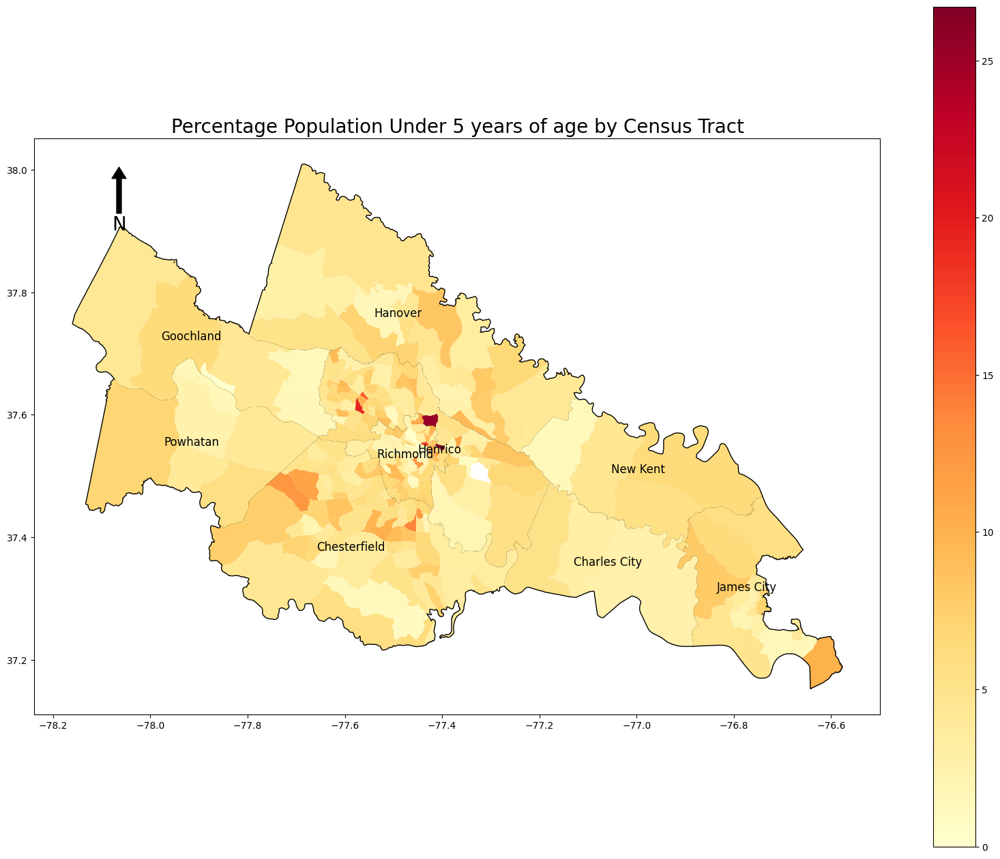

In [285]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_County_RVA.plot(color='White',edgecolor='k',linewidth = 2,ax=ax) ## Locality boundaries
gdf_Under5.plot(column='Perc_Under5',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Add Title and Labels
ax.set_title('Percentage Population Under 5 years of age by Census Tract', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
map_name = 'Perc_Under5.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [286]:
df_acs2021_var8

,DP05_0005E,DP05_0001E,state,county,tract,GEOID,Year,locality,Perc_Under5
0,167,2952,51,03368,320602,51085320602,2022,Ashland,5.657182
1,221,5249,51,03368,320601,51085320601,2022,Ashland,4.210326
2,142,2722,51,036,600100,51036600100,2022,Charles City,5.216752
3,76,2374,51,036,600200,51036600200,2022,Charles City,3.201348
4,43,1664,51,036,600300,51036600300,2022,Charles City,2.584135
...,...,...,...,...,...,...,...,...,...
293,691,10555,51,095,080402,51095080402,2022,James City,6.546660
294,246,3919,51,095,080403,51095080403,2022,James City,6.277112
295,233,4168,51,095,080404,51095080404,2022,James City,5.590211
296,82,3725,51,095,080208,51095080208,2022,James City,2.201342


In [287]:
# var9: % pop that speaks english less than "very well": B06007_005E/B01003_001E*

In [288]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5'
get = '?get='
variables = 'B06007_005E,B06007_008E,B01003_001E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [289]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5?get=B06007_005E,B06007_008E,B01003_001E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [290]:
response_HC_YM_acs2021

<Response [200]>

In [291]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021

,B06007_005E,B06007_008E,B01003_001E,state,county,tract
1,21,0,2722,51,036,600100
2,0,4,2374,51,036,600200
3,0,0,1664,51,036,600300
4,52,0,3851,51,041,100106
5,351,49,2511,51,041,100107
...,...,...,...,...,...,...
292,18,0,3092,51,760,070902
293,254,68,4257,51,760,071002
294,26,87,2556,51,760,071003
295,34,12,1821,51,760,071004


In [292]:
#Getting Ashland Data-

In [293]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [294]:
df_acs2021_a # Ashland Census Tracts

,B06007_005E,B06007_008E,B01003_001E,state,county,tract
90,116,47,5249,51,03368,320601
91,162,10,2952,51,03368,320602


In [295]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb

,B06007_005E,B06007_008E,B01003_001E,state,county,tract
1,21,0,2722,51,036,600100
2,0,4,2374,51,036,600200
3,0,0,1664,51,036,600300
4,52,0,3851,51,041,100106
5,351,49,2511,51,041,100107
...,...,...,...,...,...,...
294,26,87,2556,51,760,071003
295,34,12,1821,51,760,071004
296,20,26,5380,51,760,071100
90,116,47,5249,51,03368,320601


In [296]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [297]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [298]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [299]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [300]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [301]:
df_acs2021_comb

,B06007_005E,B06007_008E,B01003_001E,state,county,tract
0,162,10,2952,51,03368,320602
1,116,47,5249,51,03368,320601
2,21,0,2722,51,036,600100
3,0,4,2374,51,036,600200
4,0,0,1664,51,036,600300
...,...,...,...,...,...,...
293,76,0,10555,51,095,080402
294,0,30,3919,51,095,080403
295,35,24,4168,51,095,080404
296,0,0,3725,51,095,080208


In [302]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [303]:
df_acs2021_comb.drop(index_names, inplace = True)
df_acs2021_comb

,B06007_005E,B06007_008E,B01003_001E,state,county,tract
0,162,10,2952,51,03368,320602
1,116,47,5249,51,03368,320601
2,21,0,2722,51,036,600100
3,0,4,2374,51,036,600200
4,0,0,1664,51,036,600300
...,...,...,...,...,...,...
293,76,0,10555,51,095,080402
294,0,30,3919,51,095,080403
295,35,24,4168,51,095,080404
296,0,0,3725,51,095,080208


In [304]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [305]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']
df_acs2021

,B06007_005E,B06007_008E,B01003_001E,state,county,tract,GEOID
0,162,10,2952,51,03368,320602,5103368320602
1,116,47,5249,51,03368,320601,5103368320601
2,21,0,2722,51,036,600100,51036600100
3,0,4,2374,51,036,600200,51036600200
4,0,0,1664,51,036,600300,51036600300
...,...,...,...,...,...,...,...
293,76,0,10555,51,095,080402,51095080402
294,0,30,3919,51,095,080403,51095080403
295,35,24,4168,51,095,080404,51095080404
296,0,0,3725,51,095,080208,51095080208


In [306]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})
df_acs2021

,B06007_005E,B06007_008E,B01003_001E,state,county,tract,GEOID
0,162,10,2952,51,03368,320602,51085320602
1,116,47,5249,51,03368,320601,51085320601
2,21,0,2722,51,036,600100,51036600100
3,0,4,2374,51,036,600200,51036600200
4,0,0,1664,51,036,600300,51036600300
...,...,...,...,...,...,...,...
293,76,0,10555,51,095,080402,51095080402
294,0,30,3919,51,095,080403,51095080403
295,35,24,4168,51,095,080404,51095080404
296,0,0,3725,51,095,080208,51095080208


In [307]:
df_acs2021['Year'] = Year
df_acs2021.head()

,B06007_005E,B06007_008E,B01003_001E,state,county,tract,GEOID,Year
0,162,10,2952,51,03368,320602,51085320602,2022
1,116,47,5249,51,03368,320601,51085320601,2022
2,21,0,2722,51,036,600100,51036600100,2022
3,0,4,2374,51,036,600200,51036600200,2022
4,0,0,1664,51,036,600300,51036600300,2022


In [308]:
df_acs2021['B06007_005E'] = df_acs2021['B06007_005E'].astype(int)
df_acs2021['B01003_001E'] = df_acs2021['B01003_001E'].astype(int)
df_acs2021['B06007_008E'] = df_acs2021['B06007_008E'].astype(int)



df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021

,B06007_005E,B06007_008E,B01003_001E,state,county,tract,GEOID,Year
0,162,10,2952,51,03368,320602,51085320602,2022
1,116,47,5249,51,03368,320601,51085320601,2022
2,21,0,2722,51,036,600100,51036600100,2022
3,0,4,2374,51,036,600200,51036600200,2022
4,0,0,1664,51,036,600300,51036600300,2022
...,...,...,...,...,...,...,...,...
293,76,0,10555,51,095,080402,51095080402,2022
294,0,30,3919,51,095,080403,51095080403,2022
295,35,24,4168,51,095,080404,51095080404,2022
296,0,0,3725,51,095,080208,51095080208,2022


In [309]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [310]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [311]:
df_acs2021.columns

Index(['B06007_005E', 'B06007_008E', 'B01003_001E', 'state', 'county', 'tract',
       'GEOID', 'Year', 'locality'],
      dtype='object')

In [312]:
df_acs2021

,B06007_005E,B06007_008E,B01003_001E,state,county,tract,GEOID,Year,locality
0,162,10,2952,51,03368,320602,51085320602,2022,Ashland
1,116,47,5249,51,03368,320601,51085320601,2022,Ashland
2,21,0,2722,51,036,600100,51036600100,2022,Charles City
3,0,4,2374,51,036,600200,51036600200,2022,Charles City
4,0,0,1664,51,036,600300,51036600300,2022,Charles City
...,...,...,...,...,...,...,...,...,...
293,76,0,10555,51,095,080402,51095080402,2022,James City
294,0,30,3919,51,095,080403,51095080403,2022,James City
295,35,24,4168,51,095,080404,51095080404,2022,James City
296,0,0,3725,51,095,080208,51095080208,2022,James City


In [313]:
df_acs2021['Perc_NoEng'] = (df_acs2021['B06007_005E']+df_acs2021['B06007_008E']) / df_acs2021['B01003_001E'] *100 

In [314]:
df_acs2021.head()

,B06007_005E,B06007_008E,B01003_001E,state,county,tract,GEOID,Year,locality,Perc_NoEng
0,162,10,2952,51,03368,320602,51085320602,2022,Ashland,5.826558
1,116,47,5249,51,03368,320601,51085320601,2022,Ashland,3.105353
2,21,0,2722,51,036,600100,51036600100,2022,Charles City,0.771492
3,0,4,2374,51,036,600200,51036600200,2022,Charles City,0.168492
4,0,0,1664,51,036,600300,51036600300,2022,Charles City,0.000000


In [315]:
## Store vaariable data in new variable 

df_acs2021_var9 = df_acs2021

In [316]:
## Visualize on a map



In [317]:
gdf_NoEng = pd.merge(gdf_US_CT,df_acs2021_var9, on = 'GEOID', how = 'inner')

In [318]:
gdf_NoEng.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,geometry,B06007_005E,B06007_008E,B01003_001E,state,county,tract,Year,locality,Perc_NoEng
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",0,13,5516,51,085,320100,2022,Hanover,0.235678
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",0,0,4585,51,085,321201,2022,Hanover,0.000000
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",10,51,4364,51,085,321202,2022,Hanover,1.397800
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,...,"POLYGON ((-77.61233 37.75986, -77.61216 37.760...",90,0,5455,51,085,320400,2022,Hanover,1.649863
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,...,"POLYGON ((-77.41507 37.56327, -77.41492 37.563...",0,56,3238,51,087,201002,2022,Henrico,1.729463


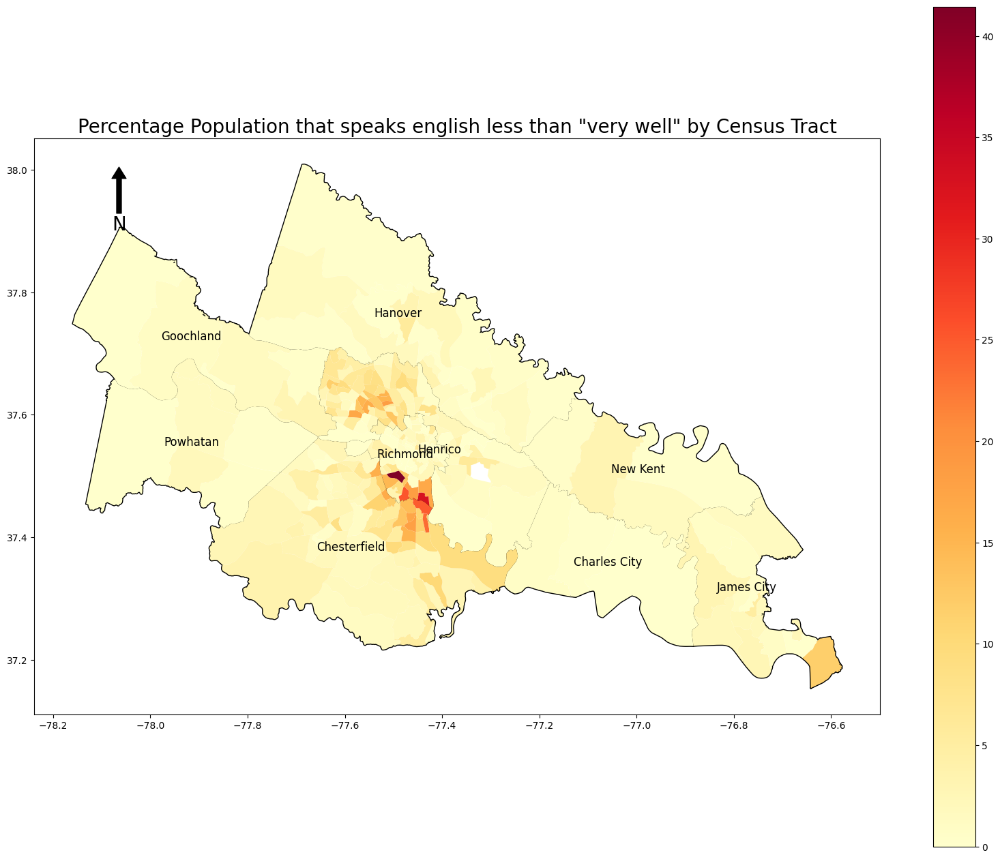

In [319]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_County_RVA.plot(color='White',edgecolor='k',linewidth = 2,ax=ax) ## Locality boundaries
gdf_NoEng.plot(column='Perc_NoEng',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Add Title and Labels
ax.set_title('Percentage Population that speaks english less than "very well" by Census Tract', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
map_name = 'Perc_NoEng.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [320]:
df_acs2021_var9

,B06007_005E,B06007_008E,B01003_001E,state,county,tract,GEOID,Year,locality,Perc_NoEng
0,162,10,2952,51,03368,320602,51085320602,2022,Ashland,5.826558
1,116,47,5249,51,03368,320601,51085320601,2022,Ashland,3.105353
2,21,0,2722,51,036,600100,51036600100,2022,Charles City,0.771492
3,0,4,2374,51,036,600200,51036600200,2022,Charles City,0.168492
4,0,0,1664,51,036,600300,51036600300,2022,Charles City,0.000000
...,...,...,...,...,...,...,...,...,...,...
293,76,0,10555,51,095,080402,51095080402,2022,James City,0.720038
294,0,30,3919,51,095,080403,51095080403,2022,James City,0.765501
295,35,24,4168,51,095,080404,51095080404,2022,James City,1.415547
296,0,0,3725,51,095,080208,51095080208,2022,James City,0.000000


In [321]:
## Var 10: Overcrowding: (DP04_0078E + DP04_0079E)/DP04_0076E

In [322]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5/profile'
get = '?get='
variables = 'DP04_0078E,DP04_0079E,DP04_0076E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [323]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5/profile?get=DP04_0078E,DP04_0079E,DP04_0076E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [324]:
response_HC_YM_acs2021

<Response [200]>

In [325]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021

,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract
1,10,0,1147,51,036,600100
2,2,0,990,51,036,600200
3,11,0,768,51,036,600300
4,0,0,1421,51,041,100106
5,24,35,1087,51,041,100107
...,...,...,...,...,...,...
292,18,18,1116,51,760,070902
293,56,47,1519,51,760,071002
294,0,0,1491,51,760,071003
295,0,0,829,51,760,071004


In [326]:
#Getting Ashland Data-

In [327]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [328]:
df_acs2021_a # Ashland Census Tracts

,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract
90,44,19,1433,51,03368,320601
91,4,0,1445,51,03368,320602


In [329]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb

,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract
1,10,0,1147,51,036,600100
2,2,0,990,51,036,600200
3,11,0,768,51,036,600300
4,0,0,1421,51,041,100106
5,24,35,1087,51,041,100107
...,...,...,...,...,...,...
294,0,0,1491,51,760,071003
295,0,0,829,51,760,071004
296,66,0,2959,51,760,071100
90,44,19,1433,51,03368,320601


In [330]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [331]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [332]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [333]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [334]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [335]:
df_acs2021_comb

,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract
0,4,0,1445,51,03368,320602
1,44,19,1433,51,03368,320601
2,10,0,1147,51,036,600100
3,2,0,990,51,036,600200
4,11,0,768,51,036,600300
...,...,...,...,...,...,...
293,21,0,3818,51,095,080402
294,0,0,1552,51,095,080403
295,0,0,1458,51,095,080404
296,28,0,1448,51,095,080208


In [336]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [337]:
df_acs2021_comb.drop(index_names, inplace = True)
df_acs2021_comb

,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract
0,4,0,1445,51,03368,320602
1,44,19,1433,51,03368,320601
2,10,0,1147,51,036,600100
3,2,0,990,51,036,600200
4,11,0,768,51,036,600300
...,...,...,...,...,...,...
293,21,0,3818,51,095,080402
294,0,0,1552,51,095,080403
295,0,0,1458,51,095,080404
296,28,0,1448,51,095,080208


In [338]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [339]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']
df_acs2021

,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract,GEOID
0,4,0,1445,51,03368,320602,5103368320602
1,44,19,1433,51,03368,320601,5103368320601
2,10,0,1147,51,036,600100,51036600100
3,2,0,990,51,036,600200,51036600200
4,11,0,768,51,036,600300,51036600300
...,...,...,...,...,...,...,...
293,21,0,3818,51,095,080402,51095080402
294,0,0,1552,51,095,080403,51095080403
295,0,0,1458,51,095,080404,51095080404
296,28,0,1448,51,095,080208,51095080208


In [340]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})
df_acs2021

,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract,GEOID
0,4,0,1445,51,03368,320602,51085320602
1,44,19,1433,51,03368,320601,51085320601
2,10,0,1147,51,036,600100,51036600100
3,2,0,990,51,036,600200,51036600200
4,11,0,768,51,036,600300,51036600300
...,...,...,...,...,...,...,...
293,21,0,3818,51,095,080402,51095080402
294,0,0,1552,51,095,080403,51095080403
295,0,0,1458,51,095,080404,51095080404
296,28,0,1448,51,095,080208,51095080208


In [341]:
df_acs2021['Year'] = Year
df_acs2021.head()

,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract,GEOID,Year
0,4,0,1445,51,03368,320602,51085320602,2022
1,44,19,1433,51,03368,320601,51085320601,2022
2,10,0,1147,51,036,600100,51036600100,2022
3,2,0,990,51,036,600200,51036600200,2022
4,11,0,768,51,036,600300,51036600300,2022


In [342]:
df_acs2021['DP04_0078E'] = df_acs2021['DP04_0078E'].astype(int)
df_acs2021['DP04_0079E'] = df_acs2021['DP04_0079E'].astype(int)
df_acs2021['DP04_0076E'] = df_acs2021['DP04_0076E'].astype(int)


df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021

,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract,GEOID,Year
0,4,0,1445,51,03368,320602,51085320602,2022
1,44,19,1433,51,03368,320601,51085320601,2022
2,10,0,1147,51,036,600100,51036600100,2022
3,2,0,990,51,036,600200,51036600200,2022
4,11,0,768,51,036,600300,51036600300,2022
...,...,...,...,...,...,...,...,...
293,21,0,3818,51,095,080402,51095080402,2022
294,0,0,1552,51,095,080403,51095080403,2022
295,0,0,1458,51,095,080404,51095080404,2022
296,28,0,1448,51,095,080208,51095080208,2022


In [343]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [344]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [345]:
df_acs2021.columns

Index(['DP04_0078E', 'DP04_0079E', 'DP04_0076E', 'state', 'county', 'tract',
       'GEOID', 'Year', 'locality'],
      dtype='object')

In [346]:
df_acs2021

,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract,GEOID,Year,locality
0,4,0,1445,51,03368,320602,51085320602,2022,Ashland
1,44,19,1433,51,03368,320601,51085320601,2022,Ashland
2,10,0,1147,51,036,600100,51036600100,2022,Charles City
3,2,0,990,51,036,600200,51036600200,2022,Charles City
4,11,0,768,51,036,600300,51036600300,2022,Charles City
...,...,...,...,...,...,...,...,...,...
293,21,0,3818,51,095,080402,51095080402,2022,James City
294,0,0,1552,51,095,080403,51095080403,2022,James City
295,0,0,1458,51,095,080404,51095080404,2022,James City
296,28,0,1448,51,095,080208,51095080208,2022,James City


In [347]:
df_acs2021['Perc_Crowd'] = (df_acs2021['DP04_0078E'] + df_acs2021['DP04_0079E']) / df_acs2021['DP04_0076E'] *100 

In [348]:
df_acs2021.head()

,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract,GEOID,Year,locality,Perc_Crowd
0,4,0,1445,51,03368,320602,51085320602,2022,Ashland,0.276817
1,44,19,1433,51,03368,320601,51085320601,2022,Ashland,4.396371
2,10,0,1147,51,036,600100,51036600100,2022,Charles City,0.871840
3,2,0,990,51,036,600200,51036600200,2022,Charles City,0.202020
4,11,0,768,51,036,600300,51036600300,2022,Charles City,1.432292


In [349]:
## Store vaariable data in new variable 

df_acs2021_var10 = df_acs2021

In [350]:
## Visualize on a map



In [351]:
gdf_Crowd = pd.merge(gdf_US_CT,df_acs2021_var10, on = 'GEOID', how = 'inner')

In [352]:
gdf_Crowd.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,geometry,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract,Year,locality,Perc_Crowd
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",0,13,2215,51,085,320100,2022,Hanover,0.586907
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",0,0,1887,51,085,321201,2022,Hanover,0.000000
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",0,26,1778,51,085,321202,2022,Hanover,1.462317
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,...,"POLYGON ((-77.61233 37.75986, -77.61216 37.760...",0,50,2163,51,085,320400,2022,Hanover,2.311604
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,...,"POLYGON ((-77.41507 37.56327, -77.41492 37.563...",0,0,1248,51,087,201002,2022,Henrico,0.000000


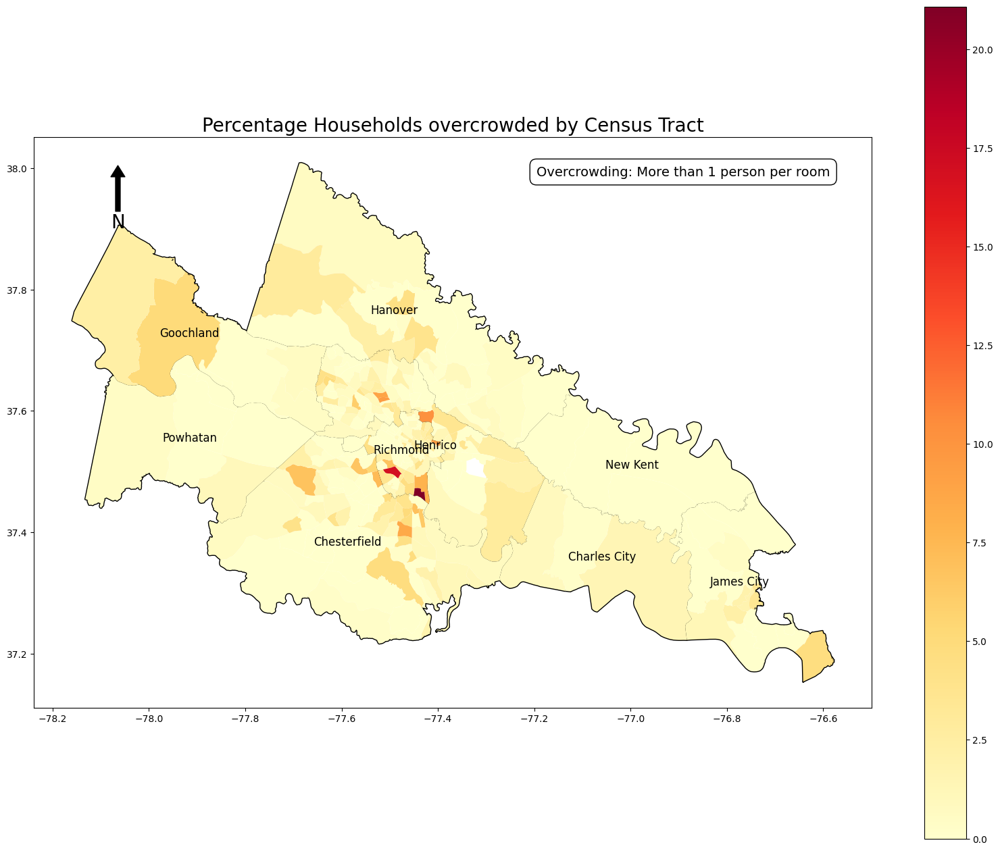

In [353]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_County_RVA.plot(color='White',edgecolor='k',linewidth = 2,ax=ax) ## Locality boundaries
gdf_Crowd.plot(column='Perc_Crowd',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Add Title and Labels
ax.set_title('Percentage Households overcrowded by Census Tract', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Add text box
textstr = "Overcrowding: More than 1 person per room"
props = dict(boxstyle='round,pad=0.5', facecolor='white', edgecolor='black')
ax.text(0.95, 0.95, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', horizontalalignment='right', bbox=props)

# Save the map
map_name = 'Perc_Crowd.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [354]:
df_acs2021_var10

,DP04_0078E,DP04_0079E,DP04_0076E,state,county,tract,GEOID,Year,locality,Perc_Crowd
0,4,0,1445,51,03368,320602,51085320602,2022,Ashland,0.276817
1,44,19,1433,51,03368,320601,51085320601,2022,Ashland,4.396371
2,10,0,1147,51,036,600100,51036600100,2022,Charles City,0.871840
3,2,0,990,51,036,600200,51036600200,2022,Charles City,0.202020
4,11,0,768,51,036,600300,51036600300,2022,Charles City,1.432292
...,...,...,...,...,...,...,...,...,...,...
293,21,0,3818,51,095,080402,51095080402,2022,James City,0.550026
294,0,0,1552,51,095,080403,51095080403,2022,James City,0.000000
295,0,0,1458,51,095,080404,51095080404,2022,James City,0.000000
296,28,0,1448,51,095,080208,51095080208,2022,James City,1.933702


In [355]:
## var11: Communities of color/Underserved Populations: (B01001H_001E + B01001B_001E + B01001C_001E + B01001D_001E + B01001E_001E + B01001I_001E)/B01003_001E*

In [356]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5'
get = '?get='
variables = 'B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [357]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5?get=B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [358]:
response_HC_YM_acs2021

<Response [200]>

In [359]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract
1,1470,1023,85,0,0,81,2722,51,036,600100
2,819,1074,286,1,0,65,2374,51,036,600200
3,669,871,15,12,0,0,1664,51,036,600300
4,3200,299,0,17,0,95,3851,51,041,100106
5,548,1058,5,91,0,841,2511,51,041,100107
...,...,...,...,...,...,...,...,...,...,...
292,459,2623,0,4,0,6,3092,51,760,070902
293,900,2273,15,106,0,609,4257,51,760,071002
294,477,1983,0,22,0,85,2556,51,760,071003
295,234,1388,0,12,0,133,1821,51,760,071004


In [360]:
#Getting Ashland Data-

In [361]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [362]:
df_acs2021_a # Ashland Census Tracts

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract
90,3433,1198,38,82,0,301,5249,51,03368,320601
91,1864,426,0,56,0,587,2952,51,03368,320602


In [363]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract
1,1470,1023,85,0,0,81,2722,51,036,600100
2,819,1074,286,1,0,65,2374,51,036,600200
3,669,871,15,12,0,0,1664,51,036,600300
4,3200,299,0,17,0,95,3851,51,041,100106
5,548,1058,5,91,0,841,2511,51,041,100107
...,...,...,...,...,...,...,...,...,...,...
294,477,1983,0,22,0,85,2556,51,760,071003
295,234,1388,0,12,0,133,1821,51,760,071004
296,2362,2337,15,84,0,225,5380,51,760,071100
90,3433,1198,38,82,0,301,5249,51,03368,320601


In [364]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [365]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [366]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [367]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [368]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [369]:
df_acs2021_comb

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract
0,1864,426,0,56,0,587,2952,51,03368,320602
1,3433,1198,38,82,0,301,5249,51,03368,320601
2,1470,1023,85,0,0,81,2722,51,036,600100
3,819,1074,286,1,0,65,2374,51,036,600200
4,669,871,15,12,0,0,1664,51,036,600300
...,...,...,...,...,...,...,...,...,...,...
293,7569,1830,0,54,0,572,10555,51,095,080402
294,2976,273,0,121,0,182,3919,51,095,080403
295,2925,638,0,271,0,249,4168,51,095,080404
296,3292,112,0,28,0,157,3725,51,095,080208


In [370]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [371]:
df_acs2021_comb.drop(index_names, inplace = True)
df_acs2021_comb

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract
0,1864,426,0,56,0,587,2952,51,03368,320602
1,3433,1198,38,82,0,301,5249,51,03368,320601
2,1470,1023,85,0,0,81,2722,51,036,600100
3,819,1074,286,1,0,65,2374,51,036,600200
4,669,871,15,12,0,0,1664,51,036,600300
...,...,...,...,...,...,...,...,...,...,...
293,7569,1830,0,54,0,572,10555,51,095,080402
294,2976,273,0,121,0,182,3919,51,095,080403
295,2925,638,0,271,0,249,4168,51,095,080404
296,3292,112,0,28,0,157,3725,51,095,080208


In [372]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [373]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']
df_acs2021

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract,GEOID
0,1864,426,0,56,0,587,2952,51,03368,320602,5103368320602
1,3433,1198,38,82,0,301,5249,51,03368,320601,5103368320601
2,1470,1023,85,0,0,81,2722,51,036,600100,51036600100
3,819,1074,286,1,0,65,2374,51,036,600200,51036600200
4,669,871,15,12,0,0,1664,51,036,600300,51036600300
...,...,...,...,...,...,...,...,...,...,...,...
293,7569,1830,0,54,0,572,10555,51,095,080402,51095080402
294,2976,273,0,121,0,182,3919,51,095,080403,51095080403
295,2925,638,0,271,0,249,4168,51,095,080404,51095080404
296,3292,112,0,28,0,157,3725,51,095,080208,51095080208


In [374]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})
df_acs2021

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract,GEOID
0,1864,426,0,56,0,587,2952,51,03368,320602,51085320602
1,3433,1198,38,82,0,301,5249,51,03368,320601,51085320601
2,1470,1023,85,0,0,81,2722,51,036,600100,51036600100
3,819,1074,286,1,0,65,2374,51,036,600200,51036600200
4,669,871,15,12,0,0,1664,51,036,600300,51036600300
...,...,...,...,...,...,...,...,...,...,...,...
293,7569,1830,0,54,0,572,10555,51,095,080402,51095080402
294,2976,273,0,121,0,182,3919,51,095,080403,51095080403
295,2925,638,0,271,0,249,4168,51,095,080404,51095080404
296,3292,112,0,28,0,157,3725,51,095,080208,51095080208


In [375]:
df_acs2021['Year'] = Year
df_acs2021.head()

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract,GEOID,Year
0,1864,426,0,56,0,587,2952,51,03368,320602,51085320602,2022
1,3433,1198,38,82,0,301,5249,51,03368,320601,51085320601,2022
2,1470,1023,85,0,0,81,2722,51,036,600100,51036600100,2022
3,819,1074,286,1,0,65,2374,51,036,600200,51036600200,2022
4,669,871,15,12,0,0,1664,51,036,600300,51036600300,2022


In [376]:
df_acs2021['B01001H_001E'] = df_acs2021['B01001H_001E'].astype(int)
df_acs2021['B01001B_001E'] = df_acs2021['B01001B_001E'].astype(int)
df_acs2021['B01001C_001E'] = df_acs2021['B01001C_001E'].astype(int)
df_acs2021['B01001D_001E'] = df_acs2021['B01001D_001E'].astype(int)
df_acs2021['B01001E_001E'] = df_acs2021['B01001E_001E'].astype(int)
df_acs2021['B01001I_001E'] = df_acs2021['B01001I_001E'].astype(int)
df_acs2021['B01003_001E'] = df_acs2021['B01003_001E'].astype(int)


df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract,GEOID,Year
0,1864,426,0,56,0,587,2952,51,03368,320602,51085320602,2022
1,3433,1198,38,82,0,301,5249,51,03368,320601,51085320601,2022
2,1470,1023,85,0,0,81,2722,51,036,600100,51036600100,2022
3,819,1074,286,1,0,65,2374,51,036,600200,51036600200,2022
4,669,871,15,12,0,0,1664,51,036,600300,51036600300,2022
...,...,...,...,...,...,...,...,...,...,...,...,...
293,7569,1830,0,54,0,572,10555,51,095,080402,51095080402,2022
294,2976,273,0,121,0,182,3919,51,095,080403,51095080403,2022
295,2925,638,0,271,0,249,4168,51,095,080404,51095080404,2022
296,3292,112,0,28,0,157,3725,51,095,080208,51095080208,2022


In [377]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [378]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [379]:
df_acs2021.columns

Index(['B01001H_001E', 'B01001B_001E', 'B01001C_001E', 'B01001D_001E',
       'B01001E_001E', 'B01001I_001E', 'B01003_001E', 'state', 'county',
       'tract', 'GEOID', 'Year', 'locality'],
      dtype='object')

In [380]:
df_acs2021

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract,GEOID,Year,locality
0,1864,426,0,56,0,587,2952,51,03368,320602,51085320602,2022,Ashland
1,3433,1198,38,82,0,301,5249,51,03368,320601,51085320601,2022,Ashland
2,1470,1023,85,0,0,81,2722,51,036,600100,51036600100,2022,Charles City
3,819,1074,286,1,0,65,2374,51,036,600200,51036600200,2022,Charles City
4,669,871,15,12,0,0,1664,51,036,600300,51036600300,2022,Charles City
...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,7569,1830,0,54,0,572,10555,51,095,080402,51095080402,2022,James City
294,2976,273,0,121,0,182,3919,51,095,080403,51095080403,2022,James City
295,2925,638,0,271,0,249,4168,51,095,080404,51095080404,2022,James City
296,3292,112,0,28,0,157,3725,51,095,080208,51095080208,2022,James City


In [381]:
df_acs2021['Perc_UnS'] = (df_acs2021['B01001B_001E'] + df_acs2021['B01001C_001E'] + df_acs2021['B01001D_001E'] + df_acs2021['B01001E_001E'] + df_acs2021['B01001I_001E']) /df_acs2021['B01003_001E']*100

In [382]:
df_acs2021.head()

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract,GEOID,Year,locality,Perc_UnS
0,1864,426,0,56,0,587,2952,51,03368,320602,51085320602,2022,Ashland,36.212737
1,3433,1198,38,82,0,301,5249,51,03368,320601,51085320601,2022,Ashland,30.843970
2,1470,1023,85,0,0,81,2722,51,036,600100,51036600100,2022,Charles City,43.681117
3,819,1074,286,1,0,65,2374,51,036,600200,51036600200,2022,Charles City,60.067397
4,669,871,15,12,0,0,1664,51,036,600300,51036600300,2022,Charles City,53.966346


In [383]:
df_acs2021.sort_values(by='Perc_UnS', ascending=False)

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract,GEOID,Year,locality,Perc_UnS
141,10,2360,0,0,0,17,2393,51,087,201405,51087201405,2022,Henrico,99.331383
265,24,3762,0,0,0,21,3814,51,760,020200,51760020200,2022,Richmond,99.187205
143,78,2326,0,28,0,38,2470,51,087,201206,51087201206,2022,Henrico,96.842105
234,125,2280,0,38,0,3408,5916,51,760,070601,51760070601,2022,Richmond,96.788371
149,209,6049,0,8,0,307,6674,51,087,201003,51087201003,2022,Henrico,95.355109
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207,2447,48,0,19,0,37,2614,51,760,050600,51760050600,2022,Richmond,3.978577
204,5139,141,0,0,0,53,5514,51,145,500102,51145500102,2022,Powhatan,3.518317
183,3803,0,24,67,0,41,4046,51,087,200202,51087200202,2022,Henrico,3.262481
87,3163,55,0,0,0,30,3434,51,085,321402,51085321402,2022,Hanover,2.475248


In [384]:
## Store vaariable data in new variable 

df_acs2021_var11 = df_acs2021

In [385]:
## Visualize on a map



In [386]:
gdf_UnS = pd.merge(gdf_US_CT,df_acs2021_var11, on = 'GEOID', how = 'inner')

In [387]:
gdf_UnS.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract,Year,locality,Perc_UnS
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,18,0,406,5516,51,085,320100,2022,Hanover,13.306744
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,0,0,239,4585,51,085,321201,2022,Hanover,15.637950
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,13,19,213,4364,51,085,321202,2022,Hanover,16.544455
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,...,73,0,452,5455,51,085,320400,2022,Hanover,19.046746
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,...,73,0,24,3238,51,087,201002,2022,Henrico,79.956763


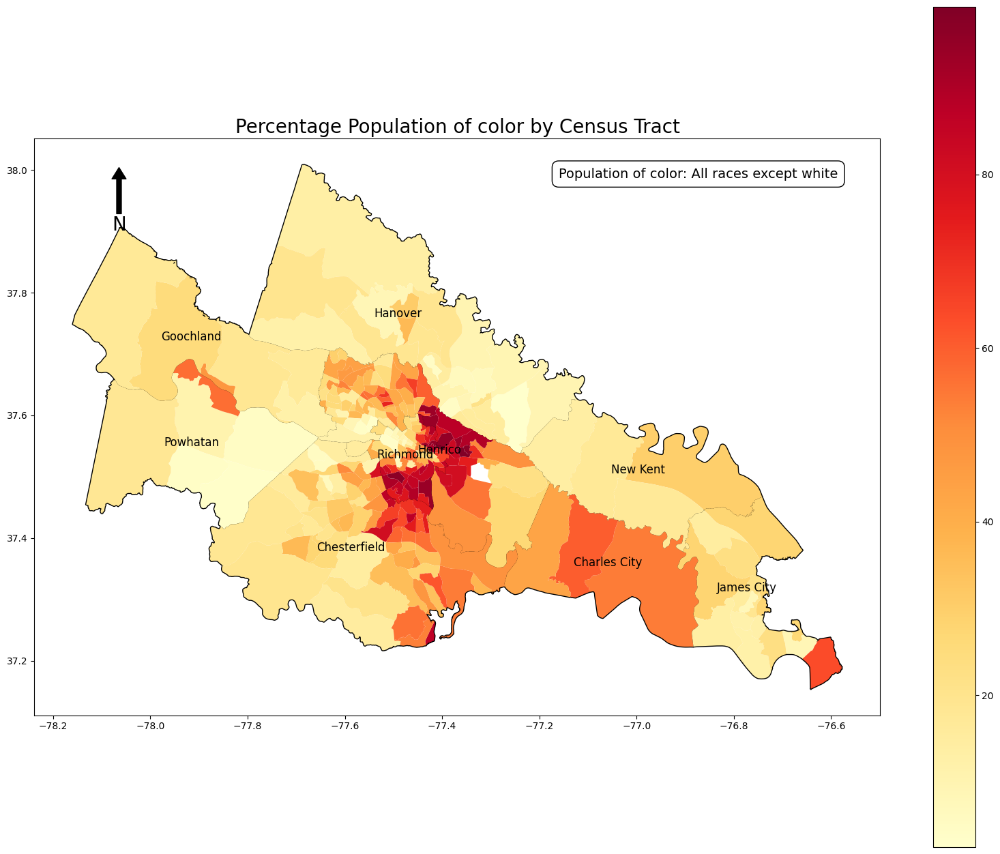

In [388]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_County_RVA.plot(color='White',edgecolor='k',linewidth = 2,ax=ax) ## Locality boundaries
gdf_UnS.plot(column='Perc_UnS',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Add Title and Labels
ax.set_title('Percentage Population of color by Census Tract', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)
# Add text box
textstr = "Population of color: All races except white"
props = dict(boxstyle='round,pad=0.5', facecolor='white', edgecolor='black')
ax.text(0.95, 0.95, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', horizontalalignment='right', bbox=props)

# Save the map
map_name = 'Perc_UnS.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [389]:
df_acs2021_var11

,B01001H_001E,B01001B_001E,B01001C_001E,B01001D_001E,B01001E_001E,B01001I_001E,B01003_001E,state,county,tract,GEOID,Year,locality,Perc_UnS
0,1864,426,0,56,0,587,2952,51,03368,320602,51085320602,2022,Ashland,36.212737
1,3433,1198,38,82,0,301,5249,51,03368,320601,51085320601,2022,Ashland,30.843970
2,1470,1023,85,0,0,81,2722,51,036,600100,51036600100,2022,Charles City,43.681117
3,819,1074,286,1,0,65,2374,51,036,600200,51036600200,2022,Charles City,60.067397
4,669,871,15,12,0,0,1664,51,036,600300,51036600300,2022,Charles City,53.966346
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293,7569,1830,0,54,0,572,10555,51,095,080402,51095080402,2022,James City,23.268593
294,2976,273,0,121,0,182,3919,51,095,080403,51095080403,2022,James City,14.697627
295,2925,638,0,271,0,249,4168,51,095,080404,51095080404,2022,James City,27.783109
296,3292,112,0,28,0,157,3725,51,095,080208,51095080208,2022,James City,7.973154


In [390]:
## Var 12: Pregnant Women: Using Proxy variable - % Women who had a birth in the past 12 months: B13002_002E/B01003_001E

In [391]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5'
get = '?get='
variables = 'B13002_002E,B01003_001E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [392]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5?get=B13002_002E,B01003_001E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [393]:
response_HC_YM_acs2021

<Response [200]>

In [394]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021

,B13002_002E,B01003_001E,state,county,tract
1,21,2722,51,036,600100
2,18,2374,51,036,600200
3,0,1664,51,036,600300
4,15,3851,51,041,100106
5,50,2511,51,041,100107
...,...,...,...,...,...
292,0,3092,51,760,070902
293,15,4257,51,760,071002
294,94,2556,51,760,071003
295,0,1821,51,760,071004


In [395]:
#Getting Ashland Data-

In [396]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [397]:
df_acs2021_a # Ashland Census Tracts

,B13002_002E,B01003_001E,state,county,tract
90,73,5249,51,03368,320601
91,42,2952,51,03368,320602


In [398]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb

,B13002_002E,B01003_001E,state,county,tract
1,21,2722,51,036,600100
2,18,2374,51,036,600200
3,0,1664,51,036,600300
4,15,3851,51,041,100106
5,50,2511,51,041,100107
...,...,...,...,...,...
294,94,2556,51,760,071003
295,0,1821,51,760,071004
296,0,5380,51,760,071100
90,73,5249,51,03368,320601


In [399]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [400]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [401]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [402]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [403]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [404]:
df_acs2021_comb

,B13002_002E,B01003_001E,state,county,tract
0,42,2952,51,03368,320602
1,73,5249,51,03368,320601
2,21,2722,51,036,600100
3,18,2374,51,036,600200
4,0,1664,51,036,600300
...,...,...,...,...,...
293,92,10555,51,095,080402
294,75,3919,51,095,080403
295,31,4168,51,095,080404
296,0,3725,51,095,080208


In [405]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [406]:
df_acs2021_comb.drop(index_names, inplace = True)
df_acs2021_comb

,B13002_002E,B01003_001E,state,county,tract
0,42,2952,51,03368,320602
1,73,5249,51,03368,320601
2,21,2722,51,036,600100
3,18,2374,51,036,600200
4,0,1664,51,036,600300
...,...,...,...,...,...
293,92,10555,51,095,080402
294,75,3919,51,095,080403
295,31,4168,51,095,080404
296,0,3725,51,095,080208


In [407]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [408]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']
df_acs2021

,B13002_002E,B01003_001E,state,county,tract,GEOID
0,42,2952,51,03368,320602,5103368320602
1,73,5249,51,03368,320601,5103368320601
2,21,2722,51,036,600100,51036600100
3,18,2374,51,036,600200,51036600200
4,0,1664,51,036,600300,51036600300
...,...,...,...,...,...,...
293,92,10555,51,095,080402,51095080402
294,75,3919,51,095,080403,51095080403
295,31,4168,51,095,080404,51095080404
296,0,3725,51,095,080208,51095080208


In [409]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})
df_acs2021

,B13002_002E,B01003_001E,state,county,tract,GEOID
0,42,2952,51,03368,320602,51085320602
1,73,5249,51,03368,320601,51085320601
2,21,2722,51,036,600100,51036600100
3,18,2374,51,036,600200,51036600200
4,0,1664,51,036,600300,51036600300
...,...,...,...,...,...,...
293,92,10555,51,095,080402,51095080402
294,75,3919,51,095,080403,51095080403
295,31,4168,51,095,080404,51095080404
296,0,3725,51,095,080208,51095080208


In [410]:
df_acs2021['Year'] = Year
df_acs2021.head()

,B13002_002E,B01003_001E,state,county,tract,GEOID,Year
0,42,2952,51,03368,320602,51085320602,2022
1,73,5249,51,03368,320601,51085320601,2022
2,21,2722,51,036,600100,51036600100,2022
3,18,2374,51,036,600200,51036600200,2022
4,0,1664,51,036,600300,51036600300,2022


In [411]:
df_acs2021['B13002_002E'] = df_acs2021['B13002_002E'].astype(int)
df_acs2021['B01003_001E'] = df_acs2021['B01003_001E'].astype(int)


df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021

,B13002_002E,B01003_001E,state,county,tract,GEOID,Year
0,42,2952,51,03368,320602,51085320602,2022
1,73,5249,51,03368,320601,51085320601,2022
2,21,2722,51,036,600100,51036600100,2022
3,18,2374,51,036,600200,51036600200,2022
4,0,1664,51,036,600300,51036600300,2022
...,...,...,...,...,...,...,...
293,92,10555,51,095,080402,51095080402,2022
294,75,3919,51,095,080403,51095080403,2022
295,31,4168,51,095,080404,51095080404,2022
296,0,3725,51,095,080208,51095080208,2022


In [412]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [413]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [414]:
df_acs2021.columns

Index(['B13002_002E', 'B01003_001E', 'state', 'county', 'tract', 'GEOID',
       'Year', 'locality'],
      dtype='object')

In [415]:
df_acs2021

,B13002_002E,B01003_001E,state,county,tract,GEOID,Year,locality
0,42,2952,51,03368,320602,51085320602,2022,Ashland
1,73,5249,51,03368,320601,51085320601,2022,Ashland
2,21,2722,51,036,600100,51036600100,2022,Charles City
3,18,2374,51,036,600200,51036600200,2022,Charles City
4,0,1664,51,036,600300,51036600300,2022,Charles City
...,...,...,...,...,...,...,...,...
293,92,10555,51,095,080402,51095080402,2022,James City
294,75,3919,51,095,080403,51095080403,2022,James City
295,31,4168,51,095,080404,51095080404,2022,James City
296,0,3725,51,095,080208,51095080208,2022,James City


In [416]:
df_acs2021['Perc_Preg12'] = df_acs2021['B13002_002E'] / df_acs2021['B01003_001E'] *100 

In [417]:
df_acs2021.head()

,B13002_002E,B01003_001E,state,county,tract,GEOID,Year,locality,Perc_Preg12
0,42,2952,51,03368,320602,51085320602,2022,Ashland,1.422764
1,73,5249,51,03368,320601,51085320601,2022,Ashland,1.390741
2,21,2722,51,036,600100,51036600100,2022,Charles City,0.771492
3,18,2374,51,036,600200,51036600200,2022,Charles City,0.758214
4,0,1664,51,036,600300,51036600300,2022,Charles City,0.000000


In [418]:
## Store vaariable data in new variable 

df_acs2021_var12 = df_acs2021

In [419]:
## Visualize on a map



In [420]:
gdf_Preg12 = pd.merge(gdf_US_CT,df_acs2021_var12, on = 'GEOID', how = 'inner')

In [421]:
gdf_Preg12.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,INTPTLON,geometry,B13002_002E,B01003_001E,state,county,tract,Year,locality,Perc_Preg12
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",26,5516,51,085,320100,2022,Hanover,0.471356
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",7,4585,51,085,321201,2022,Hanover,0.152672
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",26,4364,51,085,321202,2022,Hanover,0.595784
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,...,-077.5209363,"POLYGON ((-77.61233 37.75986, -77.61216 37.760...",101,5455,51,085,320400,2022,Hanover,1.851512
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,...,-077.4043263,"POLYGON ((-77.41507 37.56327, -77.41492 37.563...",9,3238,51,087,201002,2022,Henrico,0.277949


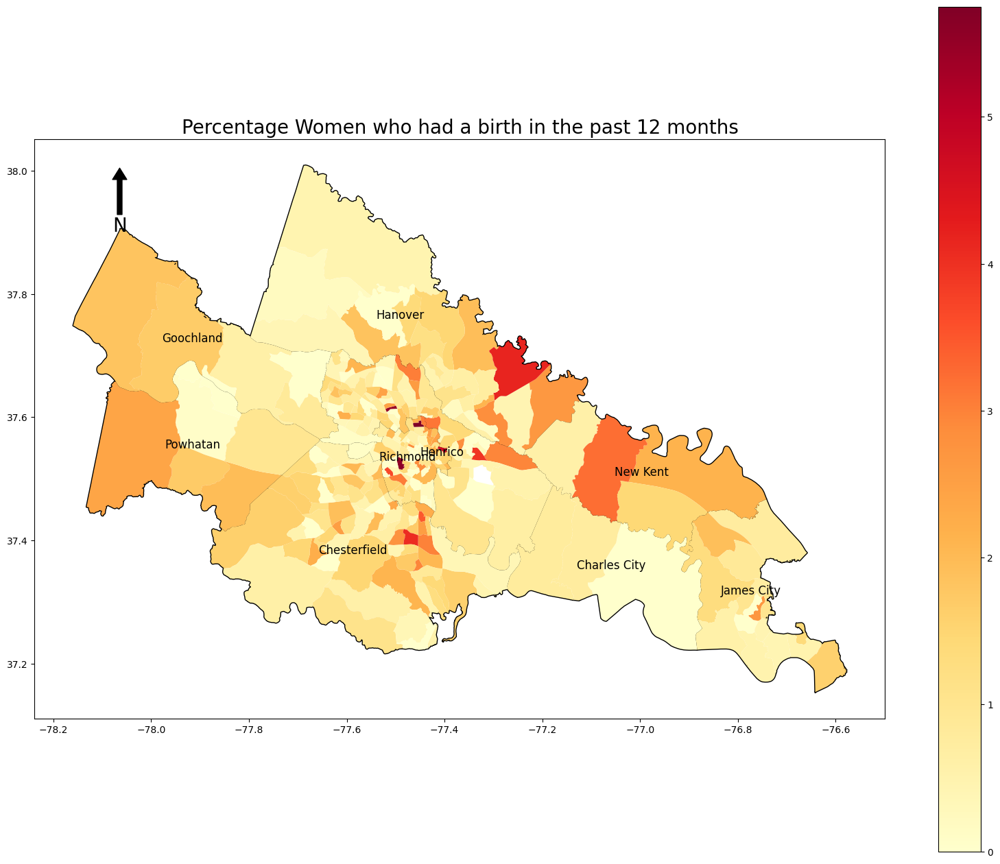

In [422]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_County_RVA.plot(color='White',edgecolor='k',linewidth = 2,ax=ax) ## Locality boundaries
gdf_Preg12.plot(column='Perc_Preg12',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Add Title and Labels
ax.set_title('Percentage Women who had a birth in the past 12 months', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
map_name = 'Perc_Preg12.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [423]:
df_acs2021_var12

,B13002_002E,B01003_001E,state,county,tract,GEOID,Year,locality,Perc_Preg12
0,42,2952,51,03368,320602,51085320602,2022,Ashland,1.422764
1,73,5249,51,03368,320601,51085320601,2022,Ashland,1.390741
2,21,2722,51,036,600100,51036600100,2022,Charles City,0.771492
3,18,2374,51,036,600200,51036600200,2022,Charles City,0.758214
4,0,1664,51,036,600300,51036600300,2022,Charles City,0.000000
...,...,...,...,...,...,...,...,...,...
293,92,10555,51,095,080402,51095080402,2022,James City,0.871625
294,75,3919,51,095,080403,51095080403,2022,James City,1.913754
295,31,4168,51,095,080404,51095080404,2022,James City,0.743762
296,0,3725,51,095,080208,51095080208,2022,James City,0.000000


In [424]:
len(df_acs2021_var12[df_acs2021_var12['county']==760].sort_values(by='GEOID', ascending=True))

0

In [425]:
len(df_acs2021_var12[df_acs2021_var12['county']=='760'])

75

In [426]:
df_acs2021_var12['county'].unique()

array(['03368', '036', '041', '075', '085', '087', '127', '145', '760',
       '095'], dtype=object)

In [427]:
## PIT Data

In [428]:
df_HL = gpd.read_file(r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\PIT Data\PITSurvey_Jan_June_CT.shp")

In [429]:
df_HL

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,Point_Coun,Shape_Leng,Shape_Area,Point_Co_1,HL_Pop,geometry
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534.0,2927606.0,+37.8856871,-077.5726776,0,1.198028,0.033940,0,0.0,"MULTIPOLYGON (((-77.74024 37.87410, -77.74029 ..."
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,0,0.211257,0.001150,0,0.0,"POLYGON ((-77.29123 37.56062, -77.29126 37.560..."
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,0,0.209468,0.000916,0,0.0,"POLYGON ((-77.29616 37.56033, -77.29617 37.560..."
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255.0,348336.0,+37.7231726,-077.5209363,0,0.567573,0.005988,0,0.0,"POLYGON ((-77.48214 37.71538, -77.48119 37.715..."
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230.0,4272.0,+37.5725532,-077.4043263,0,0.101238,0.000309,0,0.0,"POLYGON ((-77.38227 37.57182, -77.38246 37.571..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
285,51,041,100806,51041100806,1008.06,Census Tract 1008.06,G5020,S,2140462.0,44827.0,+37.4336160,-077.4639027,0,0.065935,0.000222,0,0.0,"POLYGON ((-77.45335 37.43758, -77.45347 37.437..."
286,51,041,100922,51041100922,1009.22,Census Tract 1009.22,G5020,S,6557349.0,0.0,+37.4965151,-077.5852426,1,0.115446,0.000668,2,3.0,"POLYGON ((-77.57982 37.50537, -77.57946 37.505..."
287,51,041,100923,51041100923,1009.23,Census Tract 1009.23,G5020,S,3219520.0,0.0,+37.4862643,-077.5590631,0,0.077050,0.000328,0,0.0,"POLYGON ((-77.56347 37.47359, -77.56359 37.473..."
288,51,041,100931,51041100931,1009.31,Census Tract 1009.31,G5020,S,8610865.0,0.0,+37.4880440,-077.6140982,0,0.132519,0.000877,1,1.0,"POLYGON ((-77.59651 37.49036, -77.59647 37.490..."


In [430]:
min_val = df_HL['HL_Pop'].min()

In [431]:
max_val = df_HL['HL_Pop'].max()

In [432]:
def categorize_homeless_population(value, min_val, max_val):
    if value == min_val:
        return 1
    elif value == max_val:
        return 5
    else:
        return round((value - min_val) / (max_val - min_val) * 3) + 2


In [433]:
df_HL['HL_rating'] = df_HL['HL_Pop'].apply(lambda x: categorize_homeless_population(x, min_val, max_val))

In [434]:
df_HL.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'GEOID', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'Point_Coun',
       'Shape_Leng', 'Shape_Area', 'Point_Co_1', 'HL_Pop', 'geometry',
       'HL_rating'],
      dtype='object')

In [435]:
df_HL.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,Point_Coun,Shape_Leng,Shape_Area,Point_Co_1,HL_Pop,geometry,HL_rating
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534.0,2927606.0,+37.8856871,-077.5726776,0,1.198028,0.033940,0,0.0,"MULTIPOLYGON (((-77.74024 37.87410, -77.74029 ...",1
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,0,0.211257,0.001150,0,0.0,"POLYGON ((-77.29123 37.56062, -77.29126 37.560...",1
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,0,0.209468,0.000916,0,0.0,"POLYGON ((-77.29616 37.56033, -77.29617 37.560...",1
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255.0,348336.0,+37.7231726,-077.5209363,0,0.567573,0.005988,0,0.0,"POLYGON ((-77.48214 37.71538, -77.48119 37.715...",1
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230.0,4272.0,+37.5725532,-077.4043263,0,0.101238,0.000309,0,0.0,"POLYGON ((-77.38227 37.57182, -77.38246 37.571...",1


In [436]:
df_HL.iloc[:,[3,-1]]

,GEOID,HL_rating
0,51085320100,1
1,51085321201,1
2,51085321202,1
3,51085320400,1
4,51087201002,1
...,...,...
285,51041100806,1
286,51041100922,2
287,51041100923,1
288,51041100931,2


In [437]:
gdf_HL = pd.merge(gdf_US_CT,df_HL.iloc[:,[3,-1]], on = 'GEOID', how = 'inner')

In [438]:
gdf_HL.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,HL_rating
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,+37.8856871,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",1
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",1
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",1
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,+37.7231726,-077.5209363,"POLYGON ((-77.61233 37.75986, -77.61216 37.760...",1
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,+37.5725532,-077.4043263,"POLYGON ((-77.41507 37.56327, -77.41492 37.563...",1


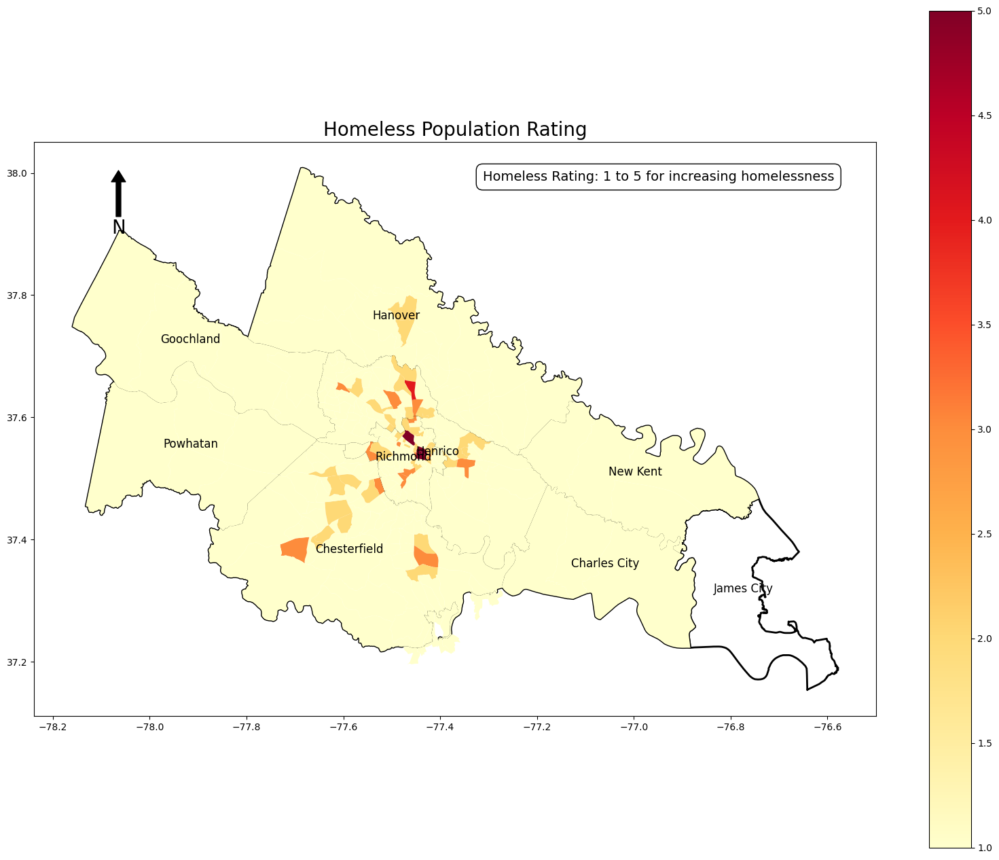

In [439]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_County_RVA.plot(color='White',edgecolor='k',linewidth = 2,ax=ax) ## Locality boundaries
gdf_HL.plot(column='HL_rating',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Add Title and Labels
ax.set_title('Homeless Population Rating', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)
# Add text box
textstr = "Homeless Rating: 1 to 5 for increasing homelessness"
props = dict(boxstyle='round,pad=0.5', facecolor='white', edgecolor='black')
ax.text(0.95, 0.95, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', horizontalalignment='right', bbox=props)

# Save the map
map_name = 'HL_rating.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [440]:
df_acs2021_var13 = df_HL.iloc[:,[3,-1]]

In [441]:
df_acs2021_var13.head()

,GEOID,HL_rating
0,51085320100,1
1,51085321201,1
2,51085321202,1
3,51085320400,1
4,51087201002,1


## BRFSS Data - health data

In [442]:
# Link: https://data.cdc.gov/500-Cities-Places/PLACES-Local-Data-for-Better-Health-Census-Tract-D/nw2y-v4gm/about_data

### PLACES: Local Data for Better Health, Census Tract Data 2022 release
#### 500 Cities & Places
This dataset contains model-based census tract-level estimates for the PLACES 2022 release. PLACES covers the entire United States—50 states and the District of Columbia (DC)—at county, place, census tract, and ZIP Code Tabulation Area levels. It provides information uniformly on this large scale for local areas at 4 geographic levels. Estimates were provided by the Centers for Disease Control and Prevention (CDC), Division of Population Health, Epidemiology and Surveillance Branch. PLACES was funded by the Robert Wood Johnson Foundation in conjunction with the CDC Foundation. The dataset includes estimates for 29 measures: 13 for health outcomes, 9 for preventive services use, 4 for chronic disease-related health risk behaviors, and 3 for health status. These estimates can be used to identify emerging health problems and to help develop and carry out effective, targeted public health prevention activities. Because the small area model cannot detect effects due to local interventions, users are cautioned against using these estimates for program or policy evaluations. 

Data sources used to generate these model-based estimates include Behavioral Risk Factor Surveillance System (BRFSS) 2020 or 2019 data, Census Bureau 2010 population data, and American Community Survey 2015–2019 estimates. The 2022 release uses 2020 BRFSS data for 25 measures and 2019 BRFSS data for 4 measures (high blood pressure, taking high blood pressure medication, high cholesterol, and cholesterol screening) that the survey collects data on every other year. More information about the methodology can be found at www.cdc.gov/places.

In [443]:
df_brfss = pd.read_csv(r"C:\Users\rsingh\Downloads\PLACES__Local_Data_for_Better_Health__Census_Tract_Data_2022_release_20240417.csv")

In [444]:
df_brfss.columns

Index(['Year', 'StateAbbr', 'StateDesc', 'CountyName', 'CountyFIPS',
       'LocationName', 'DataSource', 'Category', 'Measure', 'Data_Value_Unit',
       'Data_Value_Type', 'Data_Value', 'Data_Value_Footnote_Symbol',
       'Data_Value_Footnote', 'Low_Confidence_Limit', 'High_Confidence_Limit',
       'TotalPopulation', 'Geolocation', 'LocationID', 'CategoryID',
       'MeasureId', 'DataValueTypeID', 'Short_Question_Text'],
      dtype='object')

In [445]:
df_brfss.head()

,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,Data_Value_Footnote,Low_Confidence_Limit,High_Confidence_Limit,TotalPopulation,Geolocation,LocationID,CategoryID,MeasureId,DataValueTypeID,Short_Question_Text
0,2020,AL,Alabama,Barbour,1005,1005950800,BRFSS,Health Outcomes,Arthritis among adults aged >=18 years,%,...,NaN,34.3,37.1,2055,POINT (-85.16932432 31.91226373),1005950800,HLTHOUT,ARTHRITIS,CrdPrv,Arthritis
1,2020,AL,Alabama,Bibb,1007,1007010002,BRFSS,Health Outcomes,Stroke among adults aged >=18 years,%,...,NaN,3.2,3.6,6025,POINT (-87.0958027 33.1774109),1007010002,HLTHOUT,STROKE,CrdPrv,Stroke
2,2020,AL,Alabama,Calhoun,1015,1015000900,BRFSS,Health Status,Mental health not good for >=14 days among adu...,%,...,NaN,12.5,14.7,3362,POINT (-85.7931708 33.64793024),1015000900,HLTHSTAT,MHLTH,CrdPrv,Mental Health
3,2020,AL,Alabama,Calhoun,1015,1015002400,BRFSS,Prevention,Mammography use among women aged 50-74 years,%,...,NaN,72.0,79.0,4518,POINT (-85.77310093 33.8739283),1015002400,PREVENT,MAMMOUSE,CrdPrv,Mammography
4,2020,AL,Alabama,Cherokee,1019,1019955900,BRFSS,Health Status,Mental health not good for >=14 days among adu...,%,...,NaN,16.9,18.9,4235,POINT (-85.66863815 34.05057636),1019955900,HLTHSTAT,MHLTH,CrdPrv,Mental Health


In [446]:
len(df_brfss)

2161543

In [447]:
df=df_brfss[df_brfss['StateDesc']=='Virginia']

In [448]:
len(df)

56254

In [449]:
df.head()

,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,Data_Value_Footnote,Low_Confidence_Limit,High_Confidence_Limit,TotalPopulation,Geolocation,LocationID,CategoryID,MeasureId,DataValueTypeID,Short_Question_Text
1442201,2020,VA,Virginia,Newport News,51700,51700032223,BRFSS,Health Outcomes,Chronic kidney disease among adults aged >=18 ...,%,...,NaN,1.9,2.1,3144,POINT (-76.56446023 37.16568761),51700032223,HLTHOUT,KIDNEY,CrdPrv,Chronic Kidney Disease
1442202,2019,VA,Virginia,Smyth,51173,51173030302,BRFSS,Health Outcomes,High cholesterol among adults aged >=18 years ...,%,...,NaN,35.5,37.5,3913,POINT (-81.53618819 36.85559488),51173030302,HLTHOUT,HIGHCHOL,CrdPrv,High Cholesterol
1442203,2020,VA,Virginia,Chesapeake,51550,51550020905,BRFSS,Health Outcomes,Depression among adults aged >=18 years,%,...,NaN,19.0,21.2,2701,POINT (-76.26496612 36.77303031),51550020905,HLTHOUT,DEPRESSION,CrdPrv,Depression
1556826,2020,VA,Virginia,Richmond City,51760,51760011100,BRFSS,Health Risk Behaviors,No leisure-time physical activity among adults...,%,...,NaN,21.0,27.3,2932,POINT (-77.44423332 37.56217449),51760011100,RISKBEH,LPA,CrdPrv,Physical Inactivity
1556827,2019,VA,Virginia,Virginia Beach,51810,51810046225,BRFSS,Health Outcomes,High cholesterol among adults aged >=18 years ...,%,...,NaN,29.8,30.7,4780,POINT (-76.13617028 36.78282942),51810046225,HLTHOUT,HIGHCHOL,CrdPrv,High Cholesterol


In [450]:
df['Measure'].unique()

array(['Chronic kidney disease among adults aged >=18 years',
       'High cholesterol among adults aged >=18 years who have been screened in the past 5 years',
       'Depression among adults aged >=18 years',
       'No leisure-time physical activity among adults aged >=18 years',
       'All teeth lost among adults aged >=65 years',
       'Current asthma among adults aged >=18 years',
       'Mammography use among women aged 50-74 years',
       'Fair or poor self-rated health status among adults aged >=18 years',
       'Current smoking among adults aged >=18 years',
       'Chronic obstructive pulmonary disease among adults aged >=18 years',
       'Sleeping less than 7 hours among adults aged >=18 years',
       'Diagnosed diabetes among adults aged >=18 years',
       'Taking medicine for high blood pressure control among adults aged >=18 years with high blood pressure',
       'Cervical cancer screening among adult women aged 21-65 years',
       'Current lack of health insura

### Useable Variables

1. 'Current asthma among adults aged >=18 years'
2. 'Diagnosed diabetes among adults aged >=18 years'
3. 'High blood pressure among adults aged >=18 years'
4. 'Current lack of health insurance among adults aged 18-64 years'
5. 'Cancer (excluding skin cancer) among adults aged >=18 years'
6. 'Obesity among adults aged >=18 years'
7. 'Coronary heart disease among adults aged >=18 years'
8. 'Stroke among adults aged >=18 years'
9. 'Mental health not good for >=14 days among adults aged >=18 years'
10. 'Chronic obstructive pulmonary disease among adults aged >=18 years'

In [451]:
df['Year'].unique()

array([2020, 2019], dtype=int64)

In [452]:
df_asthma=df[df['Measure']=='Current asthma among adults aged >=18 years']

In [453]:
df_asthma.shape

(1876, 23)

In [454]:
df_asthma.shape

(1876, 23)

In [455]:
df_asthma['Year'].unique()

array([2020], dtype=int64)

In [456]:
df_asthma['CountyFIPS'].unique()

array([51740, 51059, 51005, 51013, 51041, 51003, 51027, 51023, 51031,
       51051, 51015, 51033, 51019, 51049, 51001, 51009, 51047, 51036,
       51007, 51037, 51035, 51053, 51025, 51045, 51057, 51011, 51017,
       51021, 51029, 51043, 51061, 51119, 51087, 51153, 51065, 51127,
       51107, 51139, 51143, 51155, 51073, 51121, 51083, 51093, 51149,
       51101, 51089, 51091, 51115, 51071, 51067, 51085, 51095, 51117,
       51069, 51075, 51099, 51105, 51131, 51109, 51125, 51063, 51145,
       51103, 51133, 51079, 51077, 51141, 51081, 51097, 51135, 51111,
       51147, 51137, 51113, 51670, 51550, 51195, 51181, 51171, 51191,
       51165, 51590, 51197, 51177, 51510, 51179, 51680, 51169, 51167,
       51700, 51710, 51199, 51540, 51161, 51650, 51175, 51630, 51690,
       51163, 51683, 51595, 51185, 51640, 51173, 51678, 51660, 51187,
       51610, 51193, 51520, 51600, 51183, 51570, 51159, 51580, 51157,
       51685, 51620, 51530, 51810, 51760, 51800, 51770, 51790, 51730,
       51775, 51840,

In [457]:
len(df_asthma[df_asthma['CountyFIPS']==51760].sort_values(by='LocationName', ascending=True))

66

In [458]:
df_asthma.iloc[1,:]

Year                             2020
StateAbbr                          VA
StateDesc                    Virginia
CountyName                    Fairfax
CountyFIPS                      51059
                            ...      
LocationID                51059432402
CategoryID                    HLTHOUT
MeasureId                     CASTHMA
DataValueTypeID                CrdPrv
Short_Question_Text    Current Asthma
Name: 2000046, Length: 23, dtype: object

In [459]:
df['Short_Question_Text'].unique()

array(['Chronic Kidney Disease', 'High Cholesterol', 'Depression',
       'Physical Inactivity', 'All Teeth Lost', 'Current Asthma',
       'Mammography', 'General Health', 'Current Smoking', 'COPD',
       'Sleep <7 hours', 'Diabetes', 'Taking BP Medication',
       'Cervical Cancer Screening', 'Health Insurance',
       'Cancer (except skin)', 'Cholesterol Screening', 'Obesity',
       'Core preventive services for older women', 'Dental Visit',
       'Annual Checkup', 'Coronary Heart Disease', 'Mental Health',
       'High Blood Pressure', 'Physical Health', 'Binge Drinking',
       'Stroke', 'Arthritis', 'Colorectal Cancer Screening',
       'Core preventive services for older men'], dtype=object)

In [460]:
df_asthma.columns

Index(['Year', 'StateAbbr', 'StateDesc', 'CountyName', 'CountyFIPS',
       'LocationName', 'DataSource', 'Category', 'Measure', 'Data_Value_Unit',
       'Data_Value_Type', 'Data_Value', 'Data_Value_Footnote_Symbol',
       'Data_Value_Footnote', 'Low_Confidence_Limit', 'High_Confidence_Limit',
       'TotalPopulation', 'Geolocation', 'LocationID', 'CategoryID',
       'MeasureId', 'DataValueTypeID', 'Short_Question_Text'],
      dtype='object')

In [461]:
df_asthma['GEOID'] = df_asthma['LocationName']

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4020978062.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['LocationName']


In [462]:
df_asthma.head()

,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,Low_Confidence_Limit,High_Confidence_Limit,TotalPopulation,Geolocation,LocationID,CategoryID,MeasureId,DataValueTypeID,Short_Question_Text,GEOID
1556830,2020,VA,Virginia,Portsmouth,51740,51740210400,BRFSS,Health Outcomes,Current asthma among adults aged >=18 years,%,...,9.0,9.9,1490,POINT (-76.35541316 36.84059946),51740210400,HLTHOUT,CASTHMA,CrdPrv,Current Asthma,51740210400
2000046,2020,VA,Virginia,Fairfax,51059,51059432402,BRFSS,Health Outcomes,Current asthma among adults aged >=18 years,%,...,7.6,8.2,4932,POINT (-77.26678987 38.76397301),51059432402,HLTHOUT,CASTHMA,CrdPrv,Current Asthma,51059432402
2000060,2020,VA,Virginia,Alleghany,51005,51005080302,BRFSS,Health Outcomes,Current asthma among adults aged >=18 years,%,...,8.8,9.9,1553,POINT (-80.17249667 37.72153439),51005080302,HLTHOUT,CASTHMA,CrdPrv,Current Asthma,51005080302
2000093,2020,VA,Virginia,Arlington,51013,51013101703,BRFSS,Health Outcomes,Current asthma among adults aged >=18 years,%,...,7.5,8.2,2324,POINT (-77.07487586 38.88942922),51013101703,HLTHOUT,CASTHMA,CrdPrv,Current Asthma,51013101703
2000102,2020,VA,Virginia,Fairfax,51059,51059451900,BRFSS,Health Outcomes,Current asthma among adults aged >=18 years,%,...,8.1,8.8,6215,POINT (-77.15608334 38.82620478),51059451900,HLTHOUT,CASTHMA,CrdPrv,Current Asthma,51059451900


In [463]:
gdf_US_CT['GEOID'] = gdf_US_CT['GEOID'].astype(str)
df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4026371282.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)


In [464]:
import pandas as pd

# Load the crosswalk file
crosswalk_path = r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\crosswalk_CT10to20.txt"
# df_crosswalk = pd.read_csv(crosswalk_path, delimiter='\t', dtype=str)
df_crosswalk = pd.read_csv(crosswalk_path, delimiter='|', dtype=str)
# Display the first few rows of the crosswalk DataFrame
print(df_crosswalk.head())


     OID_TRACT_20 GEOID_TRACT_20 NAMELSAD_TRACT_20 AREALAND_TRACT_20  \
0  20790540092527    01001020100  Census Tract 201           9825304   
1  20790540092527    01001020100  Census Tract 201           9825304   
2  20790540092534    01001020200  Census Tract 202           3320818   
3  20790540092528    01001020300  Census Tract 203           5349271   
4  20790540092529    01001020400  Census Tract 204           6384282   

  AREAWATER_TRACT_20 MTFCC_TRACT_20 FUNCSTAT_TRACT_20    OID_TRACT_10  \
0              28435          G5020                 S  20740540092527   
1              28435          G5020                 S  20740540092534   
2               5669          G5020                 S  20740540092534   
3               9054          G5020                 S  20740540092528   
4               8408          G5020                 S  20740540092529   

  GEOID_TRACT_10 NAMELSAD_TRACT_10 AREALAND_TRACT_10 AREAWATER_TRACT_10  \
0    01001020100  Census Tract 201           9827271 

In [465]:
# Ensure 'GEOID_2016' is a string for merging
df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\3898980032.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)


In [466]:
df_2016_merged = pd.merge(df_asthma, df_crosswalk, on='GEOID_TRACT_10', how='inner')

df_2016_merged.head()


,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,MTFCC_TRACT_20,FUNCSTAT_TRACT_20,OID_TRACT_10,NAMELSAD_TRACT_10,AREALAND_TRACT_10,AREAWATER_TRACT_10,MTFCC_TRACT_10,FUNCSTAT_TRACT_10,AREALAND_PART,AREAWATER_PART
0,2020,VA,Virginia,Portsmouth,51740,51740210400,BRFSS,Health Outcomes,Current asthma among adults aged >=18 years,%,...,G5020,S,20740701442676,Census Tract 2104,885758,656841,G5020,S,885758,656841
1,2020,VA,Virginia,Fairfax,51059,51059432402,BRFSS,Health Outcomes,Current asthma among adults aged >=18 years,%,...,G5020,S,207403714715612,Census Tract 4324.02,2891986,4330,G5020,S,2891986,4330
2,2020,VA,Virginia,Alleghany,51005,51005080302,BRFSS,Health Outcomes,Current asthma among adults aged >=18 years,%,...,G5020,S,20740812201001,Census Tract 803.02,309302859,1132328,G5020,S,309302859,1132328
3,2020,VA,Virginia,Arlington,51013,51013101703,BRFSS,Health Outcomes,Current asthma among adults aged >=18 years,%,...,G5020,S,207403710714771,Census Tract 1017.03,250441,0,G5020,S,250441,0
4,2020,VA,Virginia,Fairfax,51059,51059451900,BRFSS,Health Outcomes,Current asthma among adults aged >=18 years,%,...,G5020,S,207403714715697,Census Tract 4519,2793825,15602,G5020,S,2793825,15602


In [467]:
df_2016_converted = df_2016_merged[['GEOID_TRACT_20', 'Data_Value']]

In [468]:
df_2016_converted.head()

,GEOID_TRACT_20,Data_Value
0,51740210400,9.4
1,51059432402,7.9
2,51005080302,9.3
3,51013101703,7.8
4,51059451900,8.4


In [469]:
df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\769660856.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)


In [470]:
df_asthma = df_2016_converted

In [471]:
gdf_asthma = pd.merge(gdf_US_CT,df_asthma, on = 'GEOID', how = 'outer')

In [472]:
gdf_asthma.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,GEOID_TRACT_20,Data_Value
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534.0,2927606.0,+37.8856871,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",51085320100,9.2
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,9.4
2,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,10.9
3,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,10.1
4,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,10.3


In [473]:
# List of desired COUNTYFP values
countyfp_values = ['036', '041', '075', '085', '087', '127', '145', '760', '095']

# Filter the dataframe
gdf_asthma_subset = gdf_asthma[gdf_asthma['COUNTYFP'].isin(countyfp_values)]

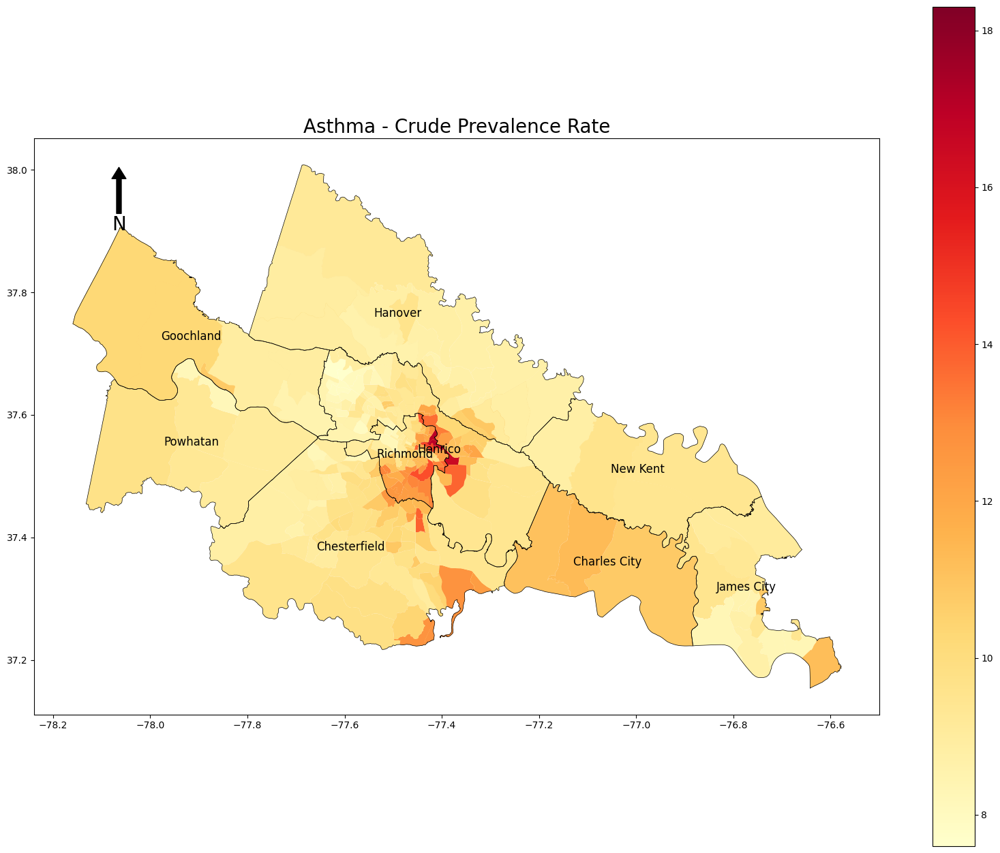

In [474]:
fig, ax = plt.subplots(figsize = (20,16)) 

# PLot the main map
gdf_asthma_subset.plot(column='Data_Value',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 

# Plot the county boundaries
gdf_County_RVA.plot(color='none', edgecolor='k', linewidth=0.5, ax=ax)  # Ensure 'color' is 'none' to make the counties transparent

# Add Title and Labels
ax.set_title('Asthma - Crude Prevalence Rate', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
map_name = 'asthma_High_Confidence_Limit.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [475]:
df_acs2021_var14 = gdf_asthma_subset

### Useable Variables

1. 'Current asthma among adults aged >=18 years'
2. 'Diagnosed diabetes among adults aged >=18 years'
3. 'High blood pressure among adults aged >=18 years'
4. 'Current lack of health insurance among adults aged 18-64 years'
5. 'Cancer (excluding skin cancer) among adults aged >=18 years'
6. 'Obesity among adults aged >=18 years'
7. 'Coronary heart disease among adults aged >=18 years'
8. 'Stroke among adults aged >=18 years'
9. 'Mental health not good for >=14 days among adults aged >=18 years'
10. 'Chronic obstructive pulmonary disease among adults aged >=18 years'

In [476]:
df['Year'].unique()

array([2020, 2019], dtype=int64)

In [477]:
df_diabetes=df[df['Measure']=='Diagnosed diabetes among adults aged >=18 years']

In [478]:
df_asthma = df_diabetes 

In [479]:
df_asthma.shape

(1876, 23)

In [480]:
df_asthma.shape

(1876, 23)

In [481]:
df_asthma['Year'].unique()

array([2020], dtype=int64)

In [482]:
df_asthma['CountyFIPS'].unique()

array([51153, 51013, 51019, 51005, 51059, 51041, 51003, 51015, 51009,
       51027, 51029, 51025, 51021, 51033, 51001, 51043, 51035, 51031,
       51023, 51057, 51047, 51053, 51036, 51011, 51049, 51051, 51007,
       51017, 51037, 51045, 51149, 51107, 51141, 51073, 51119, 51101,
       51089, 51111, 51147, 51087, 51061, 51121, 51069, 51131, 51143,
       51117, 51125, 51105, 51067, 51085, 51079, 51115, 51099, 51093,
       51113, 51145, 51063, 51095, 51083, 51135, 51077, 51109, 51133,
       51137, 51075, 51065, 51155, 51139, 51103, 51097, 51081, 51127,
       51071, 51091, 51690, 51167, 51700, 51550, 51710, 51175, 51173,
       51179, 51183, 51540, 51680, 51510, 51670, 51161, 51650, 51177,
       51610, 51197, 51185, 51660, 51600, 51199, 51195, 51165, 51171,
       51187, 51595, 51683, 51191, 51163, 51169, 51520, 51570, 51159,
       51630, 51181, 51157, 51590, 51685, 51620, 51678, 51193, 51640,
       51580, 51530, 51810, 51740, 51770, 51760, 51820, 51800, 51790,
       51735, 51730,

In [483]:
len(df_asthma[df_asthma['CountyFIPS']==51760].sort_values(by='LocationName', ascending=True))

66

In [484]:
df_asthma.columns

Index(['Year', 'StateAbbr', 'StateDesc', 'CountyName', 'CountyFIPS',
       'LocationName', 'DataSource', 'Category', 'Measure', 'Data_Value_Unit',
       'Data_Value_Type', 'Data_Value', 'Data_Value_Footnote_Symbol',
       'Data_Value_Footnote', 'Low_Confidence_Limit', 'High_Confidence_Limit',
       'TotalPopulation', 'Geolocation', 'LocationID', 'CategoryID',
       'MeasureId', 'DataValueTypeID', 'Short_Question_Text'],
      dtype='object')

In [485]:
df_asthma['GEOID'] = df_asthma['LocationName']

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4020978062.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['LocationName']


In [486]:
df_asthma.head()

,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,Low_Confidence_Limit,High_Confidence_Limit,TotalPopulation,Geolocation,LocationID,CategoryID,MeasureId,DataValueTypeID,Short_Question_Text,GEOID
1622742,2020,VA,Virginia,Prince William,51153,51153900409,BRFSS,Health Outcomes,Diagnosed diabetes among adults aged >=18 years,%,...,10.9,12.0,4634,POINT (-77.32357954 38.62815634),51153900409,HLTHOUT,DIABETES,CrdPrv,Diabetes,51153900409
2000108,2020,VA,Virginia,Arlington,51013,51013101702,BRFSS,Health Outcomes,Diagnosed diabetes among adults aged >=18 years,%,...,4.4,4.9,4965,POINT (-77.07399411 38.89281841),51013101702,HLTHOUT,DIABETES,CrdPrv,Diabetes,51013101702
2000126,2020,VA,Virginia,Bedford,51019,51019030300,BRFSS,Health Outcomes,Diagnosed diabetes among adults aged >=18 years,%,...,11.1,12.2,3739,POINT (-79.45415334 37.48032111),51019030300,HLTHOUT,DIABETES,CrdPrv,Diabetes,51019030300
2000130,2020,VA,Virginia,Arlington,51013,51013101900,BRFSS,Health Outcomes,Diagnosed diabetes among adults aged >=18 years,%,...,5.2,5.9,2755,POINT (-77.09797008 38.87793399),51013101900,HLTHOUT,DIABETES,CrdPrv,Diabetes,51013101900
2000145,2020,VA,Virginia,Alleghany,51005,51005080201,BRFSS,Health Outcomes,Diagnosed diabetes among adults aged >=18 years,%,...,11.3,12.8,2842,POINT (-79.92599899 37.85000837),51005080201,HLTHOUT,DIABETES,CrdPrv,Diabetes,51005080201


In [487]:
gdf_US_CT['GEOID'] = gdf_US_CT['GEOID'].astype(str)
df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4026371282.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)


In [488]:
import pandas as pd

# Load the crosswalk file
crosswalk_path = r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\crosswalk_CT10to20.txt"
# df_crosswalk = pd.read_csv(crosswalk_path, delimiter='\t', dtype=str)
df_crosswalk = pd.read_csv(crosswalk_path, delimiter='|', dtype=str)
# Display the first few rows of the crosswalk DataFrame
print(df_crosswalk.head())


     OID_TRACT_20 GEOID_TRACT_20 NAMELSAD_TRACT_20 AREALAND_TRACT_20  \
0  20790540092527    01001020100  Census Tract 201           9825304   
1  20790540092527    01001020100  Census Tract 201           9825304   
2  20790540092534    01001020200  Census Tract 202           3320818   
3  20790540092528    01001020300  Census Tract 203           5349271   
4  20790540092529    01001020400  Census Tract 204           6384282   

  AREAWATER_TRACT_20 MTFCC_TRACT_20 FUNCSTAT_TRACT_20    OID_TRACT_10  \
0              28435          G5020                 S  20740540092527   
1              28435          G5020                 S  20740540092534   
2               5669          G5020                 S  20740540092534   
3               9054          G5020                 S  20740540092528   
4               8408          G5020                 S  20740540092529   

  GEOID_TRACT_10 NAMELSAD_TRACT_10 AREALAND_TRACT_10 AREAWATER_TRACT_10  \
0    01001020100  Census Tract 201           9827271 

In [489]:
# Ensure 'GEOID_2016' is a string for merging
df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\3898980032.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)


In [490]:
df_2016_merged = pd.merge(df_asthma, df_crosswalk, on='GEOID_TRACT_10', how='inner')

df_2016_merged.head()


,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,MTFCC_TRACT_20,FUNCSTAT_TRACT_20,OID_TRACT_10,NAMELSAD_TRACT_10,AREALAND_TRACT_10,AREAWATER_TRACT_10,MTFCC_TRACT_10,FUNCSTAT_TRACT_10,AREALAND_PART,AREAWATER_PART
0,2020,VA,Virginia,Prince William,51153,51153900409,BRFSS,Health Outcomes,Diagnosed diabetes among adults aged >=18 years,%,...,G5020,S,207403716692735,Census Tract 9004.09,2086522,0,G5020,S,2086522,0
1,2020,VA,Virginia,Arlington,51013,51013101702,BRFSS,Health Outcomes,Diagnosed diabetes among adults aged >=18 years,%,...,G5020,S,207403710714772,Census Tract 1017.02,382463,0,G5020,S,99908,0
2,2020,VA,Virginia,Arlington,51013,51013101702,BRFSS,Health Outcomes,Diagnosed diabetes among adults aged >=18 years,%,...,G5020,S,207403710714772,Census Tract 1017.02,382463,0,G5020,S,282555,0
3,2020,VA,Virginia,Bedford,51019,51019030300,BRFSS,Health Outcomes,Diagnosed diabetes among adults aged >=18 years,%,...,G5020,S,207401025857449,Census Tract 303,337173831,1568719,G5020,S,337168402,1568719
4,2020,VA,Virginia,Bedford,51019,51019030300,BRFSS,Health Outcomes,Diagnosed diabetes among adults aged >=18 years,%,...,G5020,S,207401025857449,Census Tract 303,337173831,1568719,G5020,S,900,0


In [491]:
df_2016_converted = df_2016_merged[['GEOID_TRACT_20', 'Data_Value']]

In [492]:
df_2016_converted.head()

,GEOID_TRACT_20,Data_Value
0,51153900409,11.4
1,51013101704,4.6
2,51013101705,4.6
3,51019030300,11.7
4,51019030401,11.7


In [493]:
df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\769660856.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)


In [494]:
df_asthma = df_2016_converted

In [495]:
gdf_asthma = pd.merge(gdf_US_CT,df_asthma, on = 'GEOID', how = 'outer')

In [496]:
gdf_asthma.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,GEOID_TRACT_20,Data_Value
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534.0,2927606.0,+37.8856871,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",51085320100,10.6
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,14.1
2,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,10.3
3,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,13.1
4,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,9.3


In [497]:
# List of desired COUNTYFP values
countyfp_values = ['036', '041', '075', '085', '087', '127', '145', '760', '095']

# Filter the dataframe
gdf_asthma_subset = gdf_asthma[gdf_asthma['COUNTYFP'].isin(countyfp_values)]

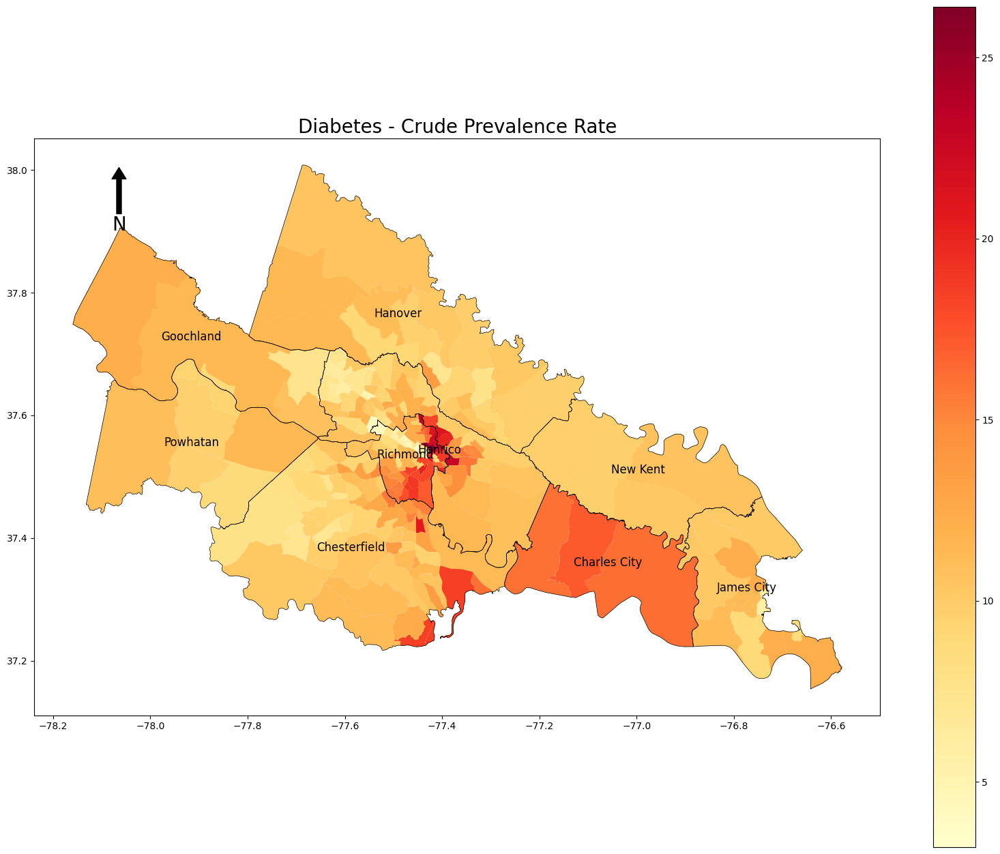

In [498]:
import matplotlib.pyplot as plt
import os

# Check and align CRS
if gdf_County_RVA.crs != gdf_asthma_subset.crs:
    gdf_County_RVA = gdf_County_RVA.to_crs(gdf_asthma_subset.crs)

# Create the plot
fig, ax = plt.subplots(figsize=(20, 16))

# Plot the choropleth map
gdf_asthma_subset.plot(column='Data_Value', cmap='YlOrRd', ax=ax, legend=True)

# Plot the county boundaries
gdf_County_RVA.plot(color='none', edgecolor='k', linewidth=0.5, ax=ax)  # Ensure 'color' is 'none' to make the counties transparent

# Add Title and Labels
ax.set_title('Diabetes - Crude Prevalence Rate', fontsize=20)

# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
save_dir = '.'  # Define save directory
map_name = 'diabetes_High_Confidence_Limit.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()


In [499]:
gdf_diabetes = gdf_asthma_subset

In [500]:
df_acs2021_var15 = gdf_diabetes

### Useable Variables

1. 'Current asthma among adults aged >=18 years'
2. 'Diagnosed diabetes among adults aged >=18 years'
3. 'High blood pressure among adults aged >=18 years'
4. 'Current lack of health insurance among adults aged 18-64 years'
5. 'Cancer (excluding skin cancer) among adults aged >=18 years'
6. 'Obesity among adults aged >=18 years'
7. 'Coronary heart disease among adults aged >=18 years'
8. 'Stroke among adults aged >=18 years'
9. 'Mental health not good for >=14 days among adults aged >=18 years'
10. 'Chronic obstructive pulmonary disease among adults aged >=18 years'

In [501]:
df['Year'].unique()

array([2020, 2019], dtype=int64)

In [502]:
df_HBP=df[df['Measure']=='High blood pressure among adults aged >=18 years']

In [503]:
df_asthma = df_HBP

In [504]:
df_asthma.shape

(1876, 23)

In [505]:
df_asthma.shape

(1876, 23)

In [506]:
df_asthma['Year'].unique()

array([2019], dtype=int64)

In [507]:
df_asthma['CountyFIPS'].unique()

array([51035, 51059, 51027, 51003, 51013, 51057, 51041, 51001, 51019,
       51025, 51021, 51029, 51005, 51009, 51015, 51043, 51033, 51031,
       51023, 51045, 51053, 51049, 51017, 51011, 51037, 51047, 51051,
       51036, 51007, 51069, 51083, 51085, 51121, 51081, 51109, 51061,
       51107, 51127, 51143, 51087, 51075, 51153, 51089, 51099, 51105,
       51079, 51117, 51101, 51135, 51141, 51115, 51077, 51145, 51065,
       51067, 51095, 51147, 51149, 51113, 51063, 51133, 51073, 51137,
       51155, 51103, 51093, 51119, 51125, 51091, 51139, 51097, 51071,
       51131, 51111, 51165, 51177, 51179, 51195, 51710, 51700, 51610,
       51199, 51650, 51630, 51540, 51550, 51570, 51510, 51191, 51185,
       51181, 51193, 51670, 51167, 51680, 51169, 51520, 51600, 51580,
       51173, 51683, 51161, 51690, 51197, 51183, 51175, 51660, 51157,
       51595, 51187, 51159, 51163, 51620, 51590, 51530, 51171, 51685,
       51640, 51678, 51770, 51760, 51740, 51810, 51800, 51720, 51820,
       51730, 51790,

In [508]:
len(df_asthma[df_asthma['CountyFIPS']==51760].sort_values(by='LocationName', ascending=True))

66

In [509]:
df_asthma.columns

Index(['Year', 'StateAbbr', 'StateDesc', 'CountyName', 'CountyFIPS',
       'LocationName', 'DataSource', 'Category', 'Measure', 'Data_Value_Unit',
       'Data_Value_Type', 'Data_Value', 'Data_Value_Footnote_Symbol',
       'Data_Value_Footnote', 'Low_Confidence_Limit', 'High_Confidence_Limit',
       'TotalPopulation', 'Geolocation', 'LocationID', 'CategoryID',
       'MeasureId', 'DataValueTypeID', 'Short_Question_Text'],
      dtype='object')

In [510]:
df_asthma['GEOID'] = df_asthma['LocationName']

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4020978062.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['LocationName']


In [511]:
df_asthma.head()

,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,Low_Confidence_Limit,High_Confidence_Limit,TotalPopulation,Geolocation,LocationID,CategoryID,MeasureId,DataValueTypeID,Short_Question_Text,GEOID
2000041,2019,VA,Virginia,Carroll,51035,51035080500,BRFSS,Health Outcomes,High blood pressure among adults aged >=18 years,%,...,40.8,42.6,4767,POINT (-80.5886884 36.73216479),51035080500,HLTHOUT,BPHIGH,CrdPrv,High Blood Pressure,51035080500
2000140,2019,VA,Virginia,Fairfax,51059,51059422403,BRFSS,Health Outcomes,High blood pressure among adults aged >=18 years,%,...,28.0,29.6,2695,POINT (-77.12279517 38.76996779),51059422403,HLTHOUT,BPHIGH,CrdPrv,High Blood Pressure,51059422403
2000153,2019,VA,Virginia,Buchanan,51027,51027010100,BRFSS,Health Outcomes,High blood pressure among adults aged >=18 years,%,...,40.9,43.3,5163,POINT (-82.02674711 37.35045817),51027010100,HLTHOUT,BPHIGH,CrdPrv,High Blood Pressure,51027010100
2000221,2019,VA,Virginia,Albemarle,51003,51003010202,BRFSS,Health Outcomes,High blood pressure among adults aged >=18 years,%,...,31.4,33.9,3077,POINT (-78.5118574 38.12235546),51003010202,HLTHOUT,BPHIGH,CrdPrv,High Blood Pressure,51003010202
2000248,2019,VA,Virginia,Arlington,51013,51013102003,BRFSS,Health Outcomes,High blood pressure among adults aged >=18 years,%,...,26.5,28.5,4370,POINT (-77.10660486 38.87191858),51013102003,HLTHOUT,BPHIGH,CrdPrv,High Blood Pressure,51013102003


In [512]:
gdf_US_CT['GEOID'] = gdf_US_CT['GEOID'].astype(str)
df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4026371282.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)


In [513]:
import pandas as pd

# Load the crosswalk file
crosswalk_path = r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\crosswalk_CT10to20.txt"
# df_crosswalk = pd.read_csv(crosswalk_path, delimiter='\t', dtype=str)
df_crosswalk = pd.read_csv(crosswalk_path, delimiter='|', dtype=str)
# Display the first few rows of the crosswalk DataFrame
print(df_crosswalk.head())


     OID_TRACT_20 GEOID_TRACT_20 NAMELSAD_TRACT_20 AREALAND_TRACT_20  \
0  20790540092527    01001020100  Census Tract 201           9825304   
1  20790540092527    01001020100  Census Tract 201           9825304   
2  20790540092534    01001020200  Census Tract 202           3320818   
3  20790540092528    01001020300  Census Tract 203           5349271   
4  20790540092529    01001020400  Census Tract 204           6384282   

  AREAWATER_TRACT_20 MTFCC_TRACT_20 FUNCSTAT_TRACT_20    OID_TRACT_10  \
0              28435          G5020                 S  20740540092527   
1              28435          G5020                 S  20740540092534   
2               5669          G5020                 S  20740540092534   
3               9054          G5020                 S  20740540092528   
4               8408          G5020                 S  20740540092529   

  GEOID_TRACT_10 NAMELSAD_TRACT_10 AREALAND_TRACT_10 AREAWATER_TRACT_10  \
0    01001020100  Census Tract 201           9827271 

In [514]:
# Ensure 'GEOID_2016' is a string for merging
df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\3898980032.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)


In [515]:
df_2016_merged = pd.merge(df_asthma, df_crosswalk, on='GEOID_TRACT_10', how='inner')

df_2016_merged.head()


,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,MTFCC_TRACT_20,FUNCSTAT_TRACT_20,OID_TRACT_10,NAMELSAD_TRACT_10,AREALAND_TRACT_10,AREAWATER_TRACT_10,MTFCC_TRACT_10,FUNCSTAT_TRACT_10,AREALAND_PART,AREAWATER_PART
0,2019,VA,Virginia,Carroll,51035,51035080500,BRFSS,Health Outcomes,High blood pressure among adults aged >=18 years,%,...,G5020,S,20740347126835,Census Tract 805,316593004,1323504,G5020,S,232908112,1074874
1,2019,VA,Virginia,Carroll,51035,51035080500,BRFSS,Health Outcomes,High blood pressure among adults aged >=18 years,%,...,G5020,S,20740347126835,Census Tract 805,316593004,1323504,G5020,S,83684892,248630
2,2019,VA,Virginia,Fairfax,51059,51059422403,BRFSS,Health Outcomes,High blood pressure among adults aged >=18 years,%,...,G5020,S,207403714715801,Census Tract 4224.03,2184365,38697,G5020,S,5354,0
3,2019,VA,Virginia,Fairfax,51059,51059422403,BRFSS,Health Outcomes,High blood pressure among adults aged >=18 years,%,...,G5020,S,207403714715801,Census Tract 4224.03,2184365,38697,G5020,S,2179011,38697
4,2019,VA,Virginia,Buchanan,51027,51027010100,BRFSS,Health Outcomes,High blood pressure among adults aged >=18 years,%,...,G5020,S,20740763779598,Census Tract 101,233474425,421754,G5020,S,233470045,421754


In [516]:
df_2016_converted = df_2016_merged[['GEOID_TRACT_20', 'Data_Value']]

In [517]:
df_2016_converted.head()

,GEOID_TRACT_20,Data_Value
0,51035080501,41.7
1,51035080502,41.7
2,51059422301,28.7
3,51059422403,28.7
4,51027010100,42.1


In [518]:
df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\769660856.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)


In [519]:
df_asthma = df_2016_converted

In [520]:
gdf_asthma = pd.merge(gdf_US_CT,df_asthma, on = 'GEOID', how = 'outer')

In [521]:
gdf_asthma.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,GEOID_TRACT_20,Data_Value
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534.0,2927606.0,+37.8856871,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",51085320100,36.1
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,41.1
2,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,35.1
3,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,39.1
4,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,32.0


In [522]:
# List of desired COUNTYFP values
countyfp_values = ['036', '041', '075', '085', '087', '127', '145', '760', '095']

# Filter the dataframe
gdf_asthma_subset = gdf_asthma[gdf_asthma['COUNTYFP'].isin(countyfp_values)]

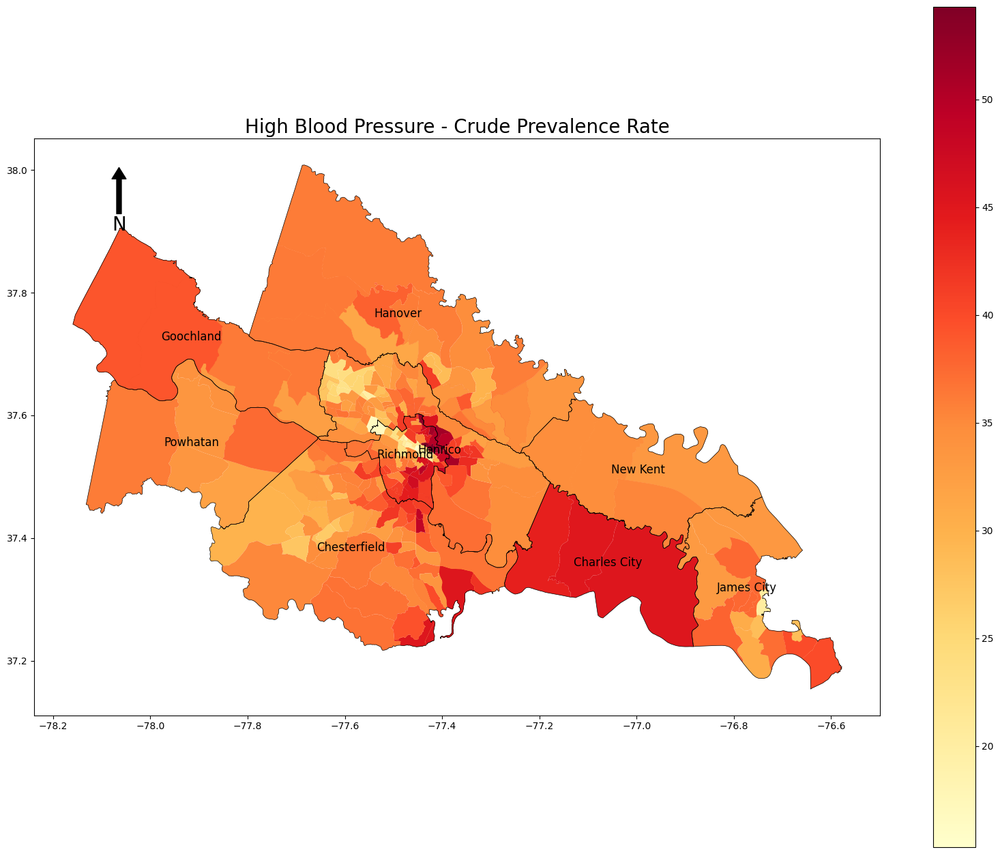

In [523]:
import matplotlib.pyplot as plt
import os

# Check and align CRS
if gdf_County_RVA.crs != gdf_asthma_subset.crs:
    gdf_County_RVA = gdf_County_RVA.to_crs(gdf_asthma_subset.crs)

# Create the plot
fig, ax = plt.subplots(figsize=(20, 16))

# Plot the choropleth map
gdf_asthma_subset.plot(column='Data_Value', cmap='YlOrRd', ax=ax, legend=True)

# Plot the county boundaries
gdf_County_RVA.plot(color='none', edgecolor='k', linewidth=0.5, ax=ax)  # Ensure 'color' is 'none' to make the counties transparent

# Add Title and Labels
ax.set_title('High Blood Pressure - Crude Prevalence Rate', fontsize=20)

# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
save_dir = '.'  # Define save directory
map_name = 'HBP_High_Confidence_Limit.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()


In [524]:
gdf_HBP = gdf_asthma_subset

In [525]:
df_acs2021_var16 = gdf_HBP

### Useable Variables

1. 'Current asthma among adults aged >=18 years'
2. 'Diagnosed diabetes among adults aged >=18 years'
3. 'High blood pressure among adults aged >=18 years'
4. 'Current lack of health insurance among adults aged 18-64 years'
5. 'Cancer (excluding skin cancer) among adults aged >=18 years'
6. 'Obesity among adults aged >=18 years'
7. 'Coronary heart disease among adults aged >=18 years'
8. 'Stroke among adults aged >=18 years'
9. 'Mental health not good for >=14 days among adults aged >=18 years'
10. 'Chronic obstructive pulmonary disease among adults aged >=18 years'

In [526]:
df['Year'].unique()

array([2020, 2019], dtype=int64)

In [527]:
df_Canc=df[df['Measure']=='Cancer (excluding skin cancer) among adults aged >=18 years']

In [528]:
df_asthma = df_Canc

In [529]:
df_asthma.shape

(1876, 23)

In [530]:
df_asthma.shape

(1876, 23)

In [531]:
df_asthma['Year'].unique()

array([2020], dtype=int64)

In [532]:
df_asthma['CountyFIPS'].unique()

array([51087, 51041, 51059, 51013, 51027, 51001, 51003, 51035, 51019,
       51005, 51047, 51036, 51009, 51025, 51021, 51053, 51031, 51015,
       51033, 51057, 51029, 51043, 51011, 51023, 51051, 51037, 51007,
       51045, 51017, 51049, 51153, 51107, 51069, 51111, 51089, 51077,
       51097, 51061, 51079, 51105, 51095, 51143, 51085, 51117, 51145,
       51099, 51149, 51121, 51083, 51133, 51141, 51067, 51137, 51101,
       51135, 51073, 51139, 51081, 51071, 51075, 51147, 51113, 51109,
       51065, 51155, 51119, 51093, 51127, 51115, 51103, 51131, 51063,
       51125, 51091, 51193, 51570, 51510, 51159, 51650, 51670, 51690,
       51177, 51199, 51161, 51191, 51710, 51550, 51171, 51179, 51165,
       51540, 51700, 51185, 51195, 51169, 51600, 51630, 51590, 51183,
       51680, 51167, 51520, 51580, 51175, 51530, 51197, 51157, 51173,
       51187, 51683, 51163, 51660, 51181, 51595, 51610, 51685, 51678,
       51620, 51640, 51810, 51800, 51760, 51740, 51820, 51735, 51750,
       51770, 51730,

In [533]:
len(df_asthma[df_asthma['CountyFIPS']==51760].sort_values(by='LocationName', ascending=True))

66

In [534]:
df_asthma.columns

Index(['Year', 'StateAbbr', 'StateDesc', 'CountyName', 'CountyFIPS',
       'LocationName', 'DataSource', 'Category', 'Measure', 'Data_Value_Unit',
       'Data_Value_Type', 'Data_Value', 'Data_Value_Footnote_Symbol',
       'Data_Value_Footnote', 'Low_Confidence_Limit', 'High_Confidence_Limit',
       'TotalPopulation', 'Geolocation', 'LocationID', 'CategoryID',
       'MeasureId', 'DataValueTypeID', 'Short_Question_Text'],
      dtype='object')

In [535]:
df_asthma['GEOID'] = df_asthma['LocationName']

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4020978062.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['LocationName']


In [536]:
df_asthma.head()

,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,Low_Confidence_Limit,High_Confidence_Limit,TotalPopulation,Geolocation,LocationID,CategoryID,MeasureId,DataValueTypeID,Short_Question_Text,GEOID
1622749,2020,VA,Virginia,Henrico,51087,51087200302,BRFSS,Health Outcomes,Cancer (excluding skin cancer) among adults ag...,%,...,6.0,6.7,3115,POINT (-77.51758409 37.58981841),51087200302,HLTHOUT,CANCER,CrdPrv,Cancer (except skin),51087200302
2000031,2020,VA,Virginia,Chesterfield,51041,51041100816,BRFSS,Health Outcomes,Cancer (excluding skin cancer) among adults ag...,%,...,5.1,5.6,4636,POINT (-77.47115417 37.38558674),51041100816,HLTHOUT,CANCER,CrdPrv,Cancer (except skin),51041100816
2000071,2020,VA,Virginia,Fairfax,51059,51059416100,BRFSS,Health Outcomes,Cancer (excluding skin cancer) among adults ag...,%,...,8.1,8.9,3734,POINT (-77.11440571 38.70934415),51059416100,HLTHOUT,CANCER,CrdPrv,Cancer (except skin),51059416100
2000078,2020,VA,Virginia,Arlington,51013,51013102100,BRFSS,Health Outcomes,Cancer (excluding skin cancer) among adults ag...,%,...,7.6,8.3,2266,POINT (-77.12473187 38.86359765),51013102100,HLTHOUT,CANCER,CrdPrv,Cancer (except skin),51013102100
2000112,2020,VA,Virginia,Fairfax,51059,51059415300,BRFSS,Health Outcomes,Cancer (excluding skin cancer) among adults ag...,%,...,5.9,6.4,3763,POINT (-77.0699354 38.76683047),51059415300,HLTHOUT,CANCER,CrdPrv,Cancer (except skin),51059415300


In [537]:
gdf_US_CT['GEOID'] = gdf_US_CT['GEOID'].astype(str)
df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4026371282.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)


In [538]:
import pandas as pd

# Load the crosswalk file
crosswalk_path = r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\crosswalk_CT10to20.txt"
# df_crosswalk = pd.read_csv(crosswalk_path, delimiter='\t', dtype=str)
df_crosswalk = pd.read_csv(crosswalk_path, delimiter='|', dtype=str)
# Display the first few rows of the crosswalk DataFrame
print(df_crosswalk.head())


     OID_TRACT_20 GEOID_TRACT_20 NAMELSAD_TRACT_20 AREALAND_TRACT_20  \
0  20790540092527    01001020100  Census Tract 201           9825304   
1  20790540092527    01001020100  Census Tract 201           9825304   
2  20790540092534    01001020200  Census Tract 202           3320818   
3  20790540092528    01001020300  Census Tract 203           5349271   
4  20790540092529    01001020400  Census Tract 204           6384282   

  AREAWATER_TRACT_20 MTFCC_TRACT_20 FUNCSTAT_TRACT_20    OID_TRACT_10  \
0              28435          G5020                 S  20740540092527   
1              28435          G5020                 S  20740540092534   
2               5669          G5020                 S  20740540092534   
3               9054          G5020                 S  20740540092528   
4               8408          G5020                 S  20740540092529   

  GEOID_TRACT_10 NAMELSAD_TRACT_10 AREALAND_TRACT_10 AREAWATER_TRACT_10  \
0    01001020100  Census Tract 201           9827271 

In [539]:
# Ensure 'GEOID_2016' is a string for merging
df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\3898980032.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)


In [540]:
df_2016_merged = pd.merge(df_asthma, df_crosswalk, on='GEOID_TRACT_10', how='inner')

df_2016_merged.head()


,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,MTFCC_TRACT_20,FUNCSTAT_TRACT_20,OID_TRACT_10,NAMELSAD_TRACT_10,AREALAND_TRACT_10,AREAWATER_TRACT_10,MTFCC_TRACT_10,FUNCSTAT_TRACT_10,AREALAND_PART,AREAWATER_PART
0,2020,VA,Virginia,Henrico,51087,51087200302,BRFSS,Health Outcomes,Cancer (excluding skin cancer) among adults ag...,%,...,G5020,S,20740226602402,Census Tract 2003.02,2441640,6199,G5020,S,2441640,6199
1,2020,VA,Virginia,Chesterfield,51041,51041100816,BRFSS,Health Outcomes,Cancer (excluding skin cancer) among adults ag...,%,...,G5020,S,20740355748280,Census Tract 1008.16,4328452,33784,G5020,S,4328452,33784
2,2020,VA,Virginia,Fairfax,51059,51059416100,BRFSS,Health Outcomes,Cancer (excluding skin cancer) among adults ag...,%,...,G5020,S,20740241118385,Census Tract 4161,5502308,1896018,G5020,S,5502308,1891463
3,2020,VA,Virginia,Fairfax,51059,51059416100,BRFSS,Health Outcomes,Cancer (excluding skin cancer) among adults ag...,%,...,G5020,S,20740241118385,Census Tract 4161,5502308,1896018,G5020,S,0,4555
4,2020,VA,Virginia,Arlington,51013,51013102100,BRFSS,Health Outcomes,Cancer (excluding skin cancer) among adults ag...,%,...,G5020,S,20740343189396,Census Tract 1021,1155864,0,G5020,S,4386,0


In [541]:
df_2016_converted = df_2016_merged[['GEOID_TRACT_20', 'Data_Value']]

In [542]:
df_2016_converted.head()

,GEOID_TRACT_20,Data_Value
0,51087200302,6.3
1,51041100816,5.4
2,51059416100,8.5
3,51059416200,8.5
4,51013101200,7.9


In [543]:
df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\769660856.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)


In [544]:
df_asthma = df_2016_converted

In [545]:
gdf_asthma = pd.merge(gdf_US_CT,df_asthma, on = 'GEOID', how = 'outer')

In [546]:
gdf_asthma.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,GEOID_TRACT_20,Data_Value
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534.0,2927606.0,+37.8856871,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",51085320100,7.0
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,6.6
2,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,6.7
3,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,5.1
4,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,5.3


In [547]:
# List of desired COUNTYFP values
countyfp_values = ['036', '041', '075', '085', '087', '127', '145', '760', '095']

# Filter the dataframe
gdf_asthma_subset = gdf_asthma[gdf_asthma['COUNTYFP'].isin(countyfp_values)]

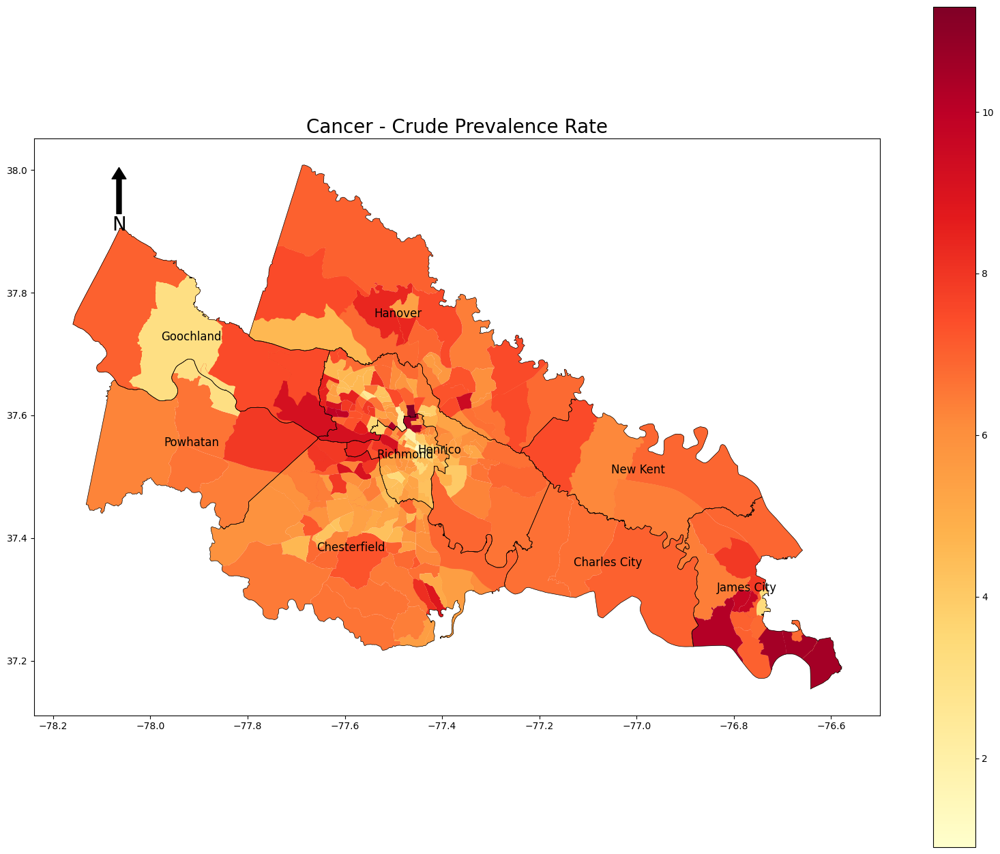

In [548]:
import matplotlib.pyplot as plt
import os

# Check and align CRS
if gdf_County_RVA.crs != gdf_asthma_subset.crs:
    gdf_County_RVA = gdf_County_RVA.to_crs(gdf_asthma_subset.crs)

# Create the plot
fig, ax = plt.subplots(figsize=(20, 16))

# Plot the choropleth map
gdf_asthma_subset.plot(column='Data_Value', cmap='YlOrRd', ax=ax, legend=True)

# Plot the county boundaries
gdf_County_RVA.plot(color='none', edgecolor='k', linewidth=0.5, ax=ax)  # Ensure 'color' is 'none' to make the counties transparent

# Add Title and Labels
ax.set_title('Cancer - Crude Prevalence Rate', fontsize=20)

# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
save_dir = '.'  # Define save directory
map_name = 'cancer_High_Confidence_Limit.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()


In [549]:
gdf_Canc = gdf_asthma_subset

In [550]:
df_acs2021_var17 = gdf_Canc

### Useable Variables

1. 'Current asthma among adults aged >=18 years'
2. 'Diagnosed diabetes among adults aged >=18 years'
3. 'High blood pressure among adults aged >=18 years'
4. 'Current lack of health insurance among adults aged 18-64 years'
5. 'Cancer (excluding skin cancer) among adults aged >=18 years'
6. 'Obesity among adults aged >=18 years'
7. 'Coronary heart disease among adults aged >=18 years'
8. 'Stroke among adults aged >=18 years'
9. 'Mental health not good for >=14 days among adults aged >=18 years'
10. 'Chronic obstructive pulmonary disease among adults aged >=18 years'

In [551]:
df['Year'].unique()

array([2020, 2019], dtype=int64)

In [552]:
df_Obesity=df[df['Measure']=='Obesity among adults aged >=18 years']

In [553]:
df_asthma = df_Obesity

In [554]:
df_asthma.shape

(1876, 23)

In [555]:
df_asthma.shape

(1876, 23)

In [556]:
df_asthma['Year'].unique()

array([2020], dtype=int64)

In [557]:
df_asthma['CountyFIPS'].unique()

array([51153, 51009, 51059, 51047, 51003, 51035, 51015, 51013, 51041,
       51057, 51025, 51019, 51027, 51029, 51036, 51051, 51023, 51007,
       51053, 51001, 51037, 51031, 51005, 51011, 51049, 51033, 51043,
       51021, 51087, 51017, 51045, 51640, 51077, 51141, 51085, 51061,
       51093, 51095, 51121, 51099, 51145, 51111, 51069, 51107, 51117,
       51101, 51143, 51133, 51127, 51119, 51089, 51147, 51105, 51109,
       51067, 51073, 51083, 51125, 51065, 51139, 51097, 51079, 51135,
       51063, 51155, 51131, 51071, 51075, 51137, 51149, 51103, 51081,
       51113, 51091, 51115, 51710, 51169, 51700, 51187, 51510, 51580,
       51179, 51161, 51595, 51570, 51550, 51680, 51191, 51171, 51177,
       51193, 51165, 51650, 51540, 51670, 51683, 51173, 51660, 51175,
       51590, 51197, 51195, 51199, 51185, 51678, 51690, 51167, 51685,
       51600, 51183, 51163, 51520, 51610, 51620, 51630, 51181, 51159,
       51157, 51530, 51800, 51760, 51810, 51740, 51840, 51770, 51790,
       51735, 51775,

In [558]:
len(df_asthma[df_asthma['CountyFIPS']==51760].sort_values(by='LocationName', ascending=True))

66

In [559]:
df_asthma.columns

Index(['Year', 'StateAbbr', 'StateDesc', 'CountyName', 'CountyFIPS',
       'LocationName', 'DataSource', 'Category', 'Measure', 'Data_Value_Unit',
       'Data_Value_Type', 'Data_Value', 'Data_Value_Footnote_Symbol',
       'Data_Value_Footnote', 'Low_Confidence_Limit', 'High_Confidence_Limit',
       'TotalPopulation', 'Geolocation', 'LocationID', 'CategoryID',
       'MeasureId', 'DataValueTypeID', 'Short_Question_Text'],
      dtype='object')

In [560]:
df_asthma['GEOID'] = df_asthma['LocationName']

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4020978062.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['LocationName']


In [561]:
df_asthma.head()

,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,Low_Confidence_Limit,High_Confidence_Limit,TotalPopulation,Geolocation,LocationID,CategoryID,MeasureId,DataValueTypeID,Short_Question_Text,GEOID
1622752,2020,VA,Virginia,Prince William,51153,51153901229,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,...,35.2,37.5,3888,POINT (-77.38157193 38.65151257),51153901229,HLTHOUT,OBESITY,CrdPrv,Obesity,51153901229
2000049,2020,VA,Virginia,Amherst,51009,51009010401,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,...,35.1,37.0,3375,POINT (-79.09134424 37.50204912),51009010401,HLTHOUT,OBESITY,CrdPrv,Obesity,51009010401
2000055,2020,VA,Virginia,Fairfax,51059,51059480203,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,...,18.7,20.4,2054,POINT (-77.23544376 38.92756268),51059480203,HLTHOUT,OBESITY,CrdPrv,Obesity,51059480203
2000063,2020,VA,Virginia,Culpeper,51047,51047930202,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,...,37.3,39.6,5820,POINT (-78.11197556 38.51815056),51047930202,HLTHOUT,OBESITY,CrdPrv,Obesity,51047930202
2000087,2020,VA,Virginia,Fairfax,51059,51059471201,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,...,18.7,20.3,3164,POINT (-77.21376986 38.91742756),51059471201,HLTHOUT,OBESITY,CrdPrv,Obesity,51059471201


In [562]:
gdf_US_CT['GEOID'] = gdf_US_CT['GEOID'].astype(str)
df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4026371282.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)


In [563]:
import pandas as pd

# Load the crosswalk file
crosswalk_path = r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\crosswalk_CT10to20.txt"
# df_crosswalk = pd.read_csv(crosswalk_path, delimiter='\t', dtype=str)
df_crosswalk = pd.read_csv(crosswalk_path, delimiter='|', dtype=str)
# Display the first few rows of the crosswalk DataFrame
print(df_crosswalk.head())


     OID_TRACT_20 GEOID_TRACT_20 NAMELSAD_TRACT_20 AREALAND_TRACT_20  \
0  20790540092527    01001020100  Census Tract 201           9825304   
1  20790540092527    01001020100  Census Tract 201           9825304   
2  20790540092534    01001020200  Census Tract 202           3320818   
3  20790540092528    01001020300  Census Tract 203           5349271   
4  20790540092529    01001020400  Census Tract 204           6384282   

  AREAWATER_TRACT_20 MTFCC_TRACT_20 FUNCSTAT_TRACT_20    OID_TRACT_10  \
0              28435          G5020                 S  20740540092527   
1              28435          G5020                 S  20740540092534   
2               5669          G5020                 S  20740540092534   
3               9054          G5020                 S  20740540092528   
4               8408          G5020                 S  20740540092529   

  GEOID_TRACT_10 NAMELSAD_TRACT_10 AREALAND_TRACT_10 AREAWATER_TRACT_10  \
0    01001020100  Census Tract 201           9827271 

In [564]:
# Ensure 'GEOID_2016' is a string for merging
df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\3898980032.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)


In [565]:
df_2016_merged = pd.merge(df_asthma, df_crosswalk, on='GEOID_TRACT_10', how='inner')

df_2016_merged.head()


,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,MTFCC_TRACT_20,FUNCSTAT_TRACT_20,OID_TRACT_10,NAMELSAD_TRACT_10,AREALAND_TRACT_10,AREAWATER_TRACT_10,MTFCC_TRACT_10,FUNCSTAT_TRACT_10,AREALAND_PART,AREAWATER_PART
0,2020,VA,Virginia,Prince William,51153,51153901229,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,...,G5020,S,207403716693560,Census Tract 9012.29,2554838,241,G5020,S,2554838,241
1,2020,VA,Virginia,Amherst,51009,51009010401,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,...,G5020,S,20740744624938,Census Tract 104.01,31658976,99682,G5020,S,31658976,99682
2,2020,VA,Virginia,Fairfax,51059,51059480203,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,...,G5020,S,207403714715945,Census Tract 4802.03,372822,3133,G5020,S,372822,3133
3,2020,VA,Virginia,Culpeper,51047,51047930202,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,...,G5020,S,207403690794086,Census Tract 9302.02,145295164,1271946,G5020,S,145294726,1271946
4,2020,VA,Virginia,Culpeper,51047,51047930202,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,...,G5020,S,207403690794086,Census Tract 9302.02,145295164,1271946,G5020,S,438,0


In [566]:
df_2016_converted = df_2016_merged[['GEOID_TRACT_20', 'Data_Value']]

In [567]:
df_2016_converted.head()

,GEOID_TRACT_20,Data_Value
0,51153901229,36.4
1,51009010401,36.1
2,51059480203,19.5
3,51047930202,38.4
4,51113930202,38.4


In [568]:
df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\769660856.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)


In [569]:
df_asthma = df_2016_converted

In [570]:
gdf_asthma = pd.merge(gdf_US_CT,df_asthma, on = 'GEOID', how = 'outer')

In [571]:
gdf_asthma.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,GEOID_TRACT_20,Data_Value
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534.0,2927606.0,+37.8856871,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",51085320100,37.7
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,38.0
2,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,41.0
3,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,39.7
4,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,40.8


In [572]:
# List of desired COUNTYFP values
countyfp_values = ['036', '041', '075', '085', '087', '127', '145', '760', '095']

# Filter the dataframe
gdf_asthma_subset = gdf_asthma[gdf_asthma['COUNTYFP'].isin(countyfp_values)]

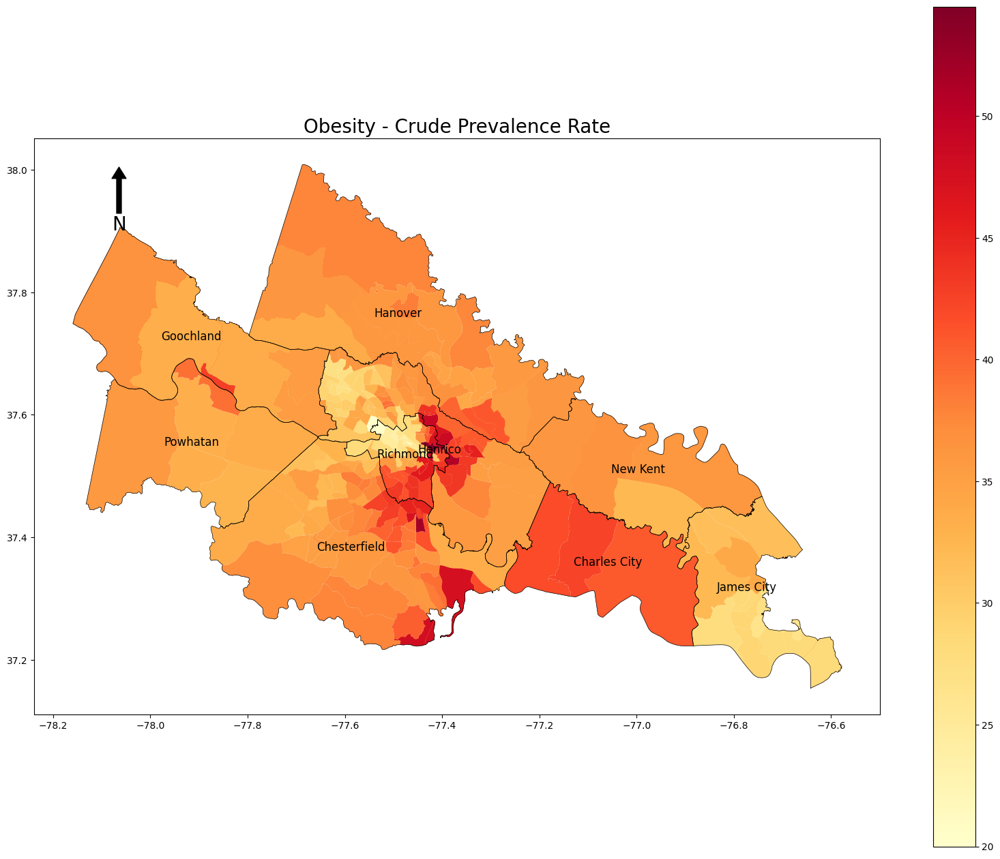

In [573]:
import matplotlib.pyplot as plt
import os

# Check and align CRS
if gdf_County_RVA.crs != gdf_asthma_subset.crs:
    gdf_County_RVA = gdf_County_RVA.to_crs(gdf_asthma_subset.crs)

# Create the plot
fig, ax = plt.subplots(figsize=(20, 16))

# Plot the choropleth map
gdf_asthma_subset.plot(column='Data_Value', cmap='YlOrRd', ax=ax, legend=True)

# Plot the county boundaries
gdf_County_RVA.plot(color='none', edgecolor='k', linewidth=0.5, ax=ax)  # Ensure 'color' is 'none' to make the counties transparent

# Add Title and Labels
ax.set_title('Obesity - Crude Prevalence Rate', fontsize=20)

# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
save_dir = '.'  # Define save directory
map_name = 'Obesity_High_Confidence_Limit.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()


In [574]:
gdf_Obesity = gdf_asthma_subset

In [575]:
df_acs2021_var18 = gdf_Obesity

### Useable Variables

1. 'Current asthma among adults aged >=18 years'
2. 'Diagnosed diabetes among adults aged >=18 years'
3. 'High blood pressure among adults aged >=18 years'
4. 'Current lack of health insurance among adults aged 18-64 years'
5. 'Cancer (excluding skin cancer) among adults aged >=18 years'
6. 'Obesity among adults aged >=18 years'
7. 'Coronary heart disease among adults aged >=18 years'
8. 'Stroke among adults aged >=18 years'
9. 'Mental health not good for >=14 days among adults aged >=18 years'
10. 'Chronic obstructive pulmonary disease among adults aged >=18 years'

In [576]:
df['Year'].unique()

array([2020, 2019], dtype=int64)

In [577]:
df_heart=df[df['Measure']=='Coronary heart disease among adults aged >=18 years']

In [578]:
df_asthma = df_heart

In [579]:
df_asthma.shape

(1876, 23)

In [580]:
df_asthma.shape

(1876, 23)

In [581]:
df_asthma['Year'].unique()

array([2020], dtype=int64)

In [582]:
df_asthma['CountyFIPS'].unique()

array([51059, 51053, 51041, 51023, 51031, 51015, 51003, 51013, 51007,
       51027, 51009, 51001, 51019, 51025, 51049, 51051, 51029, 51057,
       51047, 51037, 51036, 51005, 51035, 51011, 51033, 51021, 51043,
       51017, 51045, 51153, 51089, 51143, 51107, 51061, 51095, 51067,
       51093, 51139, 51087, 51073, 51149, 51109, 51155, 51085, 51081,
       51083, 51141, 51119, 51101, 51077, 51069, 51127, 51065, 51121,
       51105, 51145, 51075, 51117, 51063, 51115, 51125, 51079, 51097,
       51099, 51135, 51137, 51133, 51131, 51071, 51113, 51147, 51103,
       51111, 51091, 51710, 51177, 51191, 51650, 51171, 51590, 51179,
       51195, 51670, 51175, 51700, 51187, 51680, 51683, 51660, 51197,
       51510, 51167, 51550, 51163, 51165, 51169, 51595, 51181, 51185,
       51199, 51630, 51620, 51161, 51540, 51183, 51173, 51685, 51193,
       51690, 51600, 51520, 51159, 51570, 51530, 51610, 51640, 51580,
       51157, 51678, 51800, 51760, 51790, 51770, 51810, 51740, 51720,
       51730, 51735,

In [583]:
len(df_asthma[df_asthma['CountyFIPS']==51760].sort_values(by='LocationName', ascending=True))

66

In [584]:
df_asthma.columns

Index(['Year', 'StateAbbr', 'StateDesc', 'CountyName', 'CountyFIPS',
       'LocationName', 'DataSource', 'Category', 'Measure', 'Data_Value_Unit',
       'Data_Value_Type', 'Data_Value', 'Data_Value_Footnote_Symbol',
       'Data_Value_Footnote', 'Low_Confidence_Limit', 'High_Confidence_Limit',
       'TotalPopulation', 'Geolocation', 'LocationID', 'CategoryID',
       'MeasureId', 'DataValueTypeID', 'Short_Question_Text'],
      dtype='object')

In [585]:
df_asthma['GEOID'] = df_asthma['LocationName']

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4020978062.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['LocationName']


In [586]:
df_asthma.head()

,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,Low_Confidence_Limit,High_Confidence_Limit,TotalPopulation,Geolocation,LocationID,CategoryID,MeasureId,DataValueTypeID,Short_Question_Text,GEOID
2000033,2020,VA,Virginia,Fairfax,51059,51059451601,BRFSS,Health Outcomes,Coronary heart disease among adults aged >=18 ...,%,...,3.8,4.5,6047,POINT (-77.13897812 38.85027183),51059451601,HLTHOUT,CHD,CrdPrv,Coronary Heart Disease,51059451601
2000050,2020,VA,Virginia,Fairfax,51059,51059450702,BRFSS,Health Outcomes,Coronary heart disease among adults aged >=18 ...,%,...,3.9,4.5,4399,POINT (-77.20341412 38.83710525),51059450702,HLTHOUT,CHD,CrdPrv,Coronary Heart Disease,51059450702
2000121,2020,VA,Virginia,Dinwiddie,51053,51053840400,BRFSS,Health Outcomes,Coronary heart disease among adults aged >=18 ...,%,...,7.5,8.7,1079,POINT (-77.45617348 37.21184905),51053840400,HLTHOUT,CHD,CrdPrv,Coronary Heart Disease,51053840400
2000166,2020,VA,Virginia,Chesterfield,51041,51041100403,BRFSS,Health Outcomes,Coronary heart disease among adults aged >=18 ...,%,...,4.7,5.5,5509,POINT (-77.34313994 37.36779408),51041100403,HLTHOUT,CHD,CrdPrv,Coronary Heart Disease,51041100403
2000171,2020,VA,Virginia,Fairfax,51059,51059451000,BRFSS,Health Outcomes,Coronary heart disease among adults aged >=18 ...,%,...,5.1,6.5,2711,POINT (-77.18217079 38.84251901),51059451000,HLTHOUT,CHD,CrdPrv,Coronary Heart Disease,51059451000


In [587]:
gdf_US_CT['GEOID'] = gdf_US_CT['GEOID'].astype(str)
df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4026371282.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)


In [588]:
import pandas as pd

# Load the crosswalk file
crosswalk_path = r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\crosswalk_CT10to20.txt"
# df_crosswalk = pd.read_csv(crosswalk_path, delimiter='\t', dtype=str)
df_crosswalk = pd.read_csv(crosswalk_path, delimiter='|', dtype=str)
# Display the first few rows of the crosswalk DataFrame
print(df_crosswalk.head())


     OID_TRACT_20 GEOID_TRACT_20 NAMELSAD_TRACT_20 AREALAND_TRACT_20  \
0  20790540092527    01001020100  Census Tract 201           9825304   
1  20790540092527    01001020100  Census Tract 201           9825304   
2  20790540092534    01001020200  Census Tract 202           3320818   
3  20790540092528    01001020300  Census Tract 203           5349271   
4  20790540092529    01001020400  Census Tract 204           6384282   

  AREAWATER_TRACT_20 MTFCC_TRACT_20 FUNCSTAT_TRACT_20    OID_TRACT_10  \
0              28435          G5020                 S  20740540092527   
1              28435          G5020                 S  20740540092534   
2               5669          G5020                 S  20740540092534   
3               9054          G5020                 S  20740540092528   
4               8408          G5020                 S  20740540092529   

  GEOID_TRACT_10 NAMELSAD_TRACT_10 AREALAND_TRACT_10 AREAWATER_TRACT_10  \
0    01001020100  Census Tract 201           9827271 

In [589]:
# Ensure 'GEOID_2016' is a string for merging
df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\3898980032.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)


In [590]:
df_2016_merged = pd.merge(df_asthma, df_crosswalk, on='GEOID_TRACT_10', how='inner')

df_2016_merged.head()


,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,MTFCC_TRACT_20,FUNCSTAT_TRACT_20,OID_TRACT_10,NAMELSAD_TRACT_10,AREALAND_TRACT_10,AREAWATER_TRACT_10,MTFCC_TRACT_10,FUNCSTAT_TRACT_10,AREALAND_PART,AREAWATER_PART
0,2020,VA,Virginia,Fairfax,51059,51059451601,BRFSS,Health Outcomes,Coronary heart disease among adults aged >=18 ...,%,...,G5020,S,207403714715695,Census Tract 4516.01,949593,0,G5020,S,949593,0
1,2020,VA,Virginia,Fairfax,51059,51059450702,BRFSS,Health Outcomes,Coronary heart disease among adults aged >=18 ...,%,...,G5020,S,207403714715648,Census Tract 4507.02,1239948,0,G5020,S,1239948,0
2,2020,VA,Virginia,Dinwiddie,51053,51053840400,BRFSS,Health Outcomes,Coronary heart disease among adults aged >=18 ...,%,...,G5020,S,20740357530278,Census Tract 8404,5209925,121744,G5020,S,5209925,121744
3,2020,VA,Virginia,Chesterfield,51041,51041100403,BRFSS,Health Outcomes,Coronary heart disease among adults aged >=18 ...,%,...,G5020,S,20740355747877,Census Tract 1004.03,61241844,10191570,G5020,S,61241844,10191570
4,2020,VA,Virginia,Fairfax,51059,51059451000,BRFSS,Health Outcomes,Coronary heart disease among adults aged >=18 ...,%,...,G5020,S,20740241117997,Census Tract 4510,1742349,4079,G5020,S,1742349,4079


In [591]:
df_2016_converted = df_2016_merged[['GEOID_TRACT_20', 'Data_Value']]

In [592]:
df_2016_converted.head()

,GEOID_TRACT_20,Data_Value
0,51059451601,4.1
1,51059450702,4.2
2,51053840400,8.1
3,51041100403,5.0
4,51059451000,5.7


In [593]:
df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\769660856.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)


In [594]:
df_asthma = df_2016_converted

In [595]:
gdf_asthma = pd.merge(gdf_US_CT,df_asthma, on = 'GEOID', how = 'outer')

In [596]:
gdf_asthma.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,GEOID_TRACT_20,Data_Value
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534.0,2927606.0,+37.8856871,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",51085320100,5.9
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,6.1
2,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,6.5
3,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,4.8
4,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,5.8


In [597]:
# List of desired COUNTYFP values
countyfp_values = ['036', '041', '075', '085', '087', '127', '145', '760', '095']

# Filter the dataframe
gdf_asthma_subset = gdf_asthma[gdf_asthma['COUNTYFP'].isin(countyfp_values)]

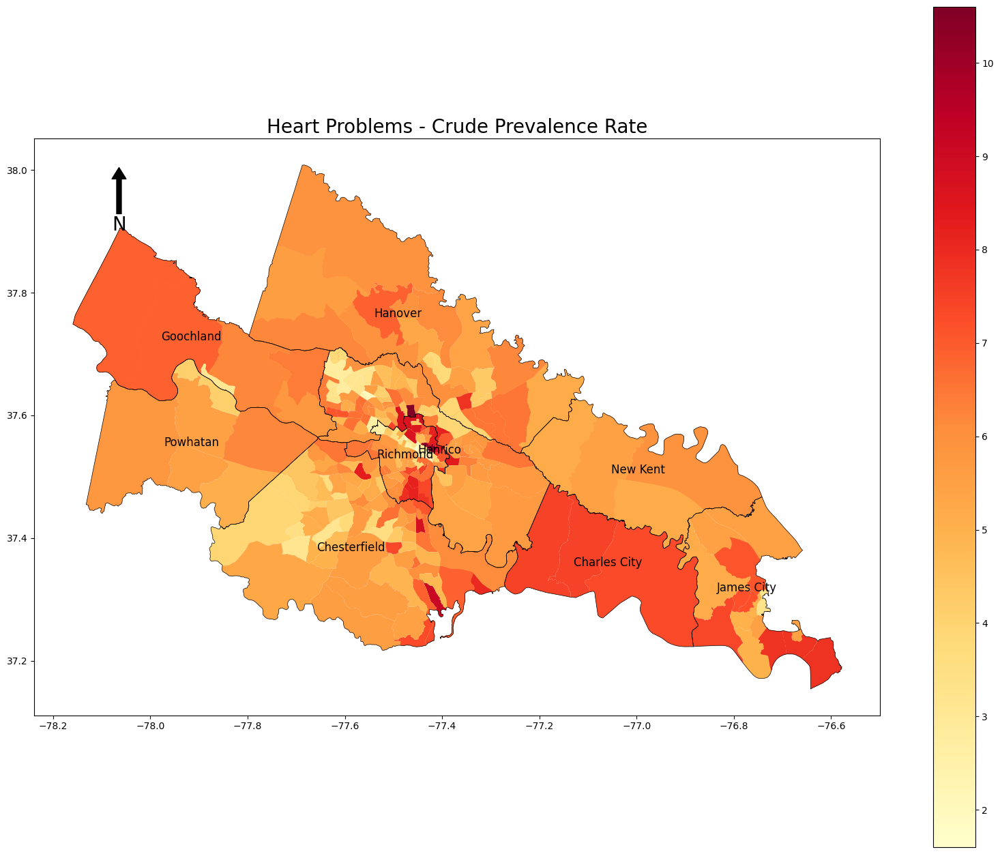

In [598]:
import matplotlib.pyplot as plt
import os

# Check and align CRS
if gdf_County_RVA.crs != gdf_asthma_subset.crs:
    gdf_County_RVA = gdf_County_RVA.to_crs(gdf_asthma_subset.crs)

# Create the plot
fig, ax = plt.subplots(figsize=(20, 16))

# Plot the choropleth map
gdf_asthma_subset.plot(column='Data_Value', cmap='YlOrRd', ax=ax, legend=True)

# Plot the county boundaries
gdf_County_RVA.plot(color='none', edgecolor='k', linewidth=0.5, ax=ax)  # Ensure 'color' is 'none' to make the counties transparent

# Add Title and Labels
ax.set_title('Heart Problems - Crude Prevalence Rate', fontsize=20)

# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
save_dir = '.'  # Define save directory
map_name = 'Heart_High_Confidence_Limit.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()


In [599]:
gdf_heart = gdf_asthma_subset

In [600]:
df_acs2021_var19 = gdf_heart

### Useable Variables

1. 'Current asthma among adults aged >=18 years'
2. 'Diagnosed diabetes among adults aged >=18 years'
3. 'High blood pressure among adults aged >=18 years'
4. 'Current lack of health insurance among adults aged 18-64 years'
5. 'Cancer (excluding skin cancer) among adults aged >=18 years'
6. 'Obesity among adults aged >=18 years'
7. 'Coronary heart disease among adults aged >=18 years'
8. 'Stroke among adults aged >=18 years'
9. 'Mental health not good for >=14 days among adults aged >=18 years'
10. 'Chronic obstructive pulmonary disease among adults aged >=18 years'

In [601]:
df['Year'].unique()

array([2020, 2019], dtype=int64)

In [602]:
df_stroke=df[df['Measure']=='Stroke among adults aged >=18 years']

In [603]:
df_asthma = df_stroke

In [604]:
df_asthma.shape

(1876, 23)

In [605]:
df_asthma.shape

(1876, 23)

In [606]:
df_asthma['Year'].unique()

array([2020], dtype=int64)

In [607]:
df_asthma['CountyFIPS'].unique()

array([51041, 51059, 51013, 51027, 51025, 51057, 51033, 51003, 51031,
       51019, 51047, 51015, 51029, 51005, 51035, 51001, 51011, 51043,
       51009, 51023, 51021, 51036, 51037, 51017, 51053, 51049, 51007,
       51051, 51063, 51155, 51077, 51045, 51087, 51067, 51095, 51107,
       51191, 51595, 51710, 51139, 51153, 51083, 51111, 51121, 51143,
       51131, 51085, 51105, 51149, 51093, 51101, 51145, 51073, 51075,
       51061, 51109, 51115, 51147, 51117, 51069, 51089, 51119, 51141,
       51099, 51103, 51071, 51133, 51065, 51135, 51113, 51137, 51127,
       51081, 51125, 51091, 51097, 51079, 51550, 51580, 51197, 51157,
       51690, 51165, 51650, 51680, 51510, 51173, 51175, 51540, 51630,
       51177, 51179, 51700, 51199, 51590, 51185, 51570, 51195, 51660,
       51167, 51520, 51171, 51187, 51183, 51163, 51161, 51610, 51640,
       51670, 51530, 51169, 51193, 51678, 51683, 51685, 51620, 51600,
       51159, 51181, 51760, 51800, 51810, 51740, 51770, 51830, 51730,
       51820, 51790,

In [608]:
len(df_asthma[df_asthma['CountyFIPS']==51760].sort_values(by='LocationName', ascending=True))

66

In [609]:
df_asthma.columns

Index(['Year', 'StateAbbr', 'StateDesc', 'CountyName', 'CountyFIPS',
       'LocationName', 'DataSource', 'Category', 'Measure', 'Data_Value_Unit',
       'Data_Value_Type', 'Data_Value', 'Data_Value_Footnote_Symbol',
       'Data_Value_Footnote', 'Low_Confidence_Limit', 'High_Confidence_Limit',
       'TotalPopulation', 'Geolocation', 'LocationID', 'CategoryID',
       'MeasureId', 'DataValueTypeID', 'Short_Question_Text'],
      dtype='object')

In [610]:
df_asthma['GEOID'] = df_asthma['LocationName']

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4020978062.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['LocationName']


In [611]:
df_asthma.head()

,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,Low_Confidence_Limit,High_Confidence_Limit,TotalPopulation,Geolocation,LocationID,CategoryID,MeasureId,DataValueTypeID,Short_Question_Text,GEOID
2000080,2020,VA,Virginia,Chesterfield,51041,51041100912,BRFSS,Health Outcomes,Stroke among adults aged >=18 years,%,...,2.0,2.6,6268,POINT (-77.6528554 37.43550455),51041100912,HLTHOUT,STROKE,CrdPrv,Stroke,51041100912
2000081,2020,VA,Virginia,Fairfax,51059,51059470100,BRFSS,Health Outcomes,Stroke among adults aged >=18 years,%,...,1.8,2.4,2732,POINT (-77.16120606 38.95507591),51059470100,HLTHOUT,STROKE,CrdPrv,Stroke,51059470100
2000086,2020,VA,Virginia,Fairfax,51059,51059481105,BRFSS,Health Outcomes,Stroke among adults aged >=18 years,%,...,1.3,1.7,5539,POINT (-77.39815572 38.9361009),51059481105,HLTHOUT,STROKE,CrdPrv,Stroke,51059481105
2000088,2020,VA,Virginia,Chesterfield,51041,51041100910,BRFSS,Health Outcomes,Stroke among adults aged >=18 years,%,...,2.3,2.9,5351,POINT (-77.5832998 37.4750995),51041100910,HLTHOUT,STROKE,CrdPrv,Stroke,51041100910
2000150,2020,VA,Virginia,Fairfax,51059,51059431802,BRFSS,Health Outcomes,Stroke among adults aged >=18 years,%,...,1.8,2.3,3216,POINT (-77.26866062 38.80826451),51059431802,HLTHOUT,STROKE,CrdPrv,Stroke,51059431802


In [612]:
gdf_US_CT['GEOID'] = gdf_US_CT['GEOID'].astype(str)
df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4026371282.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)


In [613]:
import pandas as pd

# Load the crosswalk file
crosswalk_path = r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\crosswalk_CT10to20.txt"
# df_crosswalk = pd.read_csv(crosswalk_path, delimiter='\t', dtype=str)
df_crosswalk = pd.read_csv(crosswalk_path, delimiter='|', dtype=str)
# Display the first few rows of the crosswalk DataFrame
print(df_crosswalk.head())


     OID_TRACT_20 GEOID_TRACT_20 NAMELSAD_TRACT_20 AREALAND_TRACT_20  \
0  20790540092527    01001020100  Census Tract 201           9825304   
1  20790540092527    01001020100  Census Tract 201           9825304   
2  20790540092534    01001020200  Census Tract 202           3320818   
3  20790540092528    01001020300  Census Tract 203           5349271   
4  20790540092529    01001020400  Census Tract 204           6384282   

  AREAWATER_TRACT_20 MTFCC_TRACT_20 FUNCSTAT_TRACT_20    OID_TRACT_10  \
0              28435          G5020                 S  20740540092527   
1              28435          G5020                 S  20740540092534   
2               5669          G5020                 S  20740540092534   
3               9054          G5020                 S  20740540092528   
4               8408          G5020                 S  20740540092529   

  GEOID_TRACT_10 NAMELSAD_TRACT_10 AREALAND_TRACT_10 AREAWATER_TRACT_10  \
0    01001020100  Census Tract 201           9827271 

In [614]:
# Ensure 'GEOID_2016' is a string for merging
df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\3898980032.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)


In [615]:
df_2016_merged = pd.merge(df_asthma, df_crosswalk, on='GEOID_TRACT_10', how='inner')

df_2016_merged.head()


,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,MTFCC_TRACT_20,FUNCSTAT_TRACT_20,OID_TRACT_10,NAMELSAD_TRACT_10,AREALAND_TRACT_10,AREAWATER_TRACT_10,MTFCC_TRACT_10,FUNCSTAT_TRACT_10,AREALAND_PART,AREAWATER_PART
0,2020,VA,Virginia,Chesterfield,51041,51041100912,BRFSS,Health Outcomes,Stroke among adults aged >=18 years,%,...,G5020,S,20740355746822,Census Tract 1009.12,7964559,2550215,G5020,S,7964559,2550215
1,2020,VA,Virginia,Fairfax,51059,51059470100,BRFSS,Health Outcomes,Stroke among adults aged >=18 years,%,...,G5020,S,20740241117483,Census Tract 4701,7577922,4027,G5020,S,7577922,4027
2,2020,VA,Virginia,Fairfax,51059,51059481105,BRFSS,Health Outcomes,Stroke among adults aged >=18 years,%,...,G5020,S,207403714715987,Census Tract 4811.05,3370314,15228,G5020,S,3370314,15228
3,2020,VA,Virginia,Chesterfield,51041,51041100910,BRFSS,Health Outcomes,Stroke among adults aged >=18 years,%,...,G5020,S,20740355746793,Census Tract 1009.10,6543271,22977,G5020,S,6543271,22977
4,2020,VA,Virginia,Fairfax,51059,51059431802,BRFSS,Health Outcomes,Stroke among adults aged >=18 years,%,...,G5020,S,207403714715570,Census Tract 4318.02,1912912,6174,G5020,S,1912912,6174


In [616]:
df_2016_converted = df_2016_merged[['GEOID_TRACT_20', 'Data_Value']]

In [617]:
df_2016_converted.head()

,GEOID_TRACT_20,Data_Value
0,51041100912,2.3
1,51059470100,2.1
2,51059481105,1.5
3,51041100910,2.6
4,51059431802,2.0


In [618]:
df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\769660856.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)


In [619]:
df_asthma = df_2016_converted

In [620]:
gdf_asthma = pd.merge(gdf_US_CT,df_asthma, on = 'GEOID', how = 'outer')

In [621]:
gdf_asthma.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,GEOID_TRACT_20,Data_Value
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534.0,2927606.0,+37.8856871,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",51085320100,2.9
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,2.9
2,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,3.9
3,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,2.6
4,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,2.6


In [622]:
# List of desired COUNTYFP values
countyfp_values = ['036', '041', '075', '085', '087', '127', '145', '760', '095']

# Filter the dataframe
gdf_asthma_subset = gdf_asthma[gdf_asthma['COUNTYFP'].isin(countyfp_values)]

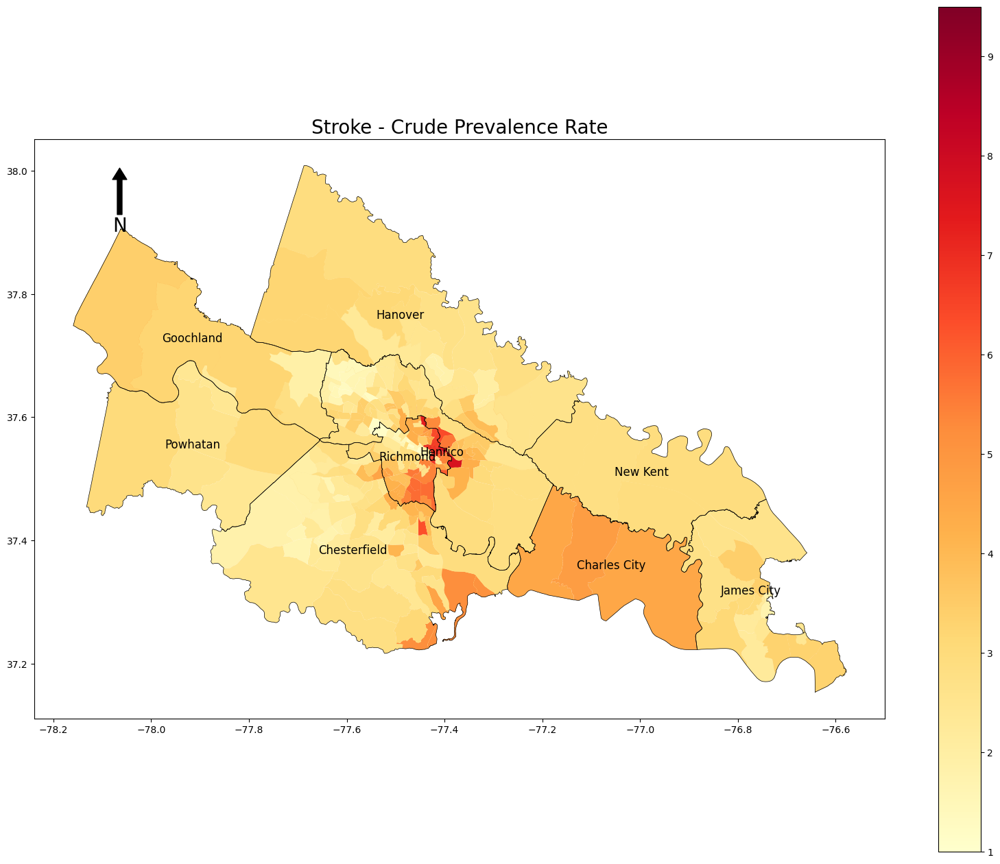

In [623]:
import matplotlib.pyplot as plt
import os

# Check and align CRS
if gdf_County_RVA.crs != gdf_asthma_subset.crs:
    gdf_County_RVA = gdf_County_RVA.to_crs(gdf_asthma_subset.crs)

# Create the plot
fig, ax = plt.subplots(figsize=(20, 16))

# Plot the choropleth map
gdf_asthma_subset.plot(column='Data_Value', cmap='YlOrRd', ax=ax, legend=True)

# Plot the county boundaries
gdf_County_RVA.plot(color='none', edgecolor='k', linewidth=0.5, ax=ax)  # Ensure 'color' is 'none' to make the counties transparent

# Add Title and Labels
ax.set_title('Stroke - Crude Prevalence Rate', fontsize=20)

# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
save_dir = '.'  # Define save directory
map_name = 'Stroke_High_Confidence_Limit.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()


In [624]:
gdf_stroke = gdf_asthma_subset

In [625]:
df_acs2021_var20 = gdf_stroke

### Useable Variables

1. 'Current asthma among adults aged >=18 years'
2. 'Diagnosed diabetes among adults aged >=18 years'
3. 'High blood pressure among adults aged >=18 years'
4. 'Current lack of health insurance among adults aged 18-64 years'
5. 'Cancer (excluding skin cancer) among adults aged >=18 years'
6. 'Obesity among adults aged >=18 years'
7. 'Coronary heart disease among adults aged >=18 years'
8. 'Stroke among adults aged >=18 years'
9. 'Mental health not good for >=14 days among adults aged >=18 years'
10. 'Chronic obstructive pulmonary disease among adults aged >=18 years'

In [626]:
df['Year'].unique()

array([2020, 2019], dtype=int64)

In [627]:
df_MH=df[df['Measure']=='Mental health not good for >=14 days among adults aged >=18 years']

In [628]:
df_asthma = df_MH

In [629]:
df_asthma.shape

(1876, 23)

In [630]:
df_asthma.shape

(1876, 23)

In [631]:
df_asthma['Year'].unique()

array([2020], dtype=int64)

In [632]:
df_asthma['CountyFIPS'].unique()

array([51059, 51041, 51003, 51023, 51001, 51045, 51031, 51013, 51035,
       51011, 51015, 51036, 51033, 51053, 51027, 51009, 51047, 51029,
       51057, 51021, 51025, 51019, 51043, 51005, 51051, 51037, 51017,
       51007, 51049, 51145, 51087, 51093, 51079, 51137, 51085, 51063,
       51153, 51107, 51069, 51139, 51067, 51075, 51141, 51077, 51099,
       51121, 51071, 51117, 51113, 51149, 51133, 51155, 51143, 51095,
       51109, 51061, 51127, 51119, 51073, 51065, 51081, 51089, 51083,
       51147, 51103, 51131, 51101, 51111, 51091, 51105, 51115, 51125,
       51097, 51135, 51690, 51510, 51179, 51710, 51590, 51165, 51650,
       51173, 51680, 51185, 51177, 51700, 51540, 51550, 51610, 51161,
       51195, 51191, 51620, 51570, 51199, 51171, 51630, 51167, 51183,
       51595, 51670, 51175, 51159, 51163, 51640, 51197, 51520, 51187,
       51660, 51683, 51600, 51157, 51169, 51193, 51580, 51685, 51181,
       51678, 51530, 51790, 51735, 51810, 51760, 51800, 51730, 51770,
       51830, 51840,

In [633]:
len(df_asthma[df_asthma['CountyFIPS']==51760].sort_values(by='LocationName', ascending=True))

66

In [634]:
df_asthma.columns

Index(['Year', 'StateAbbr', 'StateDesc', 'CountyName', 'CountyFIPS',
       'LocationName', 'DataSource', 'Category', 'Measure', 'Data_Value_Unit',
       'Data_Value_Type', 'Data_Value', 'Data_Value_Footnote_Symbol',
       'Data_Value_Footnote', 'Low_Confidence_Limit', 'High_Confidence_Limit',
       'TotalPopulation', 'Geolocation', 'LocationID', 'CategoryID',
       'MeasureId', 'DataValueTypeID', 'Short_Question_Text'],
      dtype='object')

In [635]:
df_asthma['GEOID'] = df_asthma['LocationName']

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4020978062.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['LocationName']


In [636]:
import pandas as pd

# Load the crosswalk file
crosswalk_path = r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\crosswalk_CT10to20.txt"
# df_crosswalk = pd.read_csv(crosswalk_path, delimiter='\t', dtype=str)
df_crosswalk = pd.read_csv(crosswalk_path, delimiter='|', dtype=str)
# Display the first few rows of the crosswalk DataFrame
print(df_crosswalk.head())


     OID_TRACT_20 GEOID_TRACT_20 NAMELSAD_TRACT_20 AREALAND_TRACT_20  \
0  20790540092527    01001020100  Census Tract 201           9825304   
1  20790540092527    01001020100  Census Tract 201           9825304   
2  20790540092534    01001020200  Census Tract 202           3320818   
3  20790540092528    01001020300  Census Tract 203           5349271   
4  20790540092529    01001020400  Census Tract 204           6384282   

  AREAWATER_TRACT_20 MTFCC_TRACT_20 FUNCSTAT_TRACT_20    OID_TRACT_10  \
0              28435          G5020                 S  20740540092527   
1              28435          G5020                 S  20740540092534   
2               5669          G5020                 S  20740540092534   
3               9054          G5020                 S  20740540092528   
4               8408          G5020                 S  20740540092529   

  GEOID_TRACT_10 NAMELSAD_TRACT_10 AREALAND_TRACT_10 AREAWATER_TRACT_10  \
0    01001020100  Census Tract 201           9827271 

In [637]:
# Ensure 'GEOID_2016' is a string for merging
df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\3898980032.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)


In [638]:
df_2016_merged = pd.merge(df_asthma, df_crosswalk, on='GEOID_TRACT_10', how='inner')

df_2016_merged.head()


,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,MTFCC_TRACT_20,FUNCSTAT_TRACT_20,OID_TRACT_10,NAMELSAD_TRACT_10,AREALAND_TRACT_10,AREAWATER_TRACT_10,MTFCC_TRACT_10,FUNCSTAT_TRACT_10,AREALAND_PART,AREAWATER_PART
0,2020,VA,Virginia,Fairfax,51059,51059481101,BRFSS,Health Status,Mental health not good for >=14 days among adu...,%,...,G5020,S,207403714716012,Census Tract 4811.01,854167,19712,G5020,S,832920,19712
1,2020,VA,Virginia,Fairfax,51059,51059481101,BRFSS,Health Status,Mental health not good for >=14 days among adu...,%,...,G5020,S,207403714716012,Census Tract 4811.01,854167,19712,G5020,S,10343,0
2,2020,VA,Virginia,Fairfax,51059,51059481101,BRFSS,Health Status,Mental health not good for >=14 days among adu...,%,...,G5020,S,207403714716012,Census Tract 4811.01,854167,19712,G5020,S,10904,0
3,2020,VA,Virginia,Fairfax,51059,51059422102,BRFSS,Health Status,Mental health not good for >=14 days among adu...,%,...,G5020,S,207403714715984,Census Tract 4221.02,6768650,114990,G5020,S,0,1388
4,2020,VA,Virginia,Fairfax,51059,51059422102,BRFSS,Health Status,Mental health not good for >=14 days among adu...,%,...,G5020,S,207403714715984,Census Tract 4221.02,6768650,114990,G5020,S,6647091,113602


In [639]:
df_2016_converted = df_2016_merged[['GEOID_TRACT_20', 'Data_Value']]

In [640]:
df_2016_converted.head()

,GEOID_TRACT_20,Data_Value
0,51059481101,11.5
1,51059481201,11.5
2,51059482506,11.5
3,51059416300,13.6
4,51059422102,13.6


In [641]:
df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\769660856.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)


In [642]:
df_asthma = df_2016_converted

In [643]:
gdf_asthma = pd.merge(gdf_US_CT,df_asthma, on = 'GEOID', how = 'outer')

In [644]:
gdf_asthma.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,GEOID_TRACT_20,Data_Value
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534.0,2927606.0,+37.8856871,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",51085320100,13.0
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,14.6
2,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,14.0
3,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,12.7
4,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,15.6


In [645]:
# List of desired COUNTYFP values
countyfp_values = ['036', '041', '075', '085', '087', '127', '145', '760', '095']

# Filter the dataframe
gdf_asthma_subset = gdf_asthma[gdf_asthma['COUNTYFP'].isin(countyfp_values)]

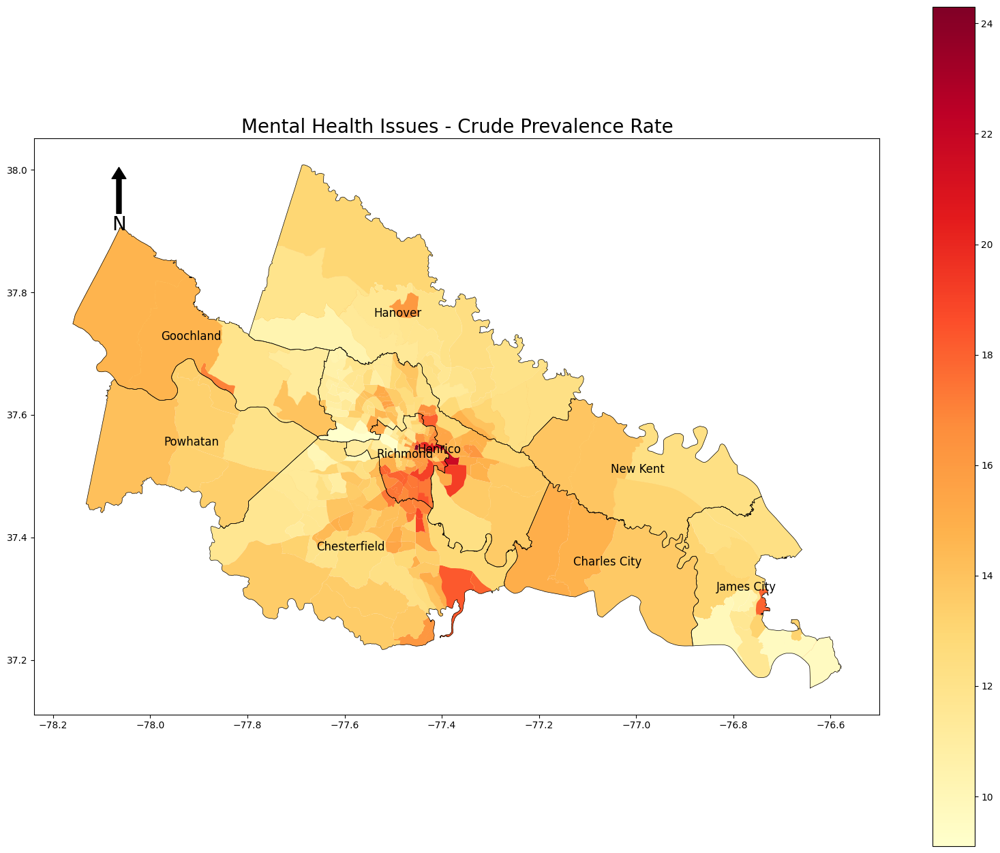

In [646]:
import matplotlib.pyplot as plt
import os

# Check and align CRS
if gdf_County_RVA.crs != gdf_asthma_subset.crs:
    gdf_County_RVA = gdf_County_RVA.to_crs(gdf_asthma_subset.crs)

# Create the plot
fig, ax = plt.subplots(figsize=(20, 16))

# Plot the choropleth map
gdf_asthma_subset.plot(column='Data_Value', cmap='YlOrRd', ax=ax, legend=True)

# Plot the county boundaries
gdf_County_RVA.plot(color='none', edgecolor='k', linewidth=0.5, ax=ax)  # Ensure 'color' is 'none' to make the counties transparent

# Add Title and Labels
ax.set_title('Mental Health Issues - Crude Prevalence Rate', fontsize=20)

# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
save_dir = '.'  # Define save directory
map_name = 'MH_High_Confidence_Limit.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()


In [647]:
gdf_MH = gdf_asthma_subset

In [648]:
df_acs2021_var21 = gdf_MH

### Useable Variables

1. 'Current asthma among adults aged >=18 years'
2. 'Diagnosed diabetes among adults aged >=18 years'
3. 'High blood pressure among adults aged >=18 years'
4. 'Current lack of health insurance among adults aged 18-64 years'
5. 'Cancer (excluding skin cancer) among adults aged >=18 years'
6. 'Obesity among adults aged >=18 years'
7. 'Coronary heart disease among adults aged >=18 years'
8. 'Stroke among adults aged >=18 years'
9. 'Mental health not good for >=14 days among adults aged >=18 years'
10. 'Chronic obstructive pulmonary disease among adults aged >=18 years'

In [649]:
df['Year'].unique()

array([2020, 2019], dtype=int64)

In [650]:
df_COPD=df[df['Measure']=='Chronic obstructive pulmonary disease among adults aged >=18 years']

In [651]:
df_asthma = df_COPD

In [652]:
df_asthma.shape

(1876, 23)

In [653]:
df_asthma.shape

(1876, 23)

In [654]:
df_asthma['Year'].unique()

array([2020], dtype=int64)

In [655]:
df_asthma['CountyFIPS'].unique()

array([51105, 51059, 51013, 51009, 51027, 51041, 51015, 51051, 51003,
       51019, 51029, 51053, 51047, 51031, 51011, 51023, 51001, 51035,
       51005, 51049, 51057, 51033, 51037, 51017, 51025, 51043, 51007,
       51021, 51036, 51045, 51115, 51109, 51087, 51153, 51141, 51099,
       51077, 51121, 51061, 51079, 51069, 51089, 51133, 51119, 51107,
       51143, 51085, 51093, 51113, 51065, 51131, 51111, 51155, 51081,
       51063, 51137, 51125, 51127, 51083, 51103, 51095, 51067, 51097,
       51135, 51139, 51117, 51073, 51149, 51075, 51145, 51147, 51071,
       51101, 51091, 51650, 51550, 51595, 51193, 51700, 51510, 51165,
       51187, 51660, 51199, 51177, 51171, 51179, 51159, 51710, 51175,
       51197, 51680, 51191, 51590, 51161, 51169, 51620, 51163, 51670,
       51683, 51195, 51570, 51600, 51540, 51181, 51173, 51185, 51167,
       51685, 51580, 51157, 51520, 51183, 51630, 51610, 51690, 51678,
       51530, 51640, 51810, 51750, 51740, 51760, 51730, 51770, 51800,
       51820, 51790,

In [656]:
len(df_asthma[df_asthma['CountyFIPS']==51760].sort_values(by='LocationName', ascending=True))

66

In [657]:
df_asthma.columns

Index(['Year', 'StateAbbr', 'StateDesc', 'CountyName', 'CountyFIPS',
       'LocationName', 'DataSource', 'Category', 'Measure', 'Data_Value_Unit',
       'Data_Value_Type', 'Data_Value', 'Data_Value_Footnote_Symbol',
       'Data_Value_Footnote', 'Low_Confidence_Limit', 'High_Confidence_Limit',
       'TotalPopulation', 'Geolocation', 'LocationID', 'CategoryID',
       'MeasureId', 'DataValueTypeID', 'Short_Question_Text'],
      dtype='object')

In [658]:
df_asthma['GEOID'] = df_asthma['LocationName']

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4020978062.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['LocationName']


In [659]:
df_asthma.head()

,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,Low_Confidence_Limit,High_Confidence_Limit,TotalPopulation,Geolocation,LocationID,CategoryID,MeasureId,DataValueTypeID,Short_Question_Text,GEOID
1622740,2020,VA,Virginia,Lee,51105,51105950600,BRFSS,Health Outcomes,Chronic obstructive pulmonary disease among ad...,%,...,10.0,12.5,4180,POINT (-83.44998086 36.6319259),51105950600,HLTHOUT,COPD,CrdPrv,COPD,51105950600
2000038,2020,VA,Virginia,Fairfax,51059,51059480501,BRFSS,Health Outcomes,Chronic obstructive pulmonary disease among ad...,%,...,2.8,4.1,3604,POINT (-77.36128253 38.9996284),51059480501,HLTHOUT,COPD,CrdPrv,COPD,51059480501
2000076,2020,VA,Virginia,Fairfax,51059,51059480802,BRFSS,Health Outcomes,Chronic obstructive pulmonary disease among ad...,%,...,2.4,3.5,3685,POINT (-77.37273206 38.97235733),51059480802,HLTHOUT,COPD,CrdPrv,COPD,51059480802
2000091,2020,VA,Virginia,Fairfax,51059,51059432701,BRFSS,Health Outcomes,Chronic obstructive pulmonary disease among ad...,%,...,3.0,4.4,3210,POINT (-77.2195351 38.74759246),51059432701,HLTHOUT,COPD,CrdPrv,COPD,51059432701
2000148,2020,VA,Virginia,Arlington,51013,51013103503,BRFSS,Health Outcomes,Chronic obstructive pulmonary disease among ad...,%,...,1.8,2.5,4109,POINT (-77.05341025 38.86081883),51013103503,HLTHOUT,COPD,CrdPrv,COPD,51013103503


In [660]:
gdf_US_CT['GEOID'] = gdf_US_CT['GEOID'].astype(str)
df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\4026371282.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID'] = df_asthma['GEOID'].astype(str)


In [661]:
import pandas as pd

# Load the crosswalk file
crosswalk_path = r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\crosswalk_CT10to20.txt"
# df_crosswalk = pd.read_csv(crosswalk_path, delimiter='\t', dtype=str)
df_crosswalk = pd.read_csv(crosswalk_path, delimiter='|', dtype=str)
# Display the first few rows of the crosswalk DataFrame
print(df_crosswalk.head())


     OID_TRACT_20 GEOID_TRACT_20 NAMELSAD_TRACT_20 AREALAND_TRACT_20  \
0  20790540092527    01001020100  Census Tract 201           9825304   
1  20790540092527    01001020100  Census Tract 201           9825304   
2  20790540092534    01001020200  Census Tract 202           3320818   
3  20790540092528    01001020300  Census Tract 203           5349271   
4  20790540092529    01001020400  Census Tract 204           6384282   

  AREAWATER_TRACT_20 MTFCC_TRACT_20 FUNCSTAT_TRACT_20    OID_TRACT_10  \
0              28435          G5020                 S  20740540092527   
1              28435          G5020                 S  20740540092534   
2               5669          G5020                 S  20740540092534   
3               9054          G5020                 S  20740540092528   
4               8408          G5020                 S  20740540092529   

  GEOID_TRACT_10 NAMELSAD_TRACT_10 AREALAND_TRACT_10 AREAWATER_TRACT_10  \
0    01001020100  Census Tract 201           9827271 

In [662]:
# Ensure 'GEOID_2016' is a string for merging
df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\3898980032.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asthma['GEOID_TRACT_10'] = df_asthma['GEOID'].astype(str)


In [663]:
df_2016_merged = pd.merge(df_asthma, df_crosswalk, on='GEOID_TRACT_10', how='inner')

df_2016_merged.head()


,Year,StateAbbr,StateDesc,CountyName,CountyFIPS,LocationName,DataSource,Category,Measure,Data_Value_Unit,...,MTFCC_TRACT_20,FUNCSTAT_TRACT_20,OID_TRACT_10,NAMELSAD_TRACT_10,AREALAND_TRACT_10,AREAWATER_TRACT_10,MTFCC_TRACT_10,FUNCSTAT_TRACT_10,AREALAND_PART,AREAWATER_PART
0,2020,VA,Virginia,Lee,51105,51105950600,BRFSS,Health Outcomes,Chronic obstructive pulmonary disease among ad...,%,...,G5020,S,20740252582248,Census Tract 9506,226468228,428131,G5020,S,226468228,428131
1,2020,VA,Virginia,Fairfax,51059,51059480501,BRFSS,Health Outcomes,Chronic obstructive pulmonary disease among ad...,%,...,G5020,S,207403714715772,Census Tract 4805.01,5040081,54976,G5020,S,5040081,54976
2,2020,VA,Virginia,Fairfax,51059,51059480802,BRFSS,Health Outcomes,Chronic obstructive pulmonary disease among ad...,%,...,G5020,S,207403714715780,Census Tract 4808.02,2592216,5857,G5020,S,2587389,5857
3,2020,VA,Virginia,Fairfax,51059,51059480802,BRFSS,Health Outcomes,Chronic obstructive pulmonary disease among ad...,%,...,G5020,S,207403714715780,Census Tract 4808.02,2592216,5857,G5020,S,4827,0
4,2020,VA,Virginia,Fairfax,51059,51059432701,BRFSS,Health Outcomes,Chronic obstructive pulmonary disease among ad...,%,...,G5020,S,207403714715486,Census Tract 4327.01,2024616,2108,G5020,S,2024616,2108


In [664]:
df_2016_converted = df_2016_merged[['GEOID_TRACT_20', 'Data_Value']]

In [665]:
df_2016_converted.head()

,GEOID_TRACT_20,Data_Value
0,51105950600,11.2
1,51059480501,3.4
2,51059480802,2.9
3,51059480902,2.9
4,51059432701,3.6


In [666]:
df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\769660856.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2016_converted['GEOID']=df_2016_converted['GEOID_TRACT_20'].astype(str)


In [667]:
df_asthma = df_2016_converted

In [668]:
gdf_asthma = pd.merge(gdf_US_CT,df_asthma, on = 'GEOID', how = 'outer')

In [669]:
gdf_asthma.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,GEOID_TRACT_20,Data_Value
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534.0,2927606.0,+37.8856871,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",51085320100,6.3
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,6.9
2,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521.0,16144.0,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",51085321201,7.7
3,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,6.9
4,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075.0,96758.0,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",51085321202,4.0


In [670]:
# List of desired COUNTYFP values
countyfp_values = ['036', '041', '075', '085', '087', '127', '145', '760', '095']

# Filter the dataframe
gdf_asthma_subset = gdf_asthma[gdf_asthma['COUNTYFP'].isin(countyfp_values)]

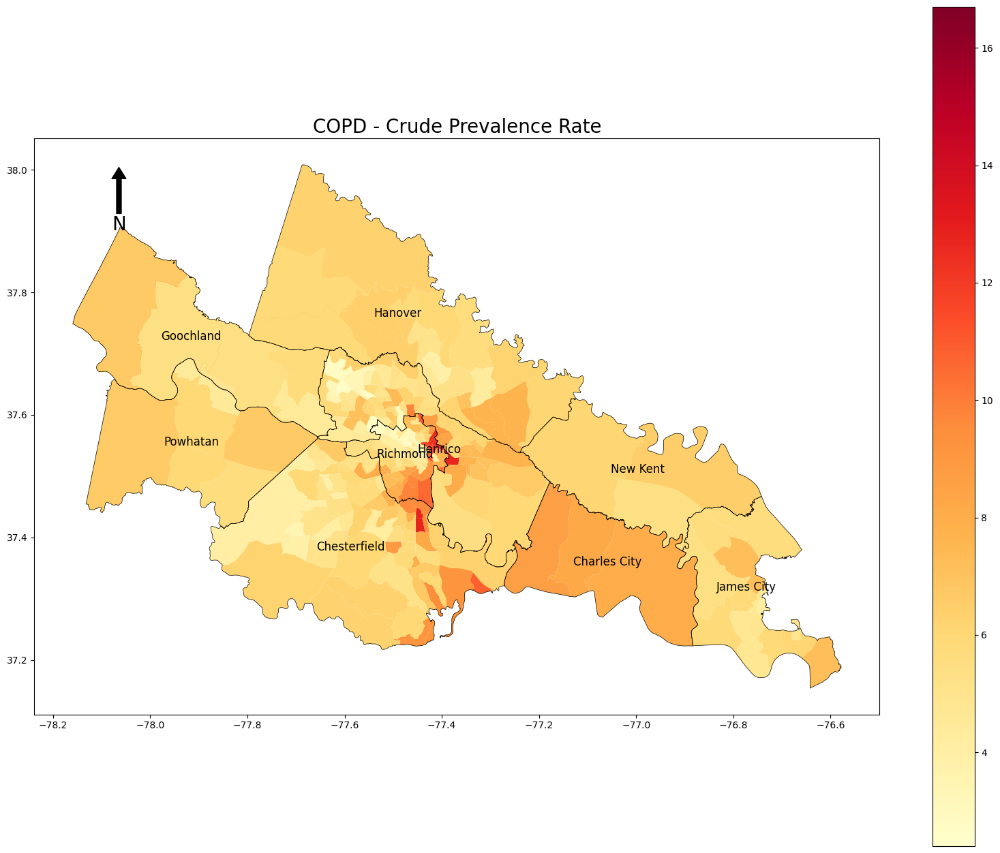

In [671]:
import matplotlib.pyplot as plt
import os

# Check and align CRS
if gdf_County_RVA.crs != gdf_asthma_subset.crs:
    gdf_County_RVA = gdf_County_RVA.to_crs(gdf_asthma_subset.crs)

# Create the plot
fig, ax = plt.subplots(figsize=(20, 16))

# Plot the choropleth map
gdf_asthma_subset.plot(column='Data_Value', cmap='YlOrRd', ax=ax, legend=True)

# Plot the county boundaries
gdf_County_RVA.plot(color='none', edgecolor='k', linewidth=0.5, ax=ax)  # Ensure 'color' is 'none' to make the counties transparent

# Add Title and Labels
ax.set_title('COPD - Crude Prevalence Rate', fontsize=20)

# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Save the map
save_dir = '.'  # Define save directory
map_name = 'COPD_High_Confidence_Limit.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()


In [672]:
gdf_COPD = gdf_asthma_subset

In [673]:
df_acs2021_var22 = gdf_COPD

In [674]:
# Var 23: Energy Burden

In [675]:
pd.set_option("display.max_rows",None)

In [676]:
import pandas as pd

In [677]:
df_acs2021.rename (columns = {'B06009_001E':'PopGr25'}, inplace = True)

In [678]:
df_energy = pd.read_excel(r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\Energy_Burden\Energy_Cost_by_CT.xlsx")

In [679]:
df_energy.rename(columns = {'Row Labels':'GEOID'}, inplace=True)

In [680]:
# Ensure 'GEOID_2016' is a string for merging
df_energy['GEOID_TRACT_10'] = df_energy['GEOID'].astype(str)

In [681]:
df_2016_merged = pd.merge(df_energy, df_crosswalk, on='GEOID_TRACT_10', how='inner')

df_2016_merged.head()


,GEOID,Average of ELEP,Average of GASP,Average of FULP,Total_Energy_Cost,GEOID_TRACT_10,OID_TRACT_20,GEOID_TRACT_20,NAMELSAD_TRACT_20,AREALAND_TRACT_20,...,MTFCC_TRACT_20,FUNCSTAT_TRACT_20,OID_TRACT_10,NAMELSAD_TRACT_10,AREALAND_TRACT_10,AREAWATER_TRACT_10,MTFCC_TRACT_10,FUNCSTAT_TRACT_10,AREALAND_PART,AREAWATER_PART
0,51001090100,3711.022654,786.045389,286.108557,4783.176599,51001090100,2079015501440908,51001090101,Census Tract 901.01,11889599,...,G5020,S,207403716859403,Census Tract 901,18542572,37914864,G5020,S,11889599,32123347
1,51001090100,3711.022654,786.045389,286.108557,4783.176599,51001090100,2079015501440904,51001090102,Census Tract 901.02,6652973,...,G5020,S,207403716859403,Census Tract 901,18542572,37914864,G5020,S,6652973,5791517
2,51001090200,2518.318496,897.841616,296.482416,3712.642528,51001090200,2079015501440899,51001090201,Census Tract 902.01,67750622,...,G5020,S,207403716859380,Census Tract 902,187803123,36546258,G5020,S,67750622,33782725
3,51001090200,2518.318496,897.841616,296.482416,3712.642528,51001090200,2079015501440876,51001090202,Census Tract 902.02,120052501,...,G5020,S,207403716859380,Census Tract 902,187803123,36546258,G5020,S,120052501,2763533
4,51001090300,1991.246836,811.742204,273.838732,3076.827772,51001090300,20790353205714,51001090300,Census Tract 903,128419397,...,G5020,S,20740353205714,Census Tract 903,128419397,61780185,G5020,S,128419397,61780185


In [682]:
df_2016_merged.columns

Index(['GEOID', 'Average of ELEP', 'Average of GASP', 'Average of FULP',
       'Total_Energy_Cost', 'GEOID_TRACT_10', 'OID_TRACT_20', 'GEOID_TRACT_20',
       'NAMELSAD_TRACT_20', 'AREALAND_TRACT_20', 'AREAWATER_TRACT_20',
       'MTFCC_TRACT_20', 'FUNCSTAT_TRACT_20', 'OID_TRACT_10',
       'NAMELSAD_TRACT_10', 'AREALAND_TRACT_10', 'AREAWATER_TRACT_10',
       'MTFCC_TRACT_10', 'FUNCSTAT_TRACT_10', 'AREALAND_PART',
       'AREAWATER_PART'],
      dtype='object')

In [683]:
df_2016_converted = df_2016_merged[['GEOID_TRACT_20','Total_Energy_Cost']]

In [684]:
df_2016_converted['GEOID'] = df_2016_converted['GEOID_TRACT_20'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\616540618.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2016_converted['GEOID'] = df_2016_converted['GEOID_TRACT_20'].astype(str)


In [685]:
df_2016_converted.columns

Index(['GEOID_TRACT_20', 'Total_Energy_Cost', 'GEOID'], dtype='object')

In [686]:
df_2016_converted.head()

,GEOID_TRACT_20,Total_Energy_Cost,GEOID
0,51001090101,4783.176599,51001090101
1,51001090102,4783.176599,51001090102
2,51001090201,3712.642528,51001090201
3,51001090202,3712.642528,51001090202
4,51001090300,3076.827772,51001090300


In [687]:
## Obtaining Income to calculate Energy Burden

In [688]:
## Census Tracts
## Obtaining data for 8 localities - Ashland will be created separately from Hanover and then removed from Hanover to prevent overlap

# ACS demographic data (selected variables)
host = 'https://api.census.gov/data'
year = f"/{Year}"
dataset = '/acs/acs5/profile'
get = '?get='
variables = 'DP03_0062E'
for_param = '&for=tract:*'#All tracts
in_param = '&in=state:'
state = '51'
in_param2 = '&in=county:'
# for counties in the PlanRVA footprint
# Charles City [036], Chesterfield [041], Goochland [075], Hanover [085], Henrico [087], New Kent [127], Powhatan [145], Richmond [760]
county = '036,041,075,085,087,127,145,760,095'
# for counties in the Richmond MSA
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#county = '007,033,036,041,570,049,053,595,075,081,085,087,670,101,109,127,730,145,149,760,181,183'
#insert usr_key
query_url_HC_YM_acs2021 = f"{host}{year}{dataset}{get}{variables}{for_param}{in_param}{state}{in_param2}{county}{usr_key}"
response_HC_YM_acs2021 = requests.get(query_url_HC_YM_acs2021)

In [689]:
query_url_HC_YM_acs2021

'https://api.census.gov/data/2022/acs/acs5/profile?get=DP03_0062E&for=tract:*&in=state:51&in=county:036,041,075,085,087,127,145,760,095&key=6b0a4e1479613a5be20d0e11af6d4711d87d2a61'

In [690]:
response_HC_YM_acs2021

<Response [200]>

In [691]:
#Convert json output to DataFrame and Using first row as columns then dropping that row (first)
data_2021 = response_HC_YM_acs2021.json()
df_acs2021 = pd.DataFrame(data_2021, columns= data_2021[0])
df_acs2021 = df_acs2021.drop(df_acs2021.index[0])
df_acs2021.head()

,DP03_0062E,state,county,tract
1,75446,51,036,600100
2,64130,51,036,600200
3,62738,51,036,600300
4,130057,51,041,100106
5,39783,51,041,100107


In [692]:
#Getting Ashland Data-

In [693]:
df_acs2021_a=df_acs2021[(df_acs2021['county']=='085')&((df_acs2021['tract']=='320601')|(df_acs2021['tract']=='320602'))].replace('085','03368')

In [694]:
df_acs2021_a # Ashland Census Tracts

,DP03_0062E,state,county,tract
90,64188,51,03368,320601
91,64271,51,03368,320602


In [695]:
# Combine both DFs (8 localities and Ashland) using concat
frames = [df_acs2021,df_acs2021_a]
df_acs2021_comb = pd.DataFrame()
df_acs2021_comb = pd.concat(frames) #DataFrame Concatanation
df_acs2021_comb.head()

,DP03_0062E,state,county,tract
1,75446,51,036,600100
2,64130,51,036,600200
3,62738,51,036,600300
4,130057,51,041,100106
5,39783,51,041,100107


In [696]:
# create a new column for setting Index by defining new function and then applying it on df -
def index_df (row):
    if row['county'] == '03368':
        return '0'
    elif row['county'] == '036':
        return '1'
    elif row['county'] == '075':
        return '3'
    elif row['county'] == '087':
        return '5'
    elif row['county'] == '127':
        return '6'
    elif row['county'] == '145':
        return '7'
    elif row['county'] == '041':
        return '2'
    elif row['county'] == '085':
        return '4'
    elif row['county'] == '760':
        return '8'
    elif row['county'] == '095':
        return '9'
    else:
        return 'unknown'

In [697]:
#Applying created function on df
df_acs2021_comb['index_df'] = df_acs2021_comb.apply(lambda row: index_df(row), axis = 1)

In [698]:
df_acs2021_comb.index = df_acs2021_comb['index_df'] #Setting Index

In [699]:
df_acs2021_comb = df_acs2021_comb.sort_index().reset_index(drop=True) # Sorting by index and resetting

In [700]:
df_acs2021_comb=df_acs2021_comb.drop(['index_df'],axis=1)  #Drop created index columns

In [701]:
## Need to remove Ashland tracts from Hanover so that they dont overlap in shp

index_names = df_acs2021_comb[(df_acs2021_comb['county']=='085')&((df_acs2021_comb['tract']=='320601')|(df_acs2021_comb['tract']=='320602'))].index

index_names

Int64Index([105, 110], dtype='int64')

In [702]:
df_acs2021_comb.drop(index_names, inplace = True)


In [703]:
df_acs2021 = df_acs2021_comb #A Copy of df if needed before Editing further

In [704]:
# Create GEOID
df_acs2021 ['GEOID'] = df_acs2021['state']+df_acs2021['county']+df_acs2021['tract']


In [705]:
## Giving Ashland tracts the correct GEOID for merge later with shp
df_acs2021 = df_acs2021.replace({'5103368320601':'51085320601','5103368320602':'51085320602'})


In [706]:
df_acs2021['Year'] = Year
df_acs2021.head()

,DP03_0062E,state,county,tract,GEOID,Year
0,64271,51,03368,320602,51085320602,2022
1,64188,51,03368,320601,51085320601,2022
2,75446,51,036,600100,51036600100,2022
3,64130,51,036,600200,51036600200,2022
4,62738,51,036,600300,51036600300,2022


In [707]:
df_acs2021['DP03_0062E'] = df_acs2021['DP03_0062E'].astype(int)


df_acs2021=df_acs2021.replace(-666666666,0)
df_acs2021.head()

,DP03_0062E,state,county,tract,GEOID,Year
0,64271,51,03368,320602,51085320602,2022
1,64188,51,03368,320601,51085320601,2022
2,75446,51,036,600100,51036600100,2022
3,64130,51,036,600200,51036600200,2022
4,62738,51,036,600300,51036600300,2022


In [708]:
# create a new column for short locality name by defining new function and then applying it on df -
def locality (row):
    if row['county'] == '03368':
        return 'Ashland'
    elif row['county'] == '036':
        return 'Charles City'
    elif row['county'] == '075':
        return 'Goochland'
    elif row['county'] == '087':
        return 'Henrico'
    elif row['county'] == '127':
        return 'New Kent'
    elif row['county'] == '145':
        return 'Powhatan'
    elif row['county'] == '041':
        return 'Chesterfield'
    elif row['county'] == '085':
        return 'Hanover'
    elif row['county'] == '760':
        return 'Richmond'
    elif row['county'] == '095':
        return 'James City'
    else:
        return 'unknown'

In [709]:
df_acs2021['locality'] = df_acs2021.apply(lambda row: locality(row), axis = 1)

In [710]:
df_acs2021.columns

Index(['DP03_0062E', 'state', 'county', 'tract', 'GEOID', 'Year', 'locality'], dtype='object')

In [711]:
# Set of first five characters to filter by
geoid_set = {'51036', '51041', '51075', '51085', '51087', '51127', '51145', '51760', '51095'}

# Extract the first five characters of the GEOID column and filter
df_filtered = df_2016_converted[df_2016_converted['GEOID'].str[:5].isin(geoid_set)]

In [712]:
df_filtered.head()

,GEOID_TRACT_20,Total_Energy_Cost,GEOID
390,51036600100,2851.694484,51036600100
391,51036600200,3064.943912,51036600200
392,51036600300,3318.349738,51036600300
397,51041100106,2870.621073,51041100106
398,51760070400,2870.621073,51760070400


In [713]:
df_filtered['GEOID'] = df_filtered['GEOID'].astype(str)
df_acs2021['GEOID'] = df_acs2021['GEOID'].astype(str)

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\1957513825.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['GEOID'] = df_filtered['GEOID'].astype(str)


In [714]:
df_energy2 = pd.merge(df_acs2021,df_filtered,on = 'GEOID', how = 'outer')

In [715]:
df_energy2.columns

Index(['DP03_0062E', 'state', 'county', 'tract', 'GEOID', 'Year', 'locality',
       'GEOID_TRACT_20', 'Total_Energy_Cost'],
      dtype='object')

In [716]:
df_energy2['Total_Energy_Cost'].unique()[:5]

array([3177.33144273, 2325.7739088 , 2863.41085132, 2420.66279677,
       2851.69448372])

In [717]:
# Ensure the columns are numeric and handle NaN values
df_energy2['Total_Energy_Cost'] = pd.to_numeric(df_energy2['Total_Energy_Cost'].fillna(0))
df_energy2['DP03_0062E'] = pd.to_numeric(df_energy2['DP03_0062E'].fillna(0))

# Replace all 0s in DP03_0062E with 1s to avoid division by zero
df_energy2['DP03_0062E'] = df_energy2['DP03_0062E'].replace(0, 1)

# Calculate 'En_Burden'
df_energy2['En_Burden'] = df_energy2['Total_Energy_Cost'] / df_energy2['DP03_0062E'] * 100

# Identify the outliers (example threshold for demonstration)
outlier_threshold = 10000
outliers = df_energy2['En_Burden'] > outlier_threshold

# Replace outliers with the median of the 'En_Burden' column
median_en_burden = df_energy2.loc[~outliers, 'En_Burden'].median()
df_energy2.loc[outliers, 'En_Burden'] = median_en_burden

# Categorize En_Burden with numerical values
def categorize_energy_burden(value):
    if value < 2:
        return 0  # No Burden
    elif 2 <= value < 6:
        return 1  # Some Burden
    else:
        return 2  # High Burden

df_energy2['En_Burden'] = df_energy2['En_Burden'].apply(categorize_energy_burden)

# Display the DataFrame after handling outliers
#print(df_energy2[['GEOID', 'Total_Energy_Cost', 'DP03_0062E', 'En_Burden']])

# Sort the DataFrame by 'En_Burden' in descending order
df_sorted = df_energy2.sort_values(by='En_Burden', ascending=False)

# Display the top 20 values
top_20_en_burden = df_sorted.head(20)

# Display the result
print(top_20_en_burden[['GEOID', 'En_Burden']])

           GEOID  En_Burden
409  51760020100          2
397  51760010300          2
390  51760020400          2
418  51760030100          2
417  51760030100          2
381  51760060800          2
375  51760040300          2
408  51760020100          2
410  51760020200          2
272  51087200126          1
281  51087200303          1
280  51087200305          1
279  51087200404          1
277  51087200409          1
275  51087200407          1
273  51087200140          1
0    51085320602          1
271  51087200413          1
252  51087200136          1
270  51087200106          1


In [718]:
df_energy2['En_Burden'].max()

2

In [719]:
gdf_asthma = pd.merge(gdf_US_CT,df_energy2, on = 'GEOID', how = 'outer')

In [720]:
gdf_asthma.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,geometry,DP03_0062E,state,county,tract,Year,locality,GEOID_TRACT_20,Total_Energy_Cost,En_Burden
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,...,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",93117.0,51,085,320100,2022,Hanover,51085320100,2998.407418,1.0
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",89083.0,51,085,321201,2022,Hanover,51085321201,2240.047877,1.0
2,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,...,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",89083.0,51,085,321201,2022,Hanover,51085321201,2276.887172,1.0
3,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",60197.0,51,085,321202,2022,Hanover,51085321202,2314.782910,1.0
4,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,...,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",60197.0,51,085,321202,2022,Hanover,51085321202,1934.532106,1.0


In [721]:
# List of desired COUNTYFP values
countyfp_values = ['036', '041', '075', '085', '087', '127', '145', '760', '095']

# Filter the dataframe
gdf_asthma_subset = gdf_asthma[gdf_asthma['COUNTYFP'].isin(countyfp_values)]

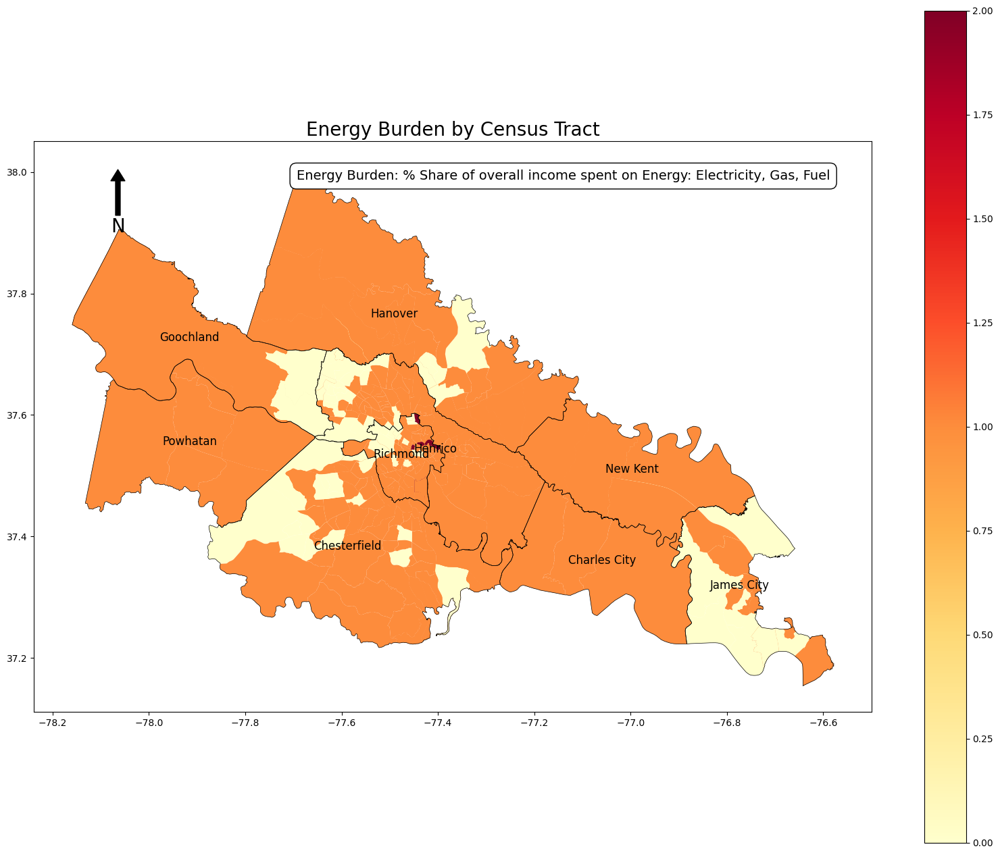

In [722]:
fig, ax = plt.subplots(figsize = (20,16)) 

gdf_asthma_subset.plot(column='En_Burden',cmap = 'YlOrRd',ax=ax,legend = 'True') # Values 
gdf_County_RVA.plot(color='None',edgecolor='k',linewidth = 0.5,ax=ax) ## Locality boundaries

# Add Title and Labels
ax.set_title('Energy Burden by Census Tract', fontsize=20)
    
# Add labels for counties
for idx, row in gdf_County_RVA.iterrows():
    ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                horizontalalignment='center', fontsize=12, color='black')

# Add North Arrow
x, y, arrow_length = 0.1, 0.95, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)
# Add text box
textstr = "Energy Burden: % Share of overall income spent on Energy: Electricity, Gas, Fuel"
props = dict(boxstyle='round,pad=0.5', facecolor='white', edgecolor='black')
ax.text(0.95, 0.95, textstr, transform=ax.transAxes, fontsize=14,
        verticalalignment='top', horizontalalignment='right', bbox=props)

# Save the map
map_name = 'Energy_Burden.png'  # Change the map name as needed
save_path = os.path.join(save_dir, map_name)
plt.savefig(save_path, dpi=300, bbox_inches='tight')
plt.show()

In [723]:
gdf_energy = gdf_asthma_subset

In [724]:
df_acs2021_var23 = gdf_energy

In [725]:
len(gdf_energy)

462

In [726]:
dfs = [
    df_acs2021_var1, df_acs2021_var2, df_acs2021_var3, df_acs2021_var4, 
    df_acs2021_var5, df_acs2021_var6, df_acs2021_var7, df_acs2021_var8, 
    df_acs2021_var9, df_acs2021_var10, df_acs2021_var11,
    df_acs2021_var12, df_acs2021_var13, df_acs2021_var14, df_acs2021_var15,
    df_acs2021_var16, df_acs2021_var17, df_acs2021_var18, df_acs2021_var19,
    df_acs2021_var20, df_acs2021_var21, df_acs2021_var22, df_acs2021_var23
]

In [727]:
for i, df in enumerate(dfs, start=1):
    print(f'Length of df_acs2021_var{i}: {len(df)}')


Length of df_acs2021_var1: 296
Length of df_acs2021_var2: 296
Length of df_acs2021_var3: 296
Length of df_acs2021_var4: 296
Length of df_acs2021_var5: 296
Length of df_acs2021_var6: 296
Length of df_acs2021_var7: 296
Length of df_acs2021_var8: 296
Length of df_acs2021_var9: 296
Length of df_acs2021_var10: 296
Length of df_acs2021_var11: 296
Length of df_acs2021_var12: 296
Length of df_acs2021_var13: 290
Length of df_acs2021_var14: 462
Length of df_acs2021_var15: 462
Length of df_acs2021_var16: 462
Length of df_acs2021_var17: 462
Length of df_acs2021_var18: 462
Length of df_acs2021_var19: 462
Length of df_acs2021_var20: 462
Length of df_acs2021_var21: 462
Length of df_acs2021_var22: 462
Length of df_acs2021_var23: 462


In [728]:
# List of DataFrames
dfs = [
    df_acs2021_var14, df_acs2021_var15, df_acs2021_var16, df_acs2021_var17, 
    df_acs2021_var18, df_acs2021_var19, df_acs2021_var20, df_acs2021_var21, 
    df_acs2021_var22, df_acs2021_var23
]

# List of desired COUNTYFP values
countyfp_values = ['036', '041', '075', '085', '087', '127', '145', '760', '095']

# Create a new list to store the filtered DataFrames
filtered_dfs = []

# Filter each DataFrame based on COUNTYFP values
for df in dfs:
    filtered_df = df[df['COUNTYFP'].isin(countyfp_values)]
    filtered_dfs.append(filtered_df)

# Unpack the filtered DataFrames back into individual variables
df_acs2021_var14, df_acs2021_var15, df_acs2021_var16, df_acs2021_var17, \
df_acs2021_var18, df_acs2021_var19, df_acs2021_var20, df_acs2021_var21, \
df_acs2021_var22, df_acs2021_var23 = filtered_dfs

# Display the result to check
for i, df in enumerate(filtered_dfs, start=14):
    print(f"Length of df_acs2021_var{i}: {len(df)}")


Length of df_acs2021_var14: 462
Length of df_acs2021_var15: 462
Length of df_acs2021_var16: 462
Length of df_acs2021_var17: 462
Length of df_acs2021_var18: 462
Length of df_acs2021_var19: 462
Length of df_acs2021_var20: 462
Length of df_acs2021_var21: 462
Length of df_acs2021_var22: 462
Length of df_acs2021_var23: 462


In [729]:
df_acs2021_var14.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'GEOID', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry',
       'GEOID_TRACT_20', 'Data_Value'],
      dtype='object')

In [730]:
# List of DataFrames
dfs = [
    df_acs2021_var14, df_acs2021_var15, df_acs2021_var16, df_acs2021_var17, 
    df_acs2021_var18, df_acs2021_var19, df_acs2021_var20, df_acs2021_var21, 
    df_acs2021_var22, df_acs2021_var23
]

# List of desired COUNTYFP values
countyfp_values = ['036', '041', '075', '085', '087', '127', '145', '760', '095']

# Create a new list to store the filtered DataFrames
filtered_dfs = []

# Filter each DataFrame based on COUNTYFP values
for df in dfs:
    filtered_df = df[df['COUNTYFP'].isin(countyfp_values)]
    filtered_dfs.append(filtered_df)

# Unpack the filtered DataFrames back into individual variables
df_acs2021_var14, df_acs2021_var15, df_acs2021_var16, df_acs2021_var17, \
df_acs2021_var18, df_acs2021_var19, df_acs2021_var20, df_acs2021_var21, \
df_acs2021_var22, df_acs2021_var23 = filtered_dfs

# Display the result to check
for i, df in enumerate(filtered_dfs, start=14):
    print(f"df_acs2021_var{i}['COUNTYFP'].unique(): {df['COUNTYFP'].unique()}")


df_acs2021_var14['COUNTYFP'].unique(): ['085' '087' '760' '041' '145' '036' '095' '075' '127']
df_acs2021_var15['COUNTYFP'].unique(): ['085' '087' '760' '041' '145' '036' '095' '075' '127']
df_acs2021_var16['COUNTYFP'].unique(): ['085' '087' '760' '041' '145' '036' '095' '075' '127']
df_acs2021_var17['COUNTYFP'].unique(): ['085' '087' '760' '041' '145' '036' '095' '075' '127']
df_acs2021_var18['COUNTYFP'].unique(): ['085' '087' '760' '041' '145' '036' '095' '075' '127']
df_acs2021_var19['COUNTYFP'].unique(): ['085' '087' '760' '041' '145' '036' '095' '075' '127']
df_acs2021_var20['COUNTYFP'].unique(): ['085' '087' '760' '041' '145' '036' '095' '075' '127']
df_acs2021_var21['COUNTYFP'].unique(): ['085' '087' '760' '041' '145' '036' '095' '075' '127']
df_acs2021_var22['COUNTYFP'].unique(): ['085' '087' '760' '041' '145' '036' '095' '075' '127']
df_acs2021_var23['COUNTYFP'].unique(): ['085' '087' '760' '041' '145' '036' '095' '075' '127']


In [731]:
for i, df in enumerate(dfs, start=1):
    print(f'Length of df_acs2021_var{i}: {df.columns}')


Length of df_acs2021_var1: Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'GEOID', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry',
       'GEOID_TRACT_20', 'Data_Value'],
      dtype='object')
Length of df_acs2021_var2: Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'GEOID', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry',
       'GEOID_TRACT_20', 'Data_Value'],
      dtype='object')
Length of df_acs2021_var3: Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'GEOID', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry',
       'GEOID_TRACT_20', 'Data_Value'],
      dtype='object')
Length of df_acs2021_var4: Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'GEOID', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry',
       'GEOID_TRACT_20', 'Data_Value'],
      dtype='object')
Length of df_acs2021_var5: Index

## Next Works: 
## 1. Get the final mapping column names for all variables and a list of all variables together.
## 2. Check for High_Confidence_Limit meaning and write down. 
## 3. Correct title wording in maps for clarification and finalize. 
## 4. Finalize next steps for Index creation after finalizing all the values being used. 
## 5. Check old Census Tracts files if PLACES Data is created for those instead. 

In [732]:
# # List of DataFrames for each category
# economic_dfs = [
#     df_acs2021_var1, df_acs2021_var2, df_acs2021_var3, df_acs2021_var4, 
#     df_acs2021_var10, df_acs2021_var13, df_acs2021_var23
# ]

# social_cultural_dfs = [
#     df_acs2021_var6, df_acs2021_var7, df_acs2021_var8, df_acs2021_var9, df_acs2021_var11
# ]

# health_dfs = [
#     df_acs2021_var5, df_acs2021_var12, df_acs2021_var14, df_acs2021_var15, df_acs2021_var16, 
#     df_acs2021_var17, df_acs2021_var18, df_acs2021_var19, df_acs2021_var20, 
#     df_acs2021_var21, df_acs2021_var22
# ]

# # Define columns to keep for each DataFrame
# columns_to_keep = {
#     'economic': ['GEOID', 'Perc_pov', 'Perc_BurdRU', 'Perc_BurdHousU', 'Perc_NoVeh', 'En_Burden', 'HL_rating', 'Perc_Crowd'],
#     'social_cultural': ['GEOID', 'Perc_NoDis', 'Perc_Over65', 'Perc_Under5', 'Perc_NoEng', 'Perc_UnS'],
#     'health': ['GEOID','Perc_NoIns','Perc_Preg12', 'Data_Value']
# }


In [733]:
# List of DataFrames for each category
economic_dfs = [
    df_acs2021_var1[['GEOID', 'Perc_pov']], df_acs2021_var2[['GEOID', 'Perc_BurdRU']], 
    df_acs2021_var3[['GEOID', 'Perc_BurdHousU']], df_acs2021_var4[['GEOID', 'Perc_NoVeh']], 
    df_acs2021_var10[['GEOID', 'Perc_Crowd']], df_acs2021_var13[['GEOID', 'HL_rating']], 
    df_acs2021_var23[['GEOID', 'En_Burden']]
]

social_cultural_dfs = [
    df_acs2021_var6[['GEOID', 'Perc_NoDis']], df_acs2021_var7[['GEOID', 'Perc_Over65']], 
    df_acs2021_var8[['GEOID', 'Perc_Under5']], df_acs2021_var9[['GEOID', 'Perc_NoEng']], 
    df_acs2021_var11[['GEOID', 'Perc_UnS']]
]

health_dfs = [
    df_acs2021_var5[['GEOID', 'Perc_NoIns']], df_acs2021_var12[['GEOID', 'Perc_Preg12']], 
    df_acs2021_var14[['GEOID', 'Data_Value']], 
    df_acs2021_var15[['GEOID', 'Data_Value']], df_acs2021_var16[['GEOID', 'Data_Value']], 
    df_acs2021_var17[['GEOID', 'Data_Value']], df_acs2021_var18[['GEOID', 'Data_Value']], 
    df_acs2021_var19[['GEOID', 'Data_Value']], df_acs2021_var20[['GEOID', 'Data_Value']], 
    df_acs2021_var21[['GEOID', 'Data_Value']], df_acs2021_var22[['GEOID', 'Data_Value']]
]

# Define columns to keep for each DataFrame
columns_to_keep = {
    'economic': ['GEOID', 'Perc_pov', 'Perc_BurdRU', 'Perc_BurdHousU', 'Perc_NoVeh', 'En_Burden', 'HL_rating', 'Perc_Crowd'],
    'social_cultural': ['GEOID', 'Perc_NoDis', 'Perc_Over65', 'Perc_Under5', 'Perc_NoEng', 'Perc_UnS'],
    'health': ['GEOID','Perc_NoIns','Perc_Preg12', 'Data_Value']
}


In [734]:
from sklearn.preprocessing import MinMaxScaler

def calculate_sub_index(dfs, columns, index_name):
    # Ensure each DataFrame only contains the columns to keep
    dfs = [df[[col for col in columns if col in df.columns]] for df in dfs]
    
    # Merge DataFrames
    df_final = dfs[0]
    for df in dfs[1:]:
        df_final = pd.merge(df_final, df, on='GEOID', how='outer', suffixes=('', '_duplicate'))
        df_final = df_final.loc[:,~df_final.columns.str.endswith('_duplicate')]
    
    # Normalize columns
    scaler = MinMaxScaler()
    df_final[columns[1:]] = scaler.fit_transform(df_final[columns[1:]])
    
    # Calculate sub-index
    df_final[index_name] = df_final[columns[1:]].mean(axis=1)
    
    return df_final[['GEOID', index_name]]

# Calculate sub-indices
economic_df = calculate_sub_index(economic_dfs, columns_to_keep['economic'], 'Economic_Index')
social_cultural_df = calculate_sub_index(social_cultural_dfs, columns_to_keep['social_cultural'], 'Social_Cultural_Index')
health_df = calculate_sub_index(health_dfs, columns_to_keep['health'], 'Health_Index')


In [735]:
# Merge sub-indices
final_df = pd.merge(economic_df, social_cultural_df, on='GEOID', how='outer')
final_df = pd.merge(final_df, health_df, on='GEOID', how='outer')


In [736]:
final_df.head()

,GEOID,Economic_Index,Social_Cultural_Index,Health_Index
0,51085320602,0.171382,0.294059,0.258964
1,51085320602,0.171382,0.294059,0.258964
2,51085320602,0.171382,0.294059,0.258964
3,51085320602,0.171382,0.294059,0.258964
4,51085320602,0.171382,0.294059,0.258964


In [769]:
from sklearn.preprocessing import MinMaxScaler
import pandas as pd

# Assuming final_df is your DataFrame and contains the relevant sub-indices
# Normalize sub-indices
scaler = MinMaxScaler()
final_df[['Economic_Index', 'Social_Cultural_Index', 'Health_Index']] = scaler.fit_transform(final_df[['Economic_Index', 'Social_Cultural_Index', 'Health_Index']])

# Calculate final heat sensitivity index
final_df['Heat_Sensitivity_Index'] = final_df[['Economic_Index', 'Social_Cultural_Index', 'Health_Index']].mean(axis=1)

# Normalize the final heat sensitivity index
final_df['Heat_Sensitivity_Index'] = scaler.fit_transform(final_df[['Heat_Sensitivity_Index']])

# Display the head of the final DataFrame
print(final_df.head())


         GEOID  Economic_Index  Social_Cultural_Index  Health_Index  \
0  51085320602        0.309182               0.452187      0.373786   
1  51085320602        0.309182               0.452187      0.373786   
2  51085320602        0.309182               0.452187      0.373786   
3  51085320602        0.309182               0.452187      0.373786   
4  51085320602        0.309182               0.452187      0.373786   

   Heat_Sensitivity_Index  
0                0.430111  
1                0.430111  
2                0.430111  
3                0.430111  
4                0.430111  


In [770]:
import pandas as pd

# Assuming gdf_final is your dataframe
# Group by 'GEOID' and take the mean of each group
final_df_unique = final_df.groupby('GEOID').mean().reset_index()

# Display the first few rows of the new dataframe
print(final_df_unique.head())

         GEOID  Economic_Index  Social_Cultural_Index  Health_Index  \
0  51036600100        0.322675               0.462966      0.317886   
1  51036600200        0.271747               0.563924      0.316531   
2  51036600300        0.316296               0.583518      0.199188   
3  51041100106        0.110661               0.186568      0.212030   
4  51041100107        0.544101               0.646007      0.505472   

   Heat_Sensitivity_Index  
0                0.418128  
1                0.436570  
2                0.416413  
3                0.192959  
4                0.642457  


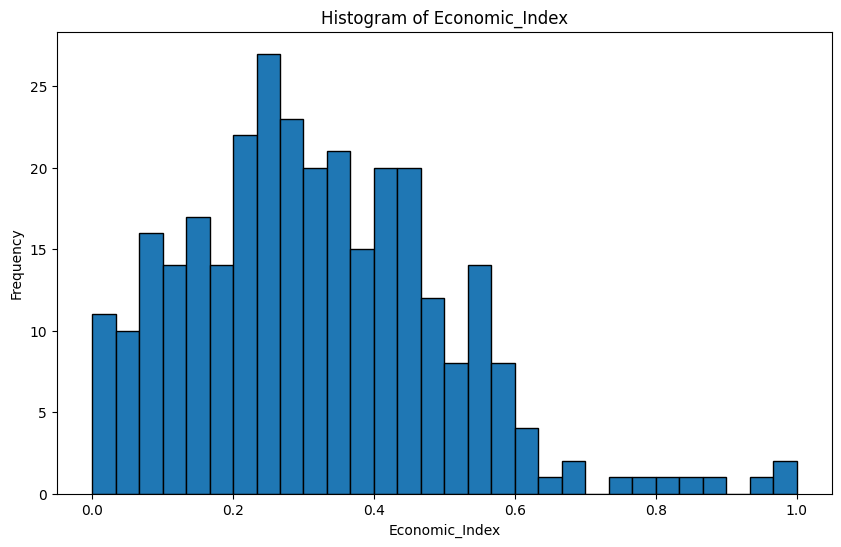

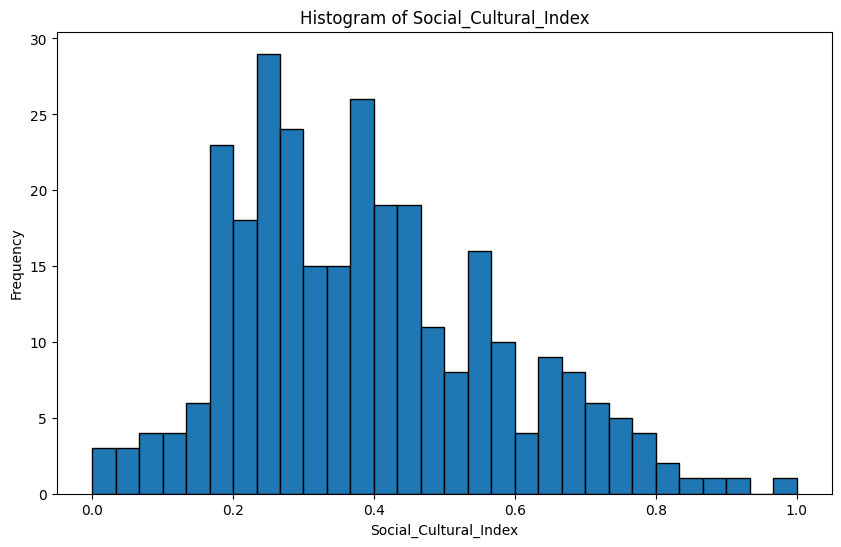

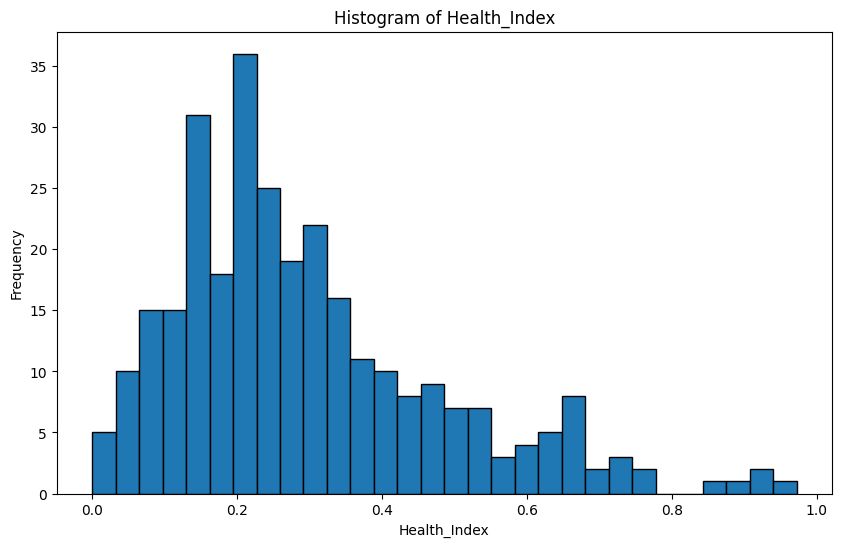

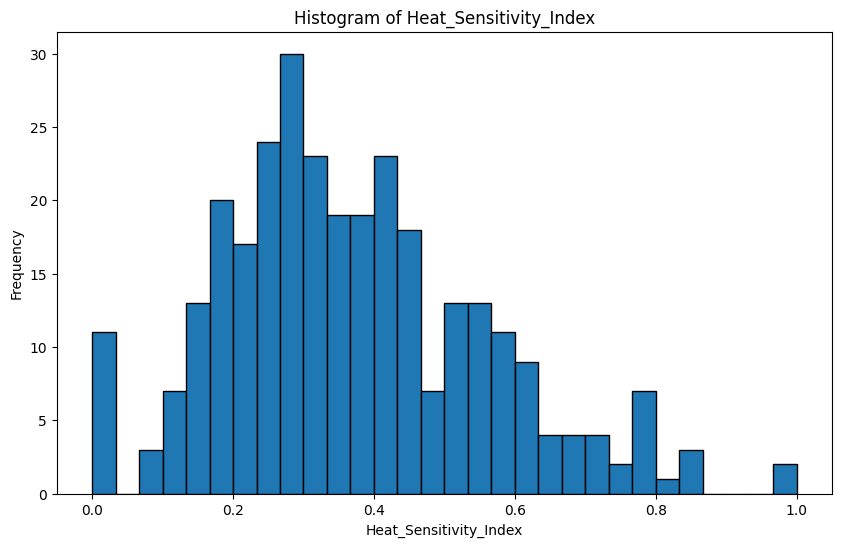

In [771]:
import matplotlib.pyplot as plt

# List of indices to plot
indices = ['Economic_Index', 'Social_Cultural_Index', 'Health_Index', 'Heat_Sensitivity_Index']

# Plotting histograms for each index
for index in indices:
    plt.figure(figsize=(10, 6))
    plt.hist(final_df_unique[index], bins=30, edgecolor='black')
    plt.title(f'Histogram of {index}')
    plt.xlabel(index)
    plt.ylabel('Frequency')
    plt.show()


In [772]:
import geopandas as gpd

# Merge final DataFrame with GeoDataFrame for shapefile output
gdf = gdf_US_CT  # Replace with the actual path to your shapefile
gdf_final = gdf.merge(final_df_unique, on='GEOID', how = 'inner')

In [773]:
import os
os.getcwd()

'C:\\Users\\rsingh\\OneDrive - PlanRVA\\Documents\\2_Projects\\Environmental_Analysis\\Heat Sensitivity Index\\Plots\\Final Files'

In [774]:
os.chdir(r"C:\Users\rsingh\OneDrive - PlanRVA\Documents\2_Projects\Environmental_Analysis\Heat Sensitivity Index\Plots\Final Files")

In [823]:
# Save to Excel
final_df_unique.to_excel('Heat_Sensitivity_Index.xlsx', index=False)

# Save to Shapefile
gdf_final.to_file('Heat_Sensitivity_Index.shp')

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\1534631051.py:5: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  gdf_final.to_file('Heat_Sensitivity_Index.shp')


In [776]:
gdf_final.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,Economic_Index,Social_Cultural_Index,Health_Index,Heat_Sensitivity_Index
0,51,085,320100,51085320100,3201,Census Tract 3201,G5020,S,328537534,2927606,+37.8856871,-077.5726776,"POLYGON ((-77.74029 37.87408, -77.73998 37.874...",0.238456,0.351171,0.162407,0.284946
1,51,085,321201,51085321201,3212.01,Census Tract 3212.01,G5020,S,11255521,16144,+37.5867060,-077.3295398,"POLYGON ((-77.36115 37.60754, -77.36084 37.607...",0.263398,0.275310,0.157531,0.263806
2,51,085,321202,51085321202,3212.02,Census Tract 3212.02,G5020,S,8887075,96758,+37.5858032,-077.3462287,"POLYGON ((-77.38286 37.59526, -77.38280 37.595...",0.442252,0.288278,0.228570,0.363404
3,51,085,320400,51085320400,3204,Census Tract 3204,G5020,S,58245255,348336,+37.7231726,-077.5209363,"POLYGON ((-77.61233 37.75986, -77.61216 37.760...",0.310036,0.290657,0.341903,0.357150
4,51,087,201002,51087201002,2010.02,Census Tract 2010.02,G5020,S,3022230,4272,+37.5725532,-077.4043263,"POLYGON ((-77.41507 37.56327, -77.41492 37.563...",0.448440,0.508998,0.348747,0.494915


In [777]:
gdf_final.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'GEOID', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry',
       'Economic_Index', 'Social_Cultural_Index', 'Health_Index',
       'Heat_Sensitivity_Index'],
      dtype='object')

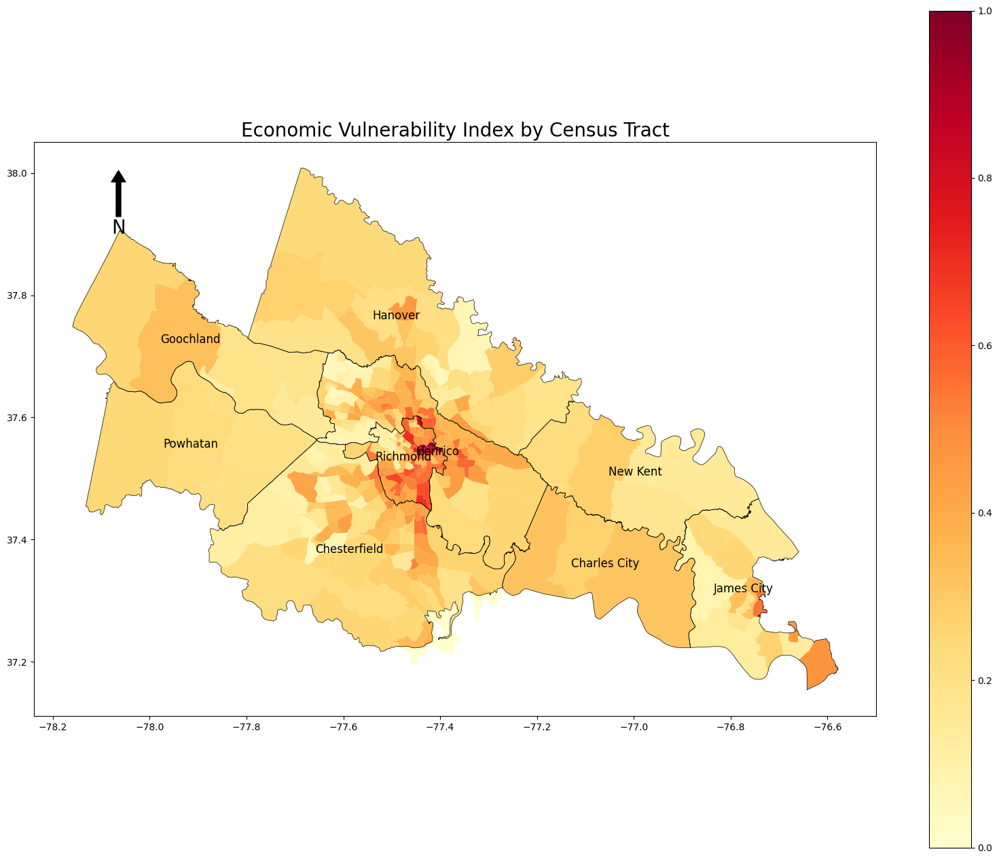

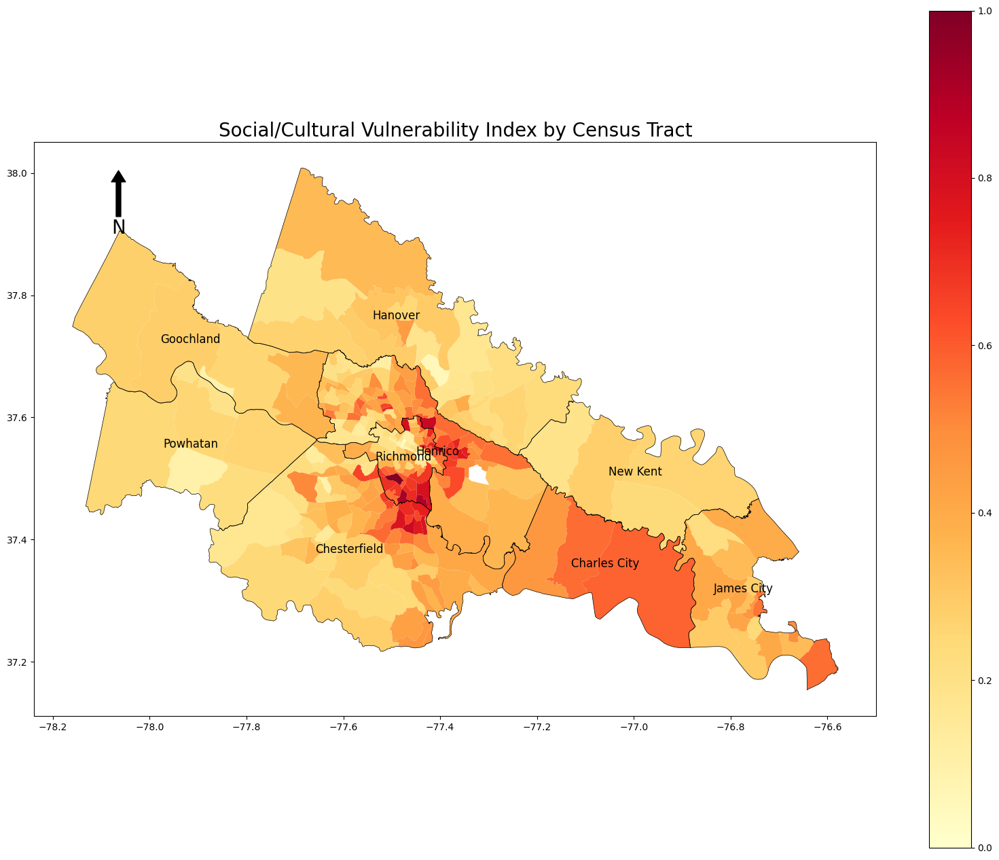

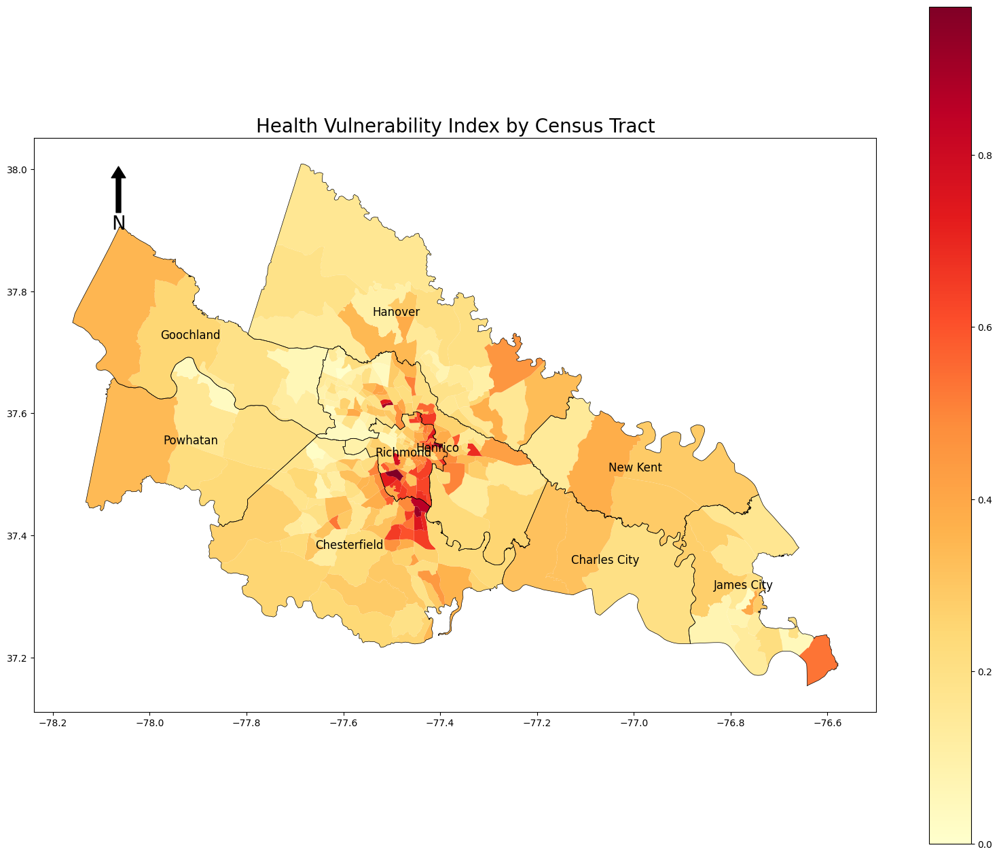

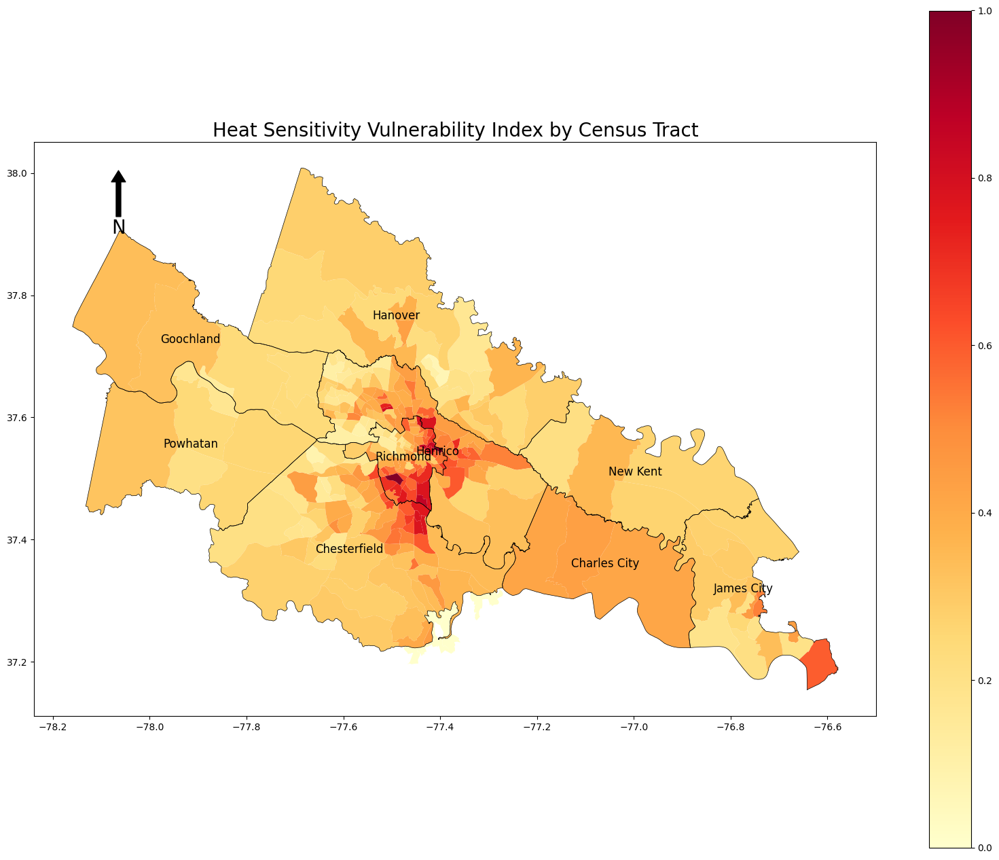

In [778]:
import matplotlib.pyplot as plt
import os
import geopandas as gpd

# Function to plot a map
def plot_map(gdf, column, title, map_name, gdf_boundaries, save_dir='.'):
    # Check and align CRS
    if gdf.crs != gdf_boundaries.crs:
        gdf_boundaries = gdf_boundaries.to_crs(gdf.crs)
    
    # Create the plot
    fig, ax = plt.subplots(figsize=(20, 16))
    
    # Plot the choropleth map
    gdf.plot(column=column, cmap='YlOrRd', ax=ax, legend=True)
    
    # Plot the county boundaries
    gdf_boundaries.plot(color='none', edgecolor='k', linewidth=0.5, ax=ax)  # Ensure 'color' is 'none' to make the counties transparent
    
    # Add Title and Labels
    ax.set_title(title, fontsize=20)
    
    # Add labels for counties
    for idx, row in gdf_boundaries.iterrows():
        ax.annotate(row['NAME'], xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                    horizontalalignment='center', fontsize=12, color='black')
    
    # Add North Arrow
    x, y, arrow_length = 0.1, 0.95, 0.1
    ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
                arrowprops=dict(facecolor='black', width=5, headwidth=15),
                ha='center', va='center', fontsize=20,
                xycoords=ax.transAxes)
    
    # Save the map
    save_path = os.path.join(save_dir, map_name)
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    plt.show()

# Plot the maps for each index
plot_map(gdf_final, 'Economic_Index', 'Economic Vulnerability Index by Census Tract', 'Economic_SVI.png', gdf_County_RVA)
plot_map(gdf_final, 'Social_Cultural_Index', 'Social/Cultural Vulnerability Index by Census Tract', 'Social_Cultural_Index.png', gdf_County_RVA)
plot_map(gdf_final, 'Health_Index', 'Health Vulnerability Index by Census Tract', 'Health_Index.png', gdf_County_RVA)
plot_map(gdf_final, 'Heat_Sensitivity_Index', 'Heat Sensitivity Vulnerability Index by Census Tract', 'Heat_Sensitivity_Index.png', gdf_County_RVA)


In [801]:
## Combining DFs to create comprehensive original variables df 'df_combined'

In [802]:
import pandas as pd

# Define a function to combine a list of DataFrames on 'GEOID'
def combine_dfs(dfs):
    combined_df = dfs[0]
    for df in dfs[1:]:
        combined_df = pd.merge(combined_df, df, on='GEOID', how='outer', suffixes=('', '_duplicate'))
    return combined_df

# Combine Economic DataFrames
economic_combined = combine_dfs(economic_dfs)

# Combine Social/Cultural DataFrames
social_cultural_combined = combine_dfs(social_cultural_dfs)

# Combine Health DataFrames
health_combined = combine_dfs(health_dfs)

# Display the combined DataFrames
print(economic_combined.head())
print(social_cultural_combined.head())
print(health_combined.head())


         GEOID   Perc_pov  Perc_BurdRU  Perc_BurdHousU  Perc_NoVeh  \
0  51085320602   8.841463     7.612457       13.425606    1.245675   
1  51085320602   8.841463     7.612457       13.425606    1.245675   
2  51085320602   8.841463     7.612457       13.425606    1.245675   
3  51085320601  19.146504    27.843685        5.792045    7.117934   
4  51085320601  19.146504    27.843685        5.792045    7.117934   

   Perc_Crowd  HL_rating  En_Burden  
0    0.276817        2.0        1.0  
1    0.276817        2.0        1.0  
2    0.276817        2.0        1.0  
3    4.396371        2.0        1.0  
4    4.396371        2.0        1.0  
         GEOID  Perc_NoDis  Perc_Over65  Perc_Under5  Perc_NoEng   Perc_UnS
0  51085320602   11.382114    24.457995     5.657182    5.826558  36.212737
1  51085320601   10.382930    11.830825     4.210326    3.105353  30.843970
2  51036600100   16.642175    22.520206     5.216752    0.771492  43.681117
3  51036600200   19.039596    27.169334     3.2

In [803]:
len(economic_combined)


473

In [804]:
len(social_cultural_combined)


296

In [805]:
len(health_combined)

13747122

In [806]:
import pandas as pd

# Assuming gdf_final is your dataframe
# Group by 'GEOID' and take the mean of each group
health_combined = health_combined.groupby('GEOID').mean().reset_index()

# Display the first few rows of the new dataframe
print(health_combined.head())

         GEOID  Perc_NoIns  Perc_Preg12  Data_Value  Data_Value_duplicate  \
0  51036600100    7.090375     0.771492   11.100000                16.000   
1  51036600200    6.444819     0.758214   11.300000                17.200   
2  51036600300    4.867788     0.000000   10.800000                16.200   
3  51041100106    8.699039     0.389509    9.133333                10.600   
4  51041100107   12.106730     1.991239   11.100000                11.525   

   Data_Value_duplicate  Data_Value_duplicate  Data_Value_duplicate  \
0             44.000000                  6.70                41.800   
1             45.100000                  6.70                42.400   
2             45.300000                  7.00                40.800   
3             36.033333                  7.90                30.600   
4             35.250000                  4.85                39.075   

   Data_Value_duplicate  Data_Value_duplicate  Data_Value_duplicate  \
0              7.500000              4.

In [807]:
# Merge all combined DataFrames into one final DataFrame
df_combined = pd.merge(economic_combined, social_cultural_combined, on='GEOID', how='outer')
df_combined = pd.merge(df_combined, health_combined, on='GEOID', how='outer')

# Display the final combined DataFrame
print(df_combined.head())


         GEOID   Perc_pov  Perc_BurdRU  Perc_BurdHousU  Perc_NoVeh  \
0  51085320602   8.841463     7.612457       13.425606    1.245675   
1  51085320602   8.841463     7.612457       13.425606    1.245675   
2  51085320602   8.841463     7.612457       13.425606    1.245675   
3  51085320601  19.146504    27.843685        5.792045    7.117934   
4  51085320601  19.146504    27.843685        5.792045    7.117934   

   Perc_Crowd  HL_rating  En_Burden  Perc_NoDis  Perc_Over65  ...  \
0    0.276817        2.0        1.0   11.382114    24.457995  ...   
1    0.276817        2.0        1.0   11.382114    24.457995  ...   
2    0.276817        2.0        1.0   11.382114    24.457995  ...   
3    4.396371        2.0        1.0   10.382930    11.830825  ...   
4    4.396371        2.0        1.0   10.382930    11.830825  ...   

   Perc_Preg12  Data_Value  Data_Value_duplicate  Data_Value_duplicate  \
0     1.422764    9.033333                  10.5                 36.30   
1     1.422764  

In [808]:
df_combined.columns

Index(['GEOID', 'Perc_pov', 'Perc_BurdRU', 'Perc_BurdHousU', 'Perc_NoVeh',
       'Perc_Crowd', 'HL_rating', 'En_Burden', 'Perc_NoDis', 'Perc_Over65',
       'Perc_Under5', 'Perc_NoEng', 'Perc_UnS', 'Perc_NoIns', 'Perc_Preg12',
       'Data_Value', 'Data_Value_duplicate', 'Data_Value_duplicate',
       'Data_Value_duplicate', 'Data_Value_duplicate', 'Data_Value_duplicate',
       'Data_Value_duplicate', 'Data_Value_duplicate', 'Data_Value_duplicate'],
      dtype='object')

In [809]:
os.getcwd()

'C:\\Users\\rsingh\\OneDrive - PlanRVA\\Documents\\2_Projects\\Environmental_Analysis\\Heat Sensitivity Index\\Plots\\Final Files'

In [810]:

len(df_combined)

473

In [811]:
df_combined.columns# Rename the columns
df_combined.columns = [
    'GEOID', 'Perc_pov', 'Perc_BurdRU', 'Perc_BurdHousU', 'Perc_NoVeh',
    'Perc_Crowd', 'HL_rating', 'En_Burden', 'Perc_NoDis', 'Perc_Over65',
    'Perc_Under5', 'Perc_NoEng', 'Perc_UnS', 'Perc_NoIns', 'Perc_Preg12',
    'Asthma', 'Diabetes', 'High_BP', 'Cancer', 'Obesity',
    'Heart', 'Stroke', 'MH', 'COPD'
]

# Display the renamed DataFrame
print(df_combined.head())


         GEOID   Perc_pov  Perc_BurdRU  Perc_BurdHousU  Perc_NoVeh  \
0  51085320602   8.841463     7.612457       13.425606    1.245675   
1  51085320602   8.841463     7.612457       13.425606    1.245675   
2  51085320602   8.841463     7.612457       13.425606    1.245675   
3  51085320601  19.146504    27.843685        5.792045    7.117934   
4  51085320601  19.146504    27.843685        5.792045    7.117934   

   Perc_Crowd  HL_rating  En_Burden  Perc_NoDis  Perc_Over65  ...  \
0    0.276817        2.0        1.0   11.382114    24.457995  ...   
1    0.276817        2.0        1.0   11.382114    24.457995  ...   
2    0.276817        2.0        1.0   11.382114    24.457995  ...   
3    4.396371        2.0        1.0   10.382930    11.830825  ...   
4    4.396371        2.0        1.0   10.382930    11.830825  ...   

   Perc_Preg12     Asthma  Diabetes  High_BP    Cancer    Obesity     Heart  \
0     1.422764   9.033333      10.5    36.30  7.366667  36.733333  6.033333   
1     

In [812]:
# Save to Excel
df_combined.to_excel('Heat_Sensitivity_Index_ORIG.xlsx', index=False)

# Display the updated DataFrame with the new index
print(df_combined.head())

         GEOID   Perc_pov  Perc_BurdRU  Perc_BurdHousU  Perc_NoVeh  \
0  51085320602   8.841463     7.612457       13.425606    1.245675   
1  51085320602   8.841463     7.612457       13.425606    1.245675   
2  51085320602   8.841463     7.612457       13.425606    1.245675   
3  51085320601  19.146504    27.843685        5.792045    7.117934   
4  51085320601  19.146504    27.843685        5.792045    7.117934   

   Perc_Crowd  HL_rating  En_Burden  Perc_NoDis  Perc_Over65  ...  \
0    0.276817        2.0        1.0   11.382114    24.457995  ...   
1    0.276817        2.0        1.0   11.382114    24.457995  ...   
2    0.276817        2.0        1.0   11.382114    24.457995  ...   
3    4.396371        2.0        1.0   10.382930    11.830825  ...   
4    4.396371        2.0        1.0   10.382930    11.830825  ...   

   Perc_Preg12     Asthma  Diabetes  High_BP    Cancer    Obesity     Heart  \
0     1.422764   9.033333      10.5    36.30  7.366667  36.733333  6.033333   
1     

In [813]:
df_combined.shape

(473, 24)

In [814]:
# Group by 'GEOID' and take the mean of each group
df_combined = df_combined.groupby('GEOID').mean().reset_index()

In [815]:
df_combined.shape

(307, 24)

In [816]:
df_hsvi_overall = pd.merge(df_combined,final_df_unique, on ="GEOID", how = "inner")

In [817]:
df_hsvi_overall.shape

(307, 28)

In [818]:
df_hsvi_overall.columns

Index(['GEOID', 'Perc_pov', 'Perc_BurdRU', 'Perc_BurdHousU', 'Perc_NoVeh',
       'Perc_Crowd', 'HL_rating', 'En_Burden', 'Perc_NoDis', 'Perc_Over65',
       'Perc_Under5', 'Perc_NoEng', 'Perc_UnS', 'Perc_NoIns', 'Perc_Preg12',
       'Asthma', 'Diabetes', 'High_BP', 'Cancer', 'Obesity', 'Heart', 'Stroke',
       'MH', 'COPD', 'Economic_Index', 'Social_Cultural_Index', 'Health_Index',
       'Heat_Sensitivity_Index'],
      dtype='object')

In [819]:
# Save to Excel
df_hsvi_overall.to_excel('Heat_Sensitivity_Index_FINALFILE.xlsx', index=False)

# Display the updated DataFrame with the new index
print(df_hsvi_overall.head())

         GEOID   Perc_pov  Perc_BurdRU  Perc_BurdHousU  Perc_NoVeh  \
0  51036600100  20.609846     6.015693       18.047079    7.497820   
1  51036600200  15.880371     3.232323       14.646465    6.363636   
2  51036600300  23.076923     7.552083       14.062500    4.817708   
3  51041100106   4.881849     0.000000       13.159747    0.562984   
4  51041100107  40.581442    47.838086        9.383625    2.299908   

   Perc_Crowd  HL_rating  En_Burden  Perc_NoDis  Perc_Over65  ...  Cancer  \
0    0.871840        1.0   1.000000   16.642175    22.520206  ...    6.70   
1    0.202020        1.0   1.000000   19.039596    27.169334  ...    6.70   
2    1.432292        1.0   1.000000   23.377404    28.425481  ...    7.00   
3    0.000000        1.0   0.333333    8.049857    15.684238  ...    7.90   
4    5.427783        1.0   1.000000   14.257268     7.885305  ...    4.85   

   Obesity     Heart    Stroke         MH      COPD  Economic_Index  \
0   41.800  7.500000  4.500000  15.000000  8.

In [820]:
len(df_hsvi_overall)

307

In [821]:
gdf_hsvi_overall = pd.merge(gdf_US_CT, df_hsvi_overall, on = 'GEOID', how = 'inner')

In [822]:
# Save to Shapefile
gdf_hsvi_overall.to_file('Heat_Sensitivity_Index_OVERALL.shp')

C:\Users\rsingh\AppData\Local\Temp\ipykernel_24884\614432785.py:2: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  gdf_hsvi_overall.to_file('Heat_Sensitivity_Index_OVERALL.shp')
